In [3]:
import os 
import subprocess
from concurrent.futures import ThreadPoolExecutor
from astropy.timeseries import LombScargle

In [4]:
def list_files_in_directory(directory, extension):
    """List files in a directory with a specific extension."""
    return [file for file in os.listdir(directory) if file.endswith(extension)]

def convert_raw_to_csv(raw_file, csv_directory):
    """Convert a RAW file to CSV format using the metavision_raw_to_csv.py script."""
    command = f"metavision_file_to_csv_parallel.exe -i {raw_file} -o {csv_directory}"
    subprocess.run(command, shell=True)

In [3]:
data_directory = 'data'  # Directory with RAW files
csv_directory = 'csv_data'  # Directory where CSV files should be stored

raw_files = list_files_in_directory(data_directory, '.raw')
csv_files = list_files_in_directory(csv_directory, '.csv')

# Convert RAW filenames to expected CSV filenames
expected_csv_files = [f"{os.path.splitext(raw_file)[0]}.csv" for raw_file in raw_files]

# Find RAW files that haven't been converted to CSV
unconverted_files = [raw for raw, expected_csv in zip(raw_files, expected_csv_files) if expected_csv not in csv_files]

# Using ThreadPoolExecutor to parallelize conversion
with ThreadPoolExecutor(max_workers=4) as executor:  # Adjust max_workers as needed
    futures = []
    for raw_file in unconverted_files:
        full_raw_path = os.path.join(data_directory, raw_file)
        full_output_path = os.path.join(csv_directory, os.path.splitext(raw_file)[0]+'.csv')
        print(f"Scheduling conversion for {full_raw_path}...")
        futures.append(executor.submit(convert_raw_to_csv, full_raw_path, full_output_path))

    # Waiting for all futures to complete (optional)
    for future in futures:
        future.result() 

Scheduling conversion for data\10101010_240315_195125.raw...


KeyboardInterrupt: 

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
def read_and_prepocess(path):
    data = pd.read_csv(path, header = None, names = ['x', 'y', 'p', 't'])
    data['t'] = data['t'] - data['t'].min()
    data['t'] = data['t']/1000000
    return data

def find_most_frequent_pairs(data):
    counts = data.groupby(['x','y']).size().reset_index(name='counts')
    most_common_pair = counts.sort_values('counts', ascending=False)
    return most_common_pair

def pixel_stats_most_common(data,position,most_common_pair):
    df_pixel = data[(data['x']==most_common_pair.iloc[position]['x']) & (data['y']==most_common_pair.iloc[position]['y'])].sort_values('t')
    return df_pixel

def pixel_specific(data,x,y):
    df_pixel = data[(data['x']==x) & (data['y']==y)].sort_values('t')
    return df_pixel

def plot_pixel_value(ax, data, samples, step):
    data[0:samples].plot(ax = ax, x = 't', y = 'p', kind = 'line', marker = '*',  figsize = (25,15), xticks = np.arange(data[0:samples]['t'].min(), data[0:samples]['t'].max(), step))
    ax.set_xticklabels(ax.get_xticks(), rotation=90)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pixel Value')

In [7]:
%matplotlib widget
# Ensure you have ipympl installed for interactive matplotlib in Jupyter through VSCode
# You might need to restart VSCode or the Jupyter kernel after installation for changes to take effect
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.widgets import RectangleSelector
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle
from scipy.signal import find_peaks
from ipywidgets import widgets
from IPython.display import display
class ImageSelectorWidget:
    fig = None
    ax = None
    def __init__(self, folder_path, df, high_freq_pt = None, low_freq=None, high_freq=None):
        self.folder_path = folder_path
        self.images = [img for img in os.listdir(folder_path) if img.endswith('.jpg')]
        if not self.images:
            raise ValueError("No images found in the folder.")
        self.current_image_index = 0
        self.image = None
        self.df = df
        self.high_freq_pt = high_freq_pt
        self.low_freq = low_freq
        self.high_freq = high_freq
        # Initialize the figure and axes here and reuse them
        # Ensure figure and axes are initialized only once
        if ImageSelectorWidget.fig is None or not plt.fignum_exists(ImageSelectorWidget.fig.number):
            ImageSelectorWidget.fig, ImageSelectorWidget.ax = plt.subplots()
        else:
            ImageSelectorWidget.ax.clear()
        # self.fig, self.ax = plt.subplots()
        self.selector = None
        self.load_image()
        self.fig.canvas.mpl_connect('key_press_event', self.on_key)
    
    def load_image(self):
        img_path = os.path.join(self.folder_path, self.images[self.current_image_index])
        self.image = plt.imread(img_path)
        self.update_image()

    def update_image(self):
        if self.selector:
            # Disconnect and remove the existing selector to prevent it from interfering with new images
            self.selector.disconnect_events()
            self.selector = None
        self.ax.clear()  # Clear the axes to prepare for a new image
        self.ax.imshow(self.image)  # Display the new image
        if self.high_freq_pt is not None:
            # Plot the point of interest on the image
            self.ax.plot(self.high_freq_pt[0], self.high_freq_pt[1], 'ro', label='High freq point')  # 'ro' = red circle
            self.ax.legend()  # Show the legend
        # Create a new RectangleSelector for the new image
        self.selector = RectangleSelector(self.ax, self.on_select, useblit=True,
                                          button=[1],  # Only left mouse button
                                          minspanx=5, minspany=5,
                                          spancoords='pixels', interactive=True)
        self.fig.canvas.draw_idle()  # Update the figure canvas

    def on_select(self, eclick, erelease):
        x1, y1 = int(eclick.xdata), int(eclick.ydata)
        x2, y2 = int(erelease.xdata), int(erelease.ydata)
        # filter df for rows where x and y fall within the selected region
        filtered_df = self.df[(self.df['x'] >= min(x1, x2)) & (self.df['x'] <= max(x1, x2)) & (self.df['y'] >= min(y1, y2)) & (self.df['y'] <= max(y1, y2))]

        if not filtered_df.empty:
            # compute the median x and y
            median_x = filtered_df['x'].median()
            median_y = filtered_df['y'].median()

            print(median_x, median_y)

            # Calculate the distance to the median point for each row in the filtered DataFrame
            filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)

            # Sort by 'distance_to_median' and take the first row (the closest point)
            closest = filtered_df.nsmallest(1, 'distance_to_median')

            # Extract the closest point's x and y values
            median_x_closest = closest['x'].values[0]
            median_y_closest = closest['y'].values[0]


            # Now filter the original df to get all rows corresponding to the closest pixel
            df_pixel = self.df[(self.df['x'] == median_x_closest) & (self.df['y'] == median_y_closest)].sort_values('t')
            fig, (ax1, ax2) = plt.subplots(2, 1)
            plot_pixel_value(ax1, df_pixel, 100, 100)
            # # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
            # # Normalize the timestamps to zero
            # timestamps = timestamps - timestamps[0]

            # # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
            # t_seconds = timestamps * 1e-6

            # Define the frequency array as you wish, for example:
            #frequencies = np.linspace(self.low_freq, self.high_freq, 10000)  # frequencies from 0.01 Hz to 1000 Hz

            # Calculate Lomb-Scargle periodogram (power spectral density)
            if self.low_freq is not None and self.high_freq is not None:
                frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=self.low_freq, maximum_frequency=self.high_freq)
            else:
                frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower()
            power_db = 10 * np.log10(power)
            # Plot the Lomb-Scargle periodogram
            ax2.plot(frequencies, power_db)
            #plt.title('Lomb-Scargle Periodogram')
            ax2.set_xlabel('Frequency (Hz)')
            ax2.set_ylabel('Power in dB')
            plt.tight_layout()
            if not os.path.exists('figures'):
                os.makedirs('figures')
            folder_save_name = self.folder_path.split('\\')[-1]
            print('Enter Bright or Noise? (B/N) (Enter to submit)')
            text = widgets.Text()
            display(text)

            def handle_submit(sender):
                name = text.value
                plt.savefig(f'figures/{folder_save_name}_{name}.png')
            text.on_submit(handle_submit)
            plt.show()
            # Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
            peaks, _ = find_peaks(power_db)

            # Get the peak frequencies and their corresponding power values
            peak_frequencies = frequencies[peaks]
            peak_powers = power_db[peaks]

            # Sort the peaks by power in descending order
            sorted_indices = np.argsort(peak_powers)[::-1]
            sorted_peak_frequencies = peak_frequencies[sorted_indices]
            sorted_peak_powers = peak_powers[sorted_indices]



            # Print the 5 most powerful sorted peak frequencies and powers
            for i in range(len(sorted_peak_frequencies[:5])):
                print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
            
        else:
            print("No data found in the selected region.")

        # Process selection here (e.g., access pixel values)
        # Access the selected region using: self.image[y1:y2, x1:x2]

    def on_key(self, event):
        if event.key == 'right':
            self.current_image_index = (self.current_image_index + 1) % len(self.images)
            self.load_image()
        elif event.key == 'left':
            self.current_image_index = (self.current_image_index - 1) % len(self.images)
            self.load_image()



def select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, high_freq_pt, low_freq=20, high_freq=2000):
    # Extract the base name without extension
    base_name = os.path.splitext(csv_file_name)[0]
    
    # Construct the path to the subfolder
    subfolder_path = os.path.join(video_export_folder, base_name)
    
    if not os.path.exists(subfolder_path):
        print(f"No subfolder found for {csv_file_name}")
        return None
    
    # Initialize ImageSelector with the subfolder path
    print(f"Folder for selection: {subfolder_path}")
    selector = ImageSelectorWidget(subfolder_path, df, high_freq_pt, low_freq, high_freq)


## Dark Scenarios - 60Hz

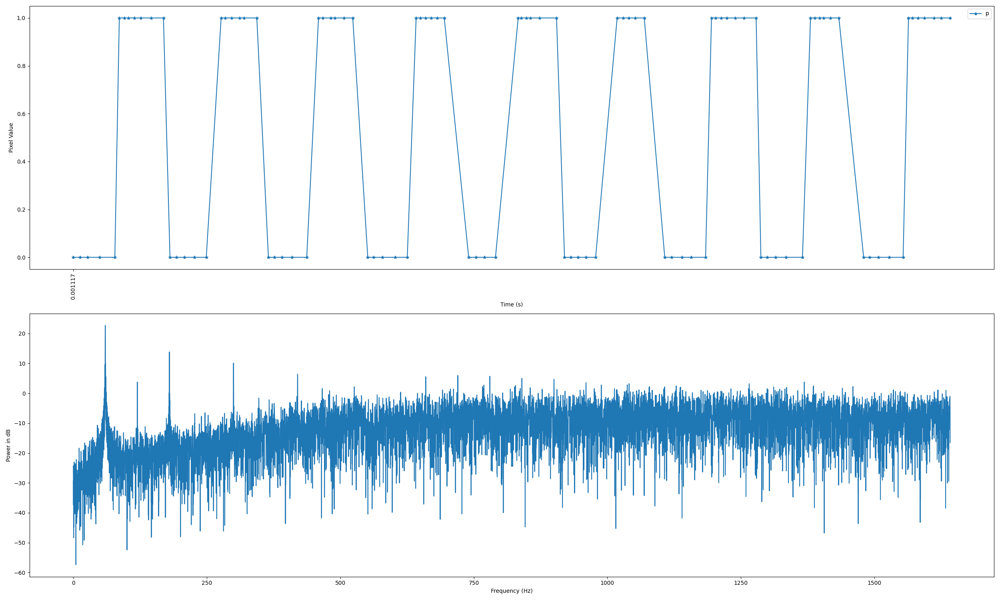

Frequency: 60.02979450161449 Hz, Power: 22.711598786119623
Frequency: 180.01467311965166 Hz, Power: 13.829109379527143
Frequency: 299.9995517376888 Hz, Power: 10.089481176535976
Frequency: 60.55276719795712 Hz, Power: 10.01161283954376
Frequency: 59.432111420080055 Hz, Power: 9.615670133774625
Folder for selection: video_export\1m_dark_new_60hz


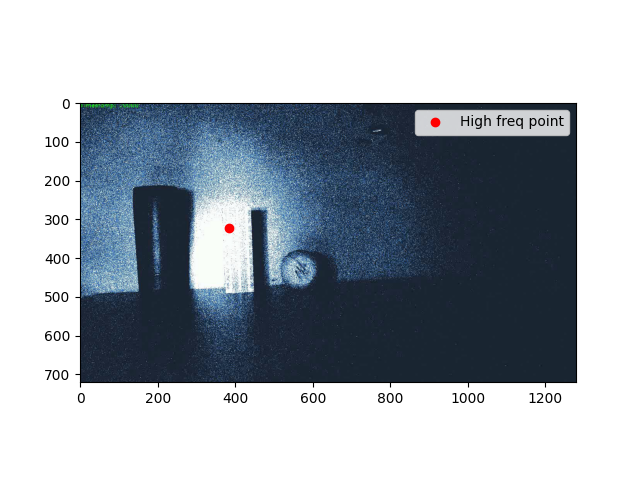

In [11]:
import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
from scipy.fftpack import fft, ifft
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_dark_new_60hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
# frequencies = np.linspace(20, 100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower()
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/1m_dark_new_60hz.png')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = '1m_dark_new_60hz.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

#### The lomb-scargle works better and our data looks good. 

## Dark 100Hz

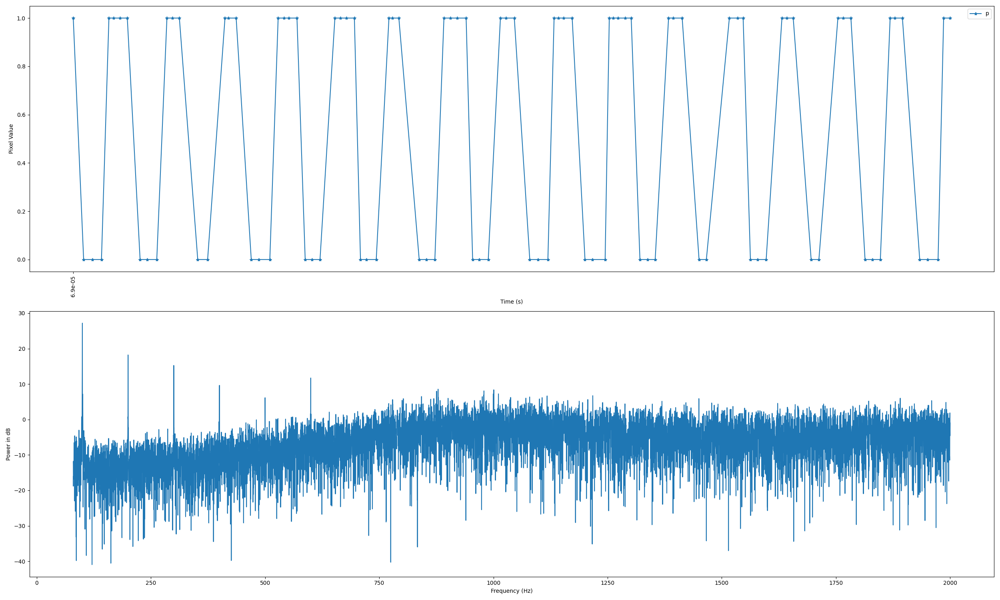

Frequency: 99.96999699969997 Hz, Power: 27.179474197001262
Frequency: 200.01200120012 Hz, Power: 18.20912837554479
Frequency: 300.05400540054006 Hz, Power: 15.2463382199637
Frequency: 599.98799879988 Hz, Power: 11.710394909741677
Frequency: 400.0960096009601 Hz, Power: 9.63083189319991
Folder for selection: video_export\1m_dark_new_100hz


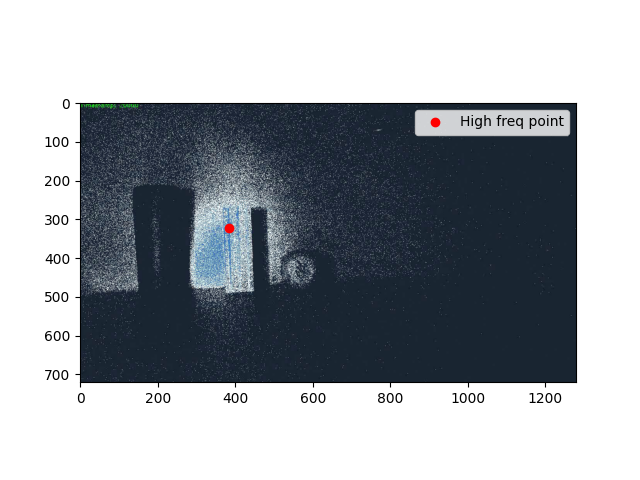

337.0 377.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_19368\2162118700.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

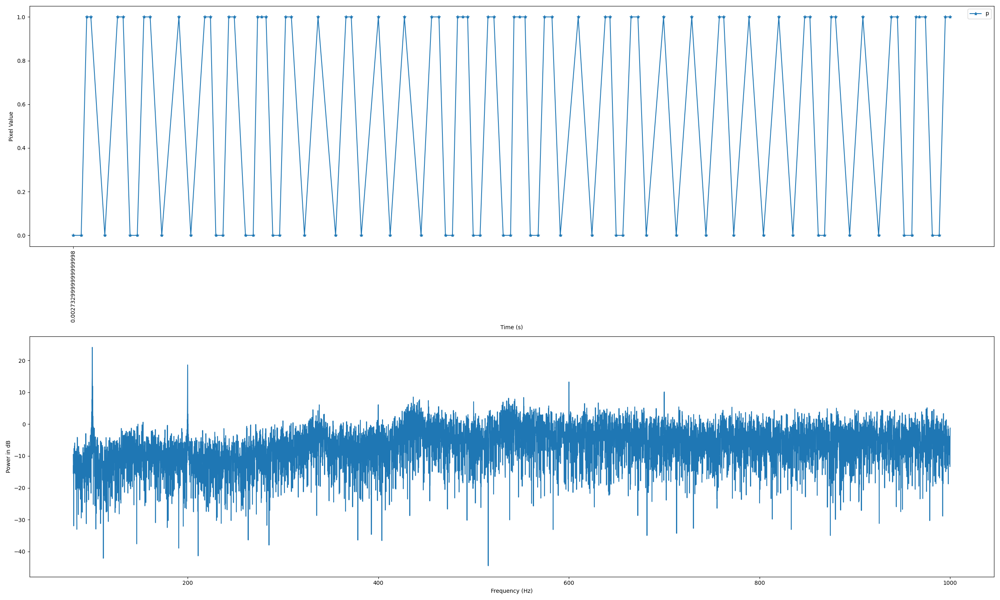

Frequency: 99.96599659965997 Hz, Power: 24.154068473527474
Frequency: 199.9799979998 Hz, Power: 18.629425605290475
Frequency: 600.0360036003601 Hz, Power: 13.269810000091077
Frequency: 100.24202420242024 Hz, Power: 11.973575155802035
Frequency: 700.0500050005 Hz, Power: 10.140154536188374


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import fft, ifft
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_dark_new_100hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(80, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz
# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_dark_new_100hz.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

csv_file_name = '1m_dark_new_100hz.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 80, 1000)

## dark 1k

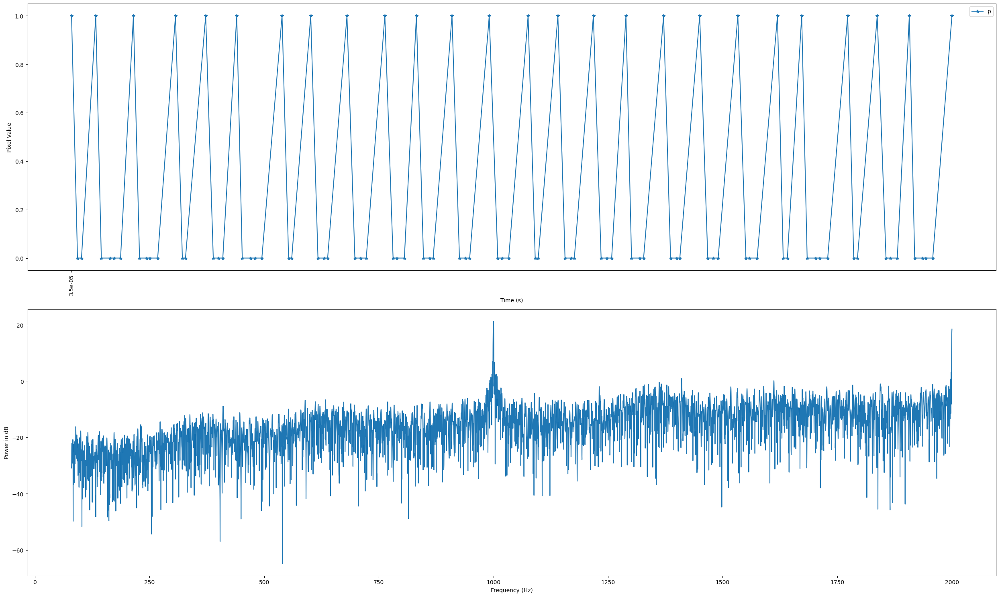

Frequency: 999.9639963996399 Hz, Power: 21.288621487066454
Frequency: 998.4278427842784 Hz, Power: 6.959748125445772
Frequency: 1001.6921692169217 Hz, Power: 6.718092400756577
Frequency: 1998.2718271827182 Hz, Power: 3.136302463911097
Frequency: 1006.6846684668466 Hz, Power: 2.4610139163937577


In [11]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_dark_new_1k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(80, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_dark_new_1k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")


## dark 2.5k

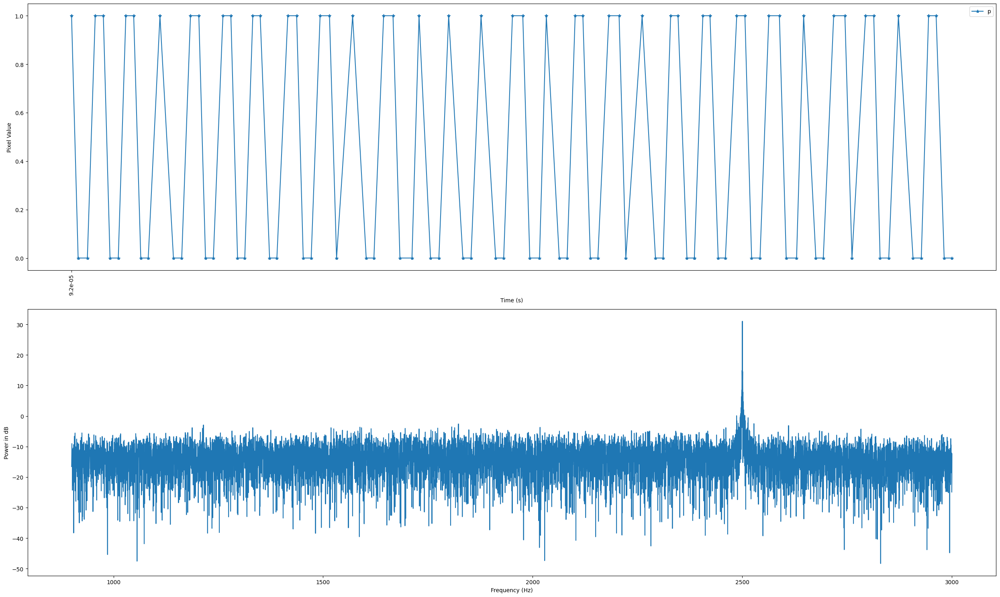

Frequency: 2500.1500150015 Hz, Power: 31.062975147773088
Frequency: 2499.3099309930994 Hz, Power: 14.950045611844926
Frequency: 2500.7800780078005 Hz, Power: 14.57127459308808
Frequency: 2498.679867986799 Hz, Power: 8.507051469764951
Frequency: 2501.620162016202 Hz, Power: 7.79363850127856


In [12]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_dark_no_diff_2_5k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 3000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_dark_new_2_5k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## dark 5k

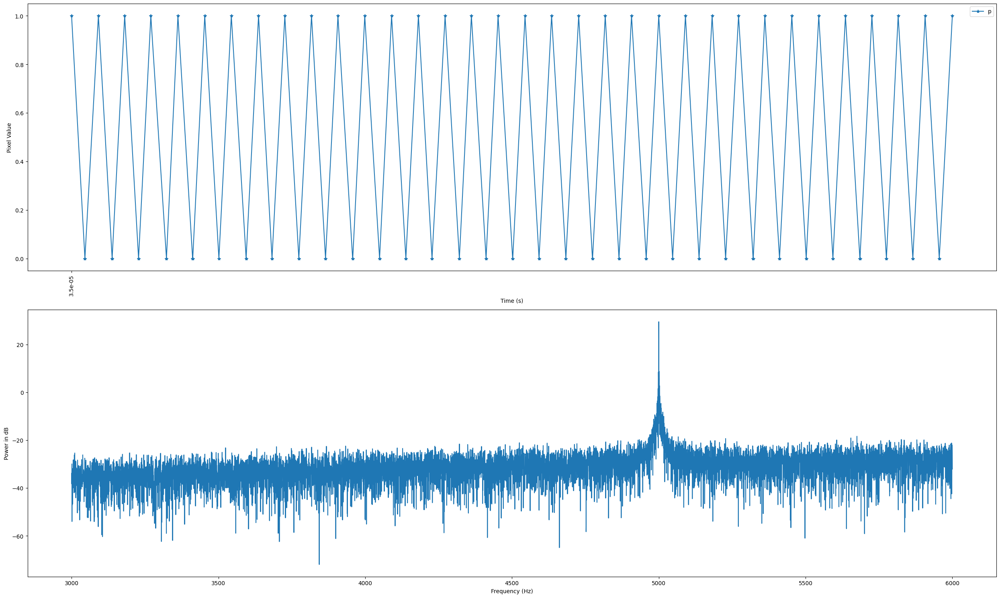

Frequency: 5000.0 Hz, Power: 29.481977454092934
Frequency: 5000.900090009001 Hz, Power: 8.85428681704763
Frequency: 4998.799879987999 Hz, Power: 8.419252611592952
Frequency: 5002.400240024002 Hz, Power: 2.788356619593837
Frequency: 4997.599759975998 Hz, Power: 1.520761178461181


In [13]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_dark_no_diff_5k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(3000, 6000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_dark_new_5k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")


## ambient 60hz

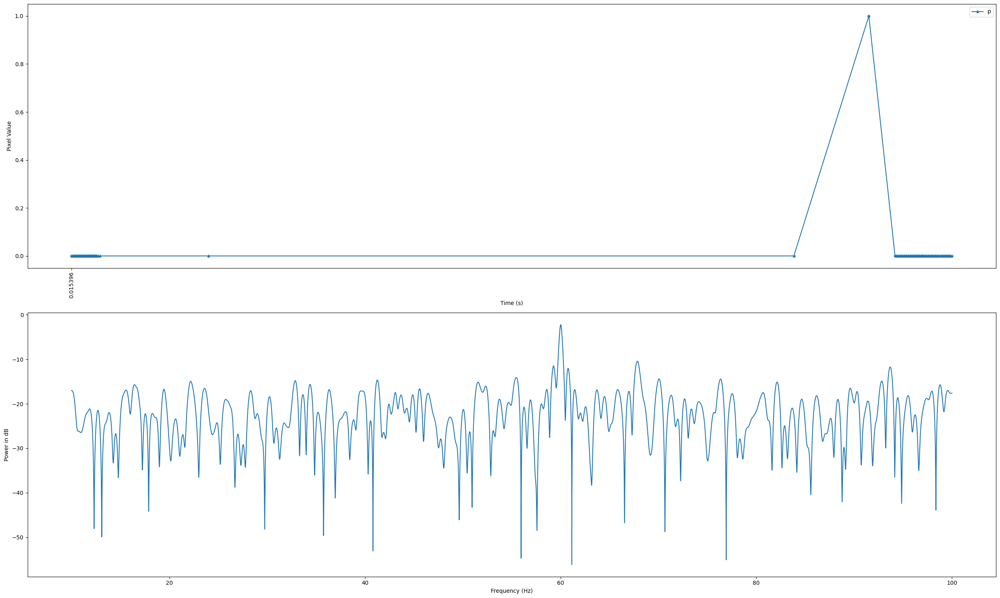

Frequency: 60.0 Hz, Power: -2.218798614588611
Frequency: 67.83978397839783 Hz, Power: -10.442059791994641
Frequency: 59.27092709270927 Hz, Power: -11.477803410277689
Frequency: 93.68136813681369 Hz, Power: -11.731617943442059
Frequency: 60.75607560756076 Hz, Power: -12.041418539240404


In [6]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_ambient_new_60hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_ambient_new_60hz.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# Ambient 120Hz

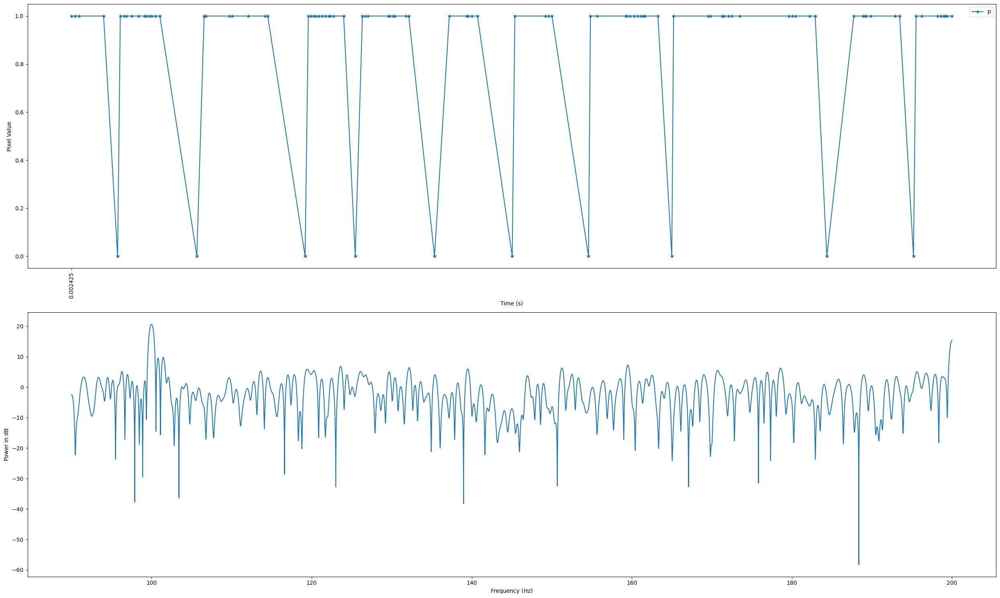

Frequency: 99.97799779977998 Hz, Power: 20.60863368140732
Frequency: 101.45214521452145 Hz, Power: 9.810912068913611
Frequency: 100.8030803080308 Hz, Power: 9.533160575494428
Frequency: 159.5049504950495 Hz, Power: 7.290783502583036
Frequency: 123.63036303630363 Hz, Power: 6.8496339742769905


In [9]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_ambient_new_100hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90, 200, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_ambient_new_120hz.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 1k

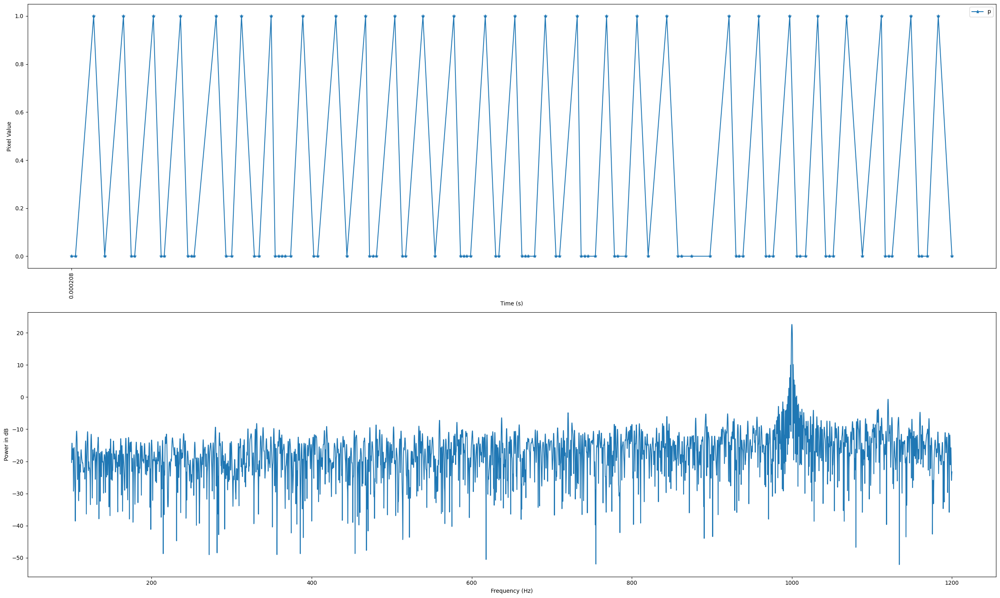

Frequency: 1000.0 Hz, Power: 22.600560130990587
Frequency: 1001.5401540154015 Hz, Power: 10.153048297269882
Frequency: 998.4598459845985 Hz, Power: 9.96826068361849
Frequency: 997.3597359735974 Hz, Power: 6.054059291228134
Frequency: 1002.6402640264026 Hz, Power: 5.32798774327331


In [10]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_ambient_new_1k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(100, 1200, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_ambient_new_1k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# Ambient 2.5K

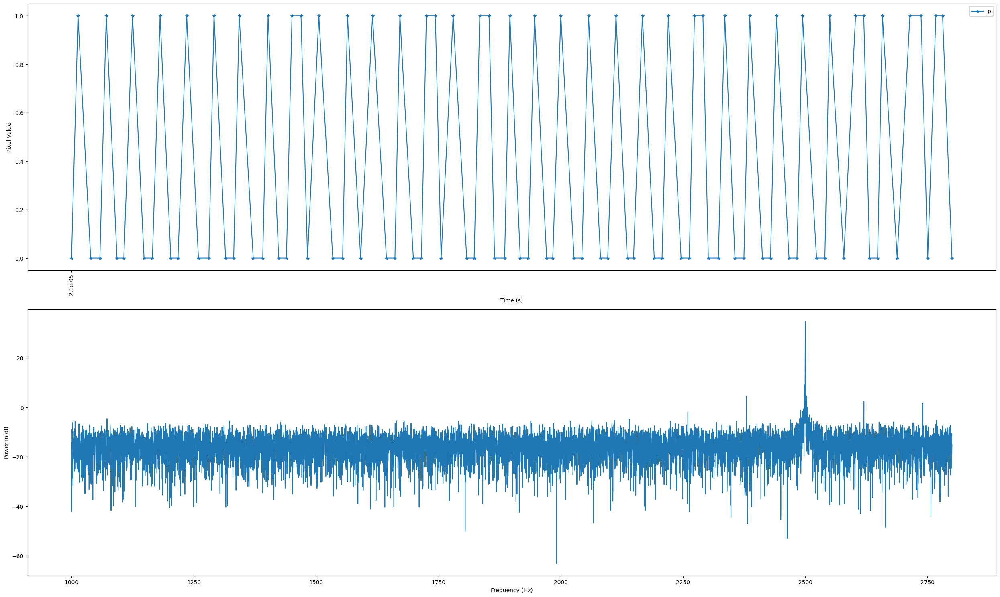

Frequency: 2500.0900090009 Hz, Power: 34.907554249027605
Frequency: 2498.649864986499 Hz, Power: 9.221589185068694
Frequency: 2502.2502250225025 Hz, Power: 4.60824872481551
Frequency: 2380.01800180018 Hz, Power: 4.5906067154519565
Frequency: 2502.7902790279027 Hz, Power: 3.8399712435325526


In [16]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_ambient_no_diff_2_5k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 2800, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_ambient_new_2_5k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# Ambient 5K

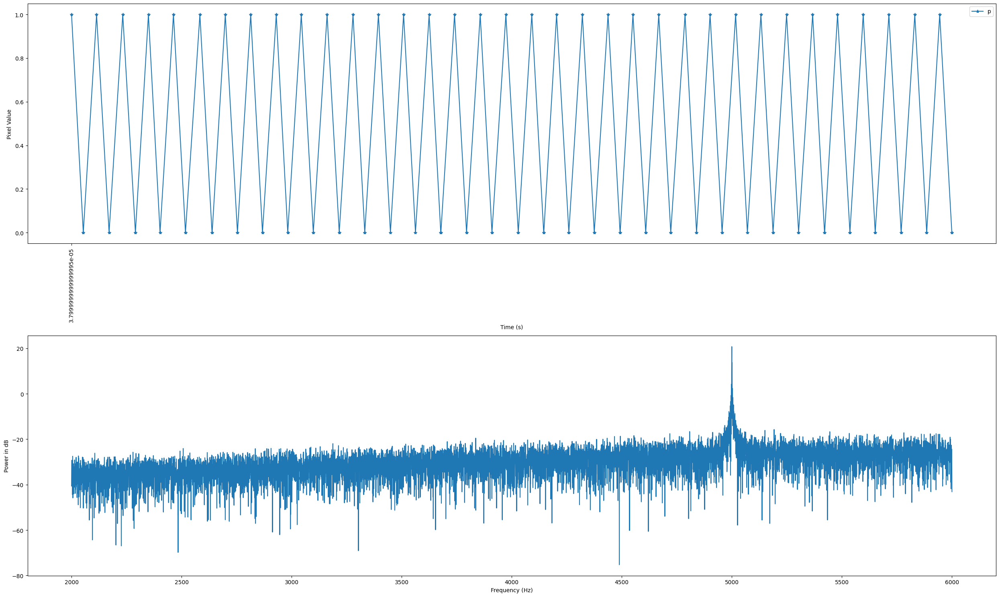

Frequency: 4999.899989998999 Hz, Power: 20.752358738586416
Frequency: 5000.700070007 Hz, Power: 13.735849688387248
Frequency: 4997.899789978997 Hz, Power: 4.197232869364145
Frequency: 5002.700270027002 Hz, Power: 2.371415701966116
Frequency: 4996.299629962996 Hz, Power: -0.7070776524592683


In [18]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1m_ambient_no_diff_5k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(3.5, 6))
plot_pixel_value(ax1, df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(2000, 6000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
plt.savefig('figures/1m_ambient_new_5k.png')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Direct 100Khz

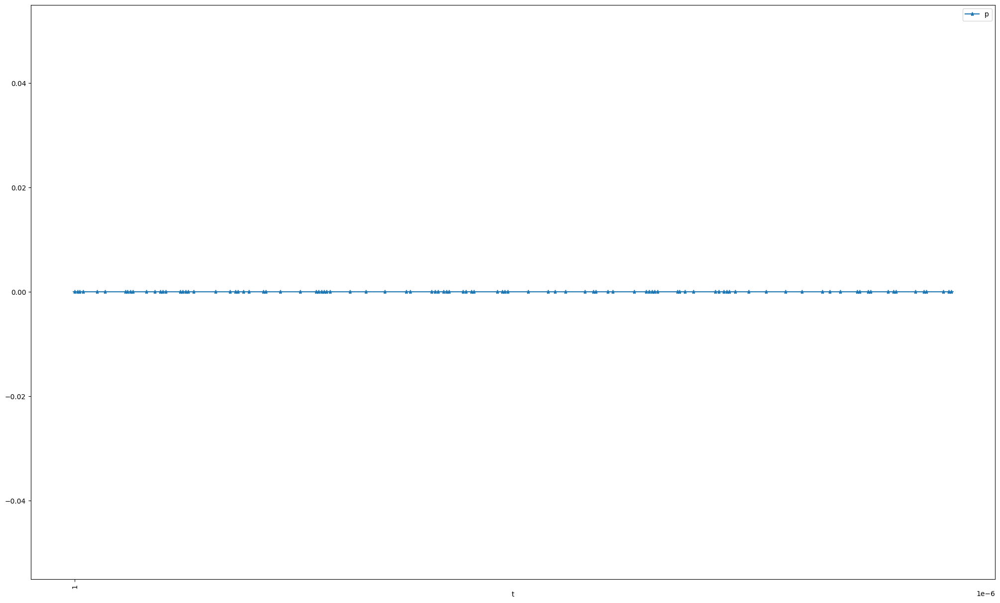

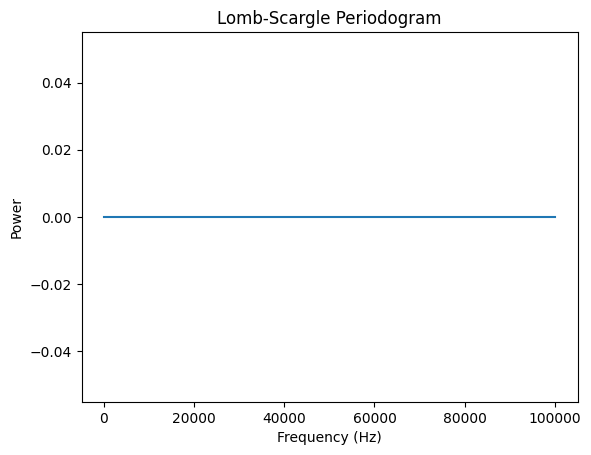

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100Khz_direct_1m.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,1,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(100, 100000, 100)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## direct 50k

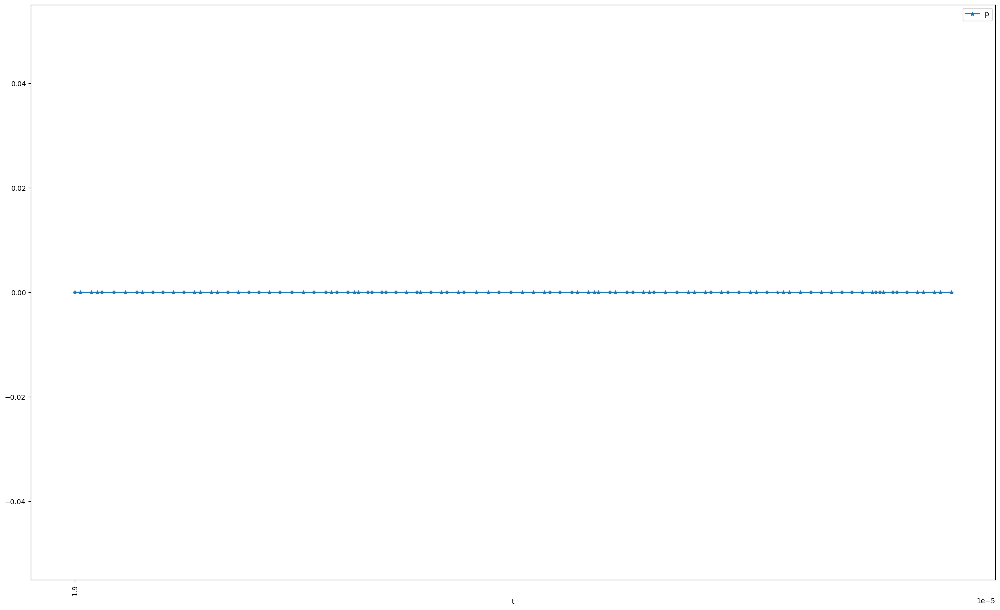

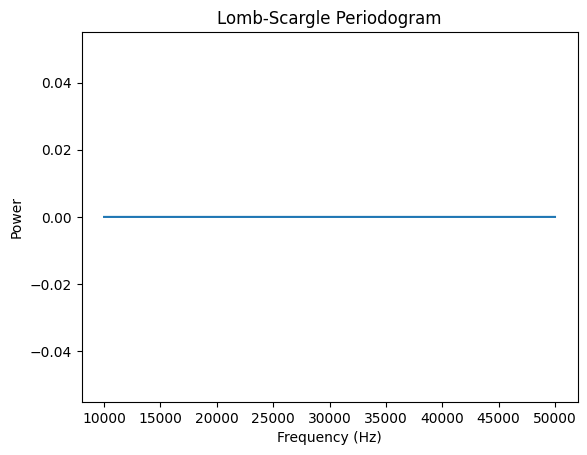

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/50k_direct_new.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10000, 50000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## 20K direct

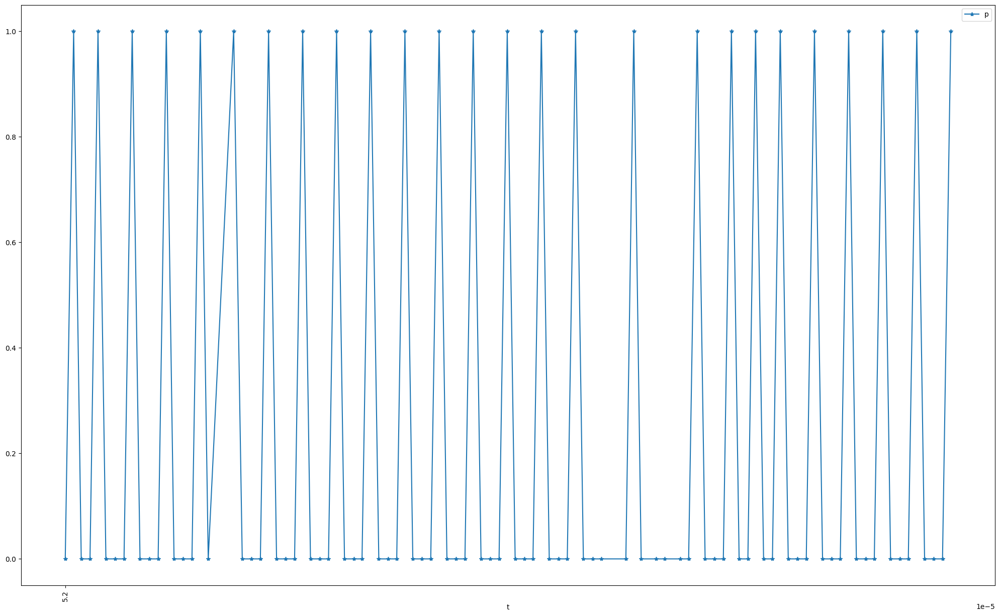

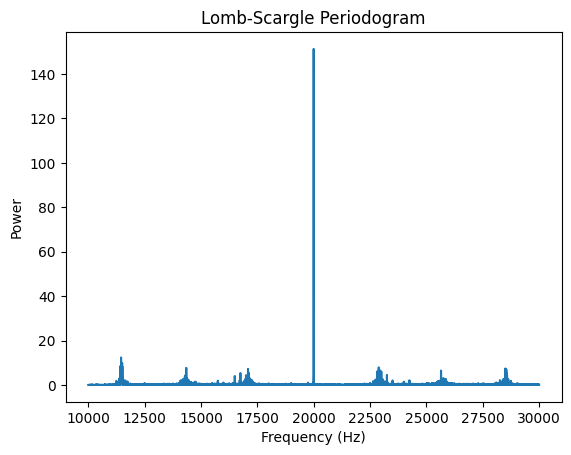

Frequency: 20001.000100010002 Hz, Power: 151.28366822835682
Frequency: 11458.145814581458 Hz, Power: 12.3599956984451
Frequency: 11506.150615061506 Hz, Power: 9.90110362766876
Frequency: 11502.150215021502 Hz, Power: 9.545668180825146
Frequency: 11482.148214821482 Hz, Power: 8.882784772004053
Frequency: 11428.142814281427 Hz, Power: 8.532442803047578
Frequency: 11512.151215121512 Hz, Power: 8.359787333384038
Frequency: 20005.000500050002 Hz, Power: 8.323977343883305
Frequency: 22887.28872887289 Hz, Power: 7.8950423453558045
Frequency: 14350.435043504349 Hz, Power: 7.693159334441507
Frequency: 28501.850185018502 Hz, Power: 7.392348910962195
Frequency: 17088.708870887087 Hz, Power: 7.22941691040295
Frequency: 28545.854585458543 Hz, Power: 6.973754760866488
Frequency: 22913.29132913291 Hz, Power: 6.964136989820351
Frequency: 28507.850785078506 Hz, Power: 6.8874028637763
Frequency: 28541.85418541854 Hz, Power: 6.726908212740334
Frequency: 11454.145414541454 Hz, Power: 6.632442637343011
Fre

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/20k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10000, 30000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## 30K direct

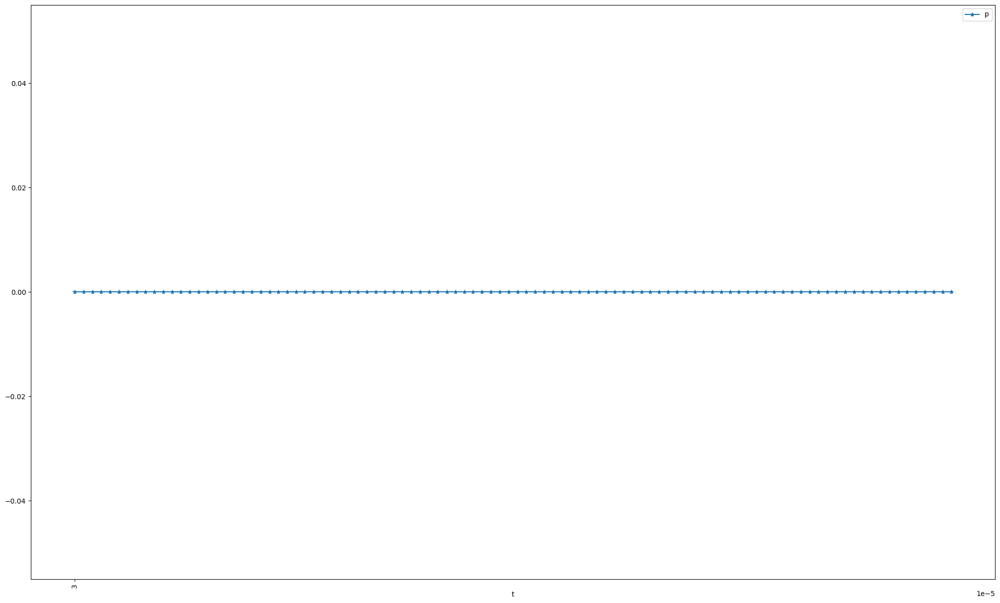

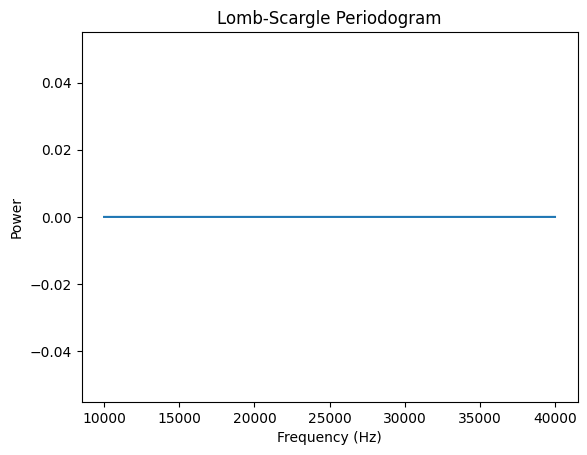

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/30k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10000, 40000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## 40K direct

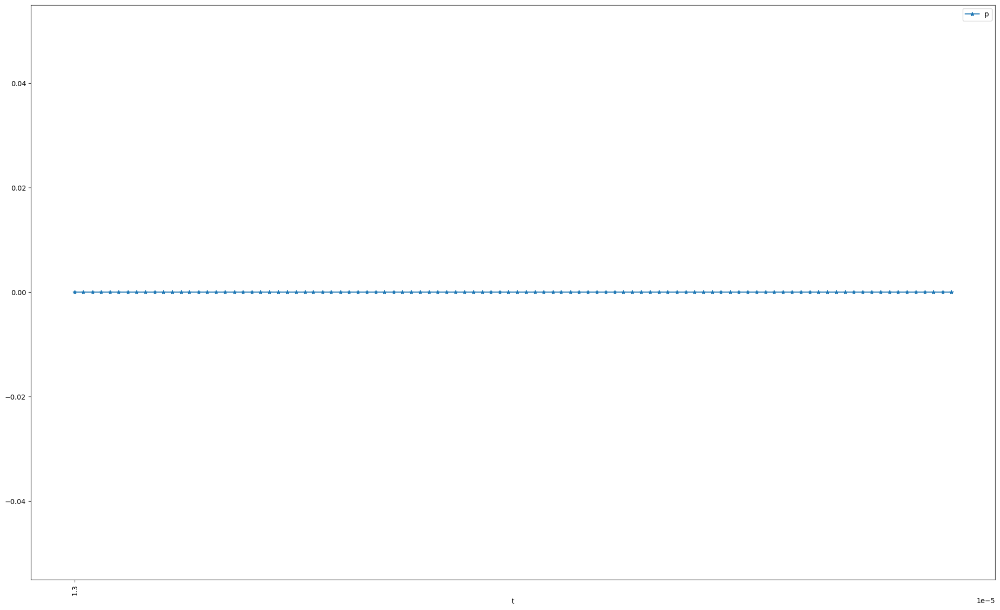

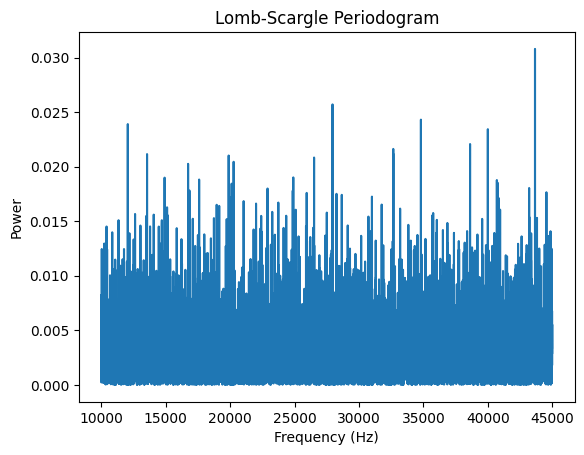

Frequency: 43662.86628662866 Hz, Power: 0.030786078297702878
Frequency: 27946.294629462944 Hz, Power: 0.02570313590321352
Frequency: 34806.980698069805 Hz, Power: 0.02430608398514432
Frequency: 12054.705470547055 Hz, Power: 0.02389874032193873
Frequency: 40001.500150014996 Hz, Power: 0.023431754693317274
Frequency: 38622.36223622362 Hz, Power: 0.022070404180696186
Frequency: 32661.26612661266 Hz, Power: 0.02162336691505954
Frequency: 32650.76507650765 Hz, Power: 0.021208204702043675
Frequency: 13549.35493549355 Hz, Power: 0.021149897891576997
Frequency: 19884.988498849885 Hz, Power: 0.02101812892636625
Frequency: 26514.651465146515 Hz, Power: 0.020834711947593974
Frequency: 20270.02700270027 Hz, Power: 0.020445444231190678
Frequency: 16734.673467346736 Hz, Power: 0.02025566915919675
Frequency: 24900.990099009898 Hz, Power: 0.01901400598421304
Frequency: 14910.99109910991 Hz, Power: 0.01899130060964392
Frequency: 17592.259225922593 Hz, Power: 0.018818874421056342
Frequency: 40701.570157

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/40k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10000, 45000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 60Hz direct

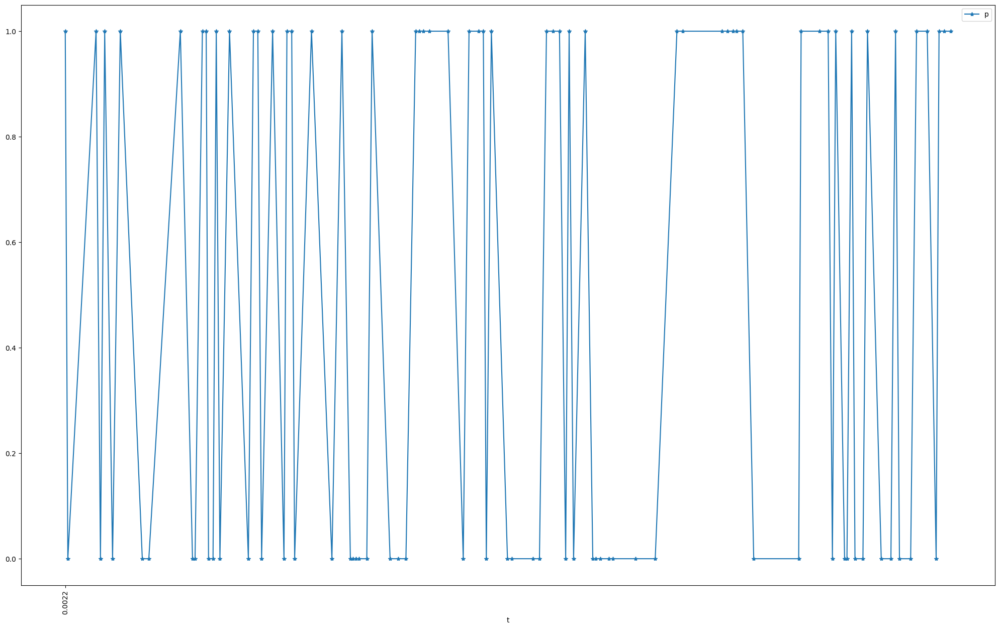

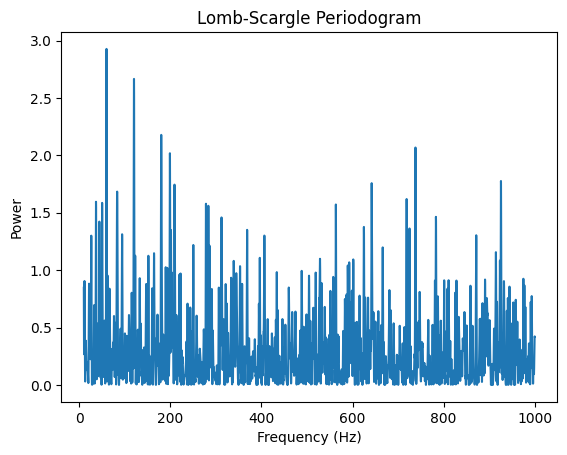

Frequency: 59.801980198019805 Hz, Power: 2.927558795062712
Frequency: 120.0990099009901 Hz, Power: 2.6664635373019463
Frequency: 179.9009900990099 Hz, Power: 2.1787243929317195
Frequency: 738.1188118811882 Hz, Power: 2.068357711748368
Frequency: 199.00990099009903 Hz, Power: 2.018461944530962
Frequency: 925.8415841584159 Hz, Power: 1.7767401787225616
Frequency: 641.9801980198021 Hz, Power: 1.7579055324156705
Frequency: 209.10891089108912 Hz, Power: 1.7450009236640396
Frequency: 83.16831683168317 Hz, Power: 1.6841963592155282
Frequency: 718.7128712871288 Hz, Power: 1.6197540993855686
Frequency: 36.73267326732673 Hz, Power: 1.5959278850131737
Frequency: 50.1980198019802 Hz, Power: 1.5860562502652074
Frequency: 278.21782178217825 Hz, Power: 1.5785733730460256
Frequency: 563.3663366336634 Hz, Power: 1.572032779966001
Frequency: 283.36633663366337 Hz, Power: 1.5607340237578842
Frequency: 783.0693069306931 Hz, Power: 1.4644296082015096
Frequency: 312.2772277227723 Hz, Power: 1.45928266370425

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_60hz_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 1000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 100Hz Direct

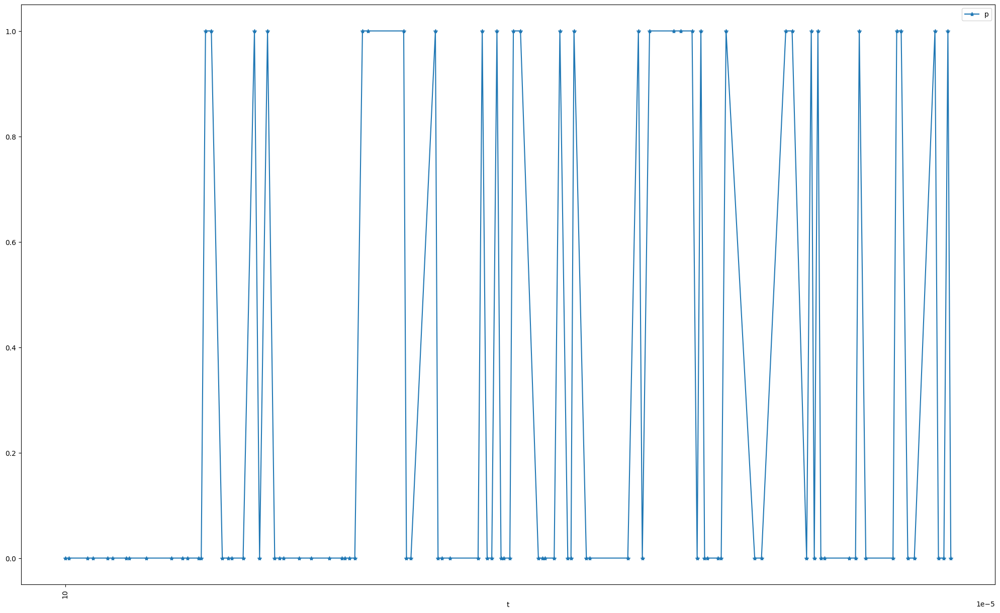

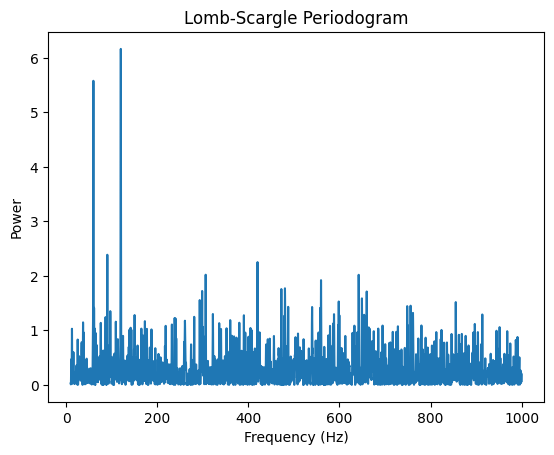

Frequency: 120.0 Hz, Power: 6.166731883127429
Frequency: 59.801980198019805 Hz, Power: 5.581529851084844
Frequency: 90.3960396039604 Hz, Power: 2.388850331006244
Frequency: 420.1980198019802 Hz, Power: 2.2537992858826454
Frequency: 306.33663366336634 Hz, Power: 2.0223097693518546
Frequency: 642.2772277227723 Hz, Power: 2.0209565148132764
Frequency: 559.6039603960396 Hz, Power: 1.9224640711322594
Frequency: 480.39603960396045 Hz, Power: 1.7734222702513804
Frequency: 472.4752475247525 Hz, Power: 1.759297662931834
Frequency: 298.61386138613864 Hz, Power: 1.7242475093515401
Frequency: 659.90099009901 Hz, Power: 1.7144093562878178
Frequency: 649.4059405940594 Hz, Power: 1.5882878598602947
Frequency: 293.26732673267327 Hz, Power: 1.556838507605512
Frequency: 598.5148514851486 Hz, Power: 1.5308445436720242
Frequency: 855.4455445544555 Hz, Power: 1.5201698417340646
Frequency: 756.2376237623763 Hz, Power: 1.4538686867720076
Frequency: 748.8118811881188 Hz, Power: 1.445582171798452
Frequency: 48

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_100hz_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 1000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 1k direct

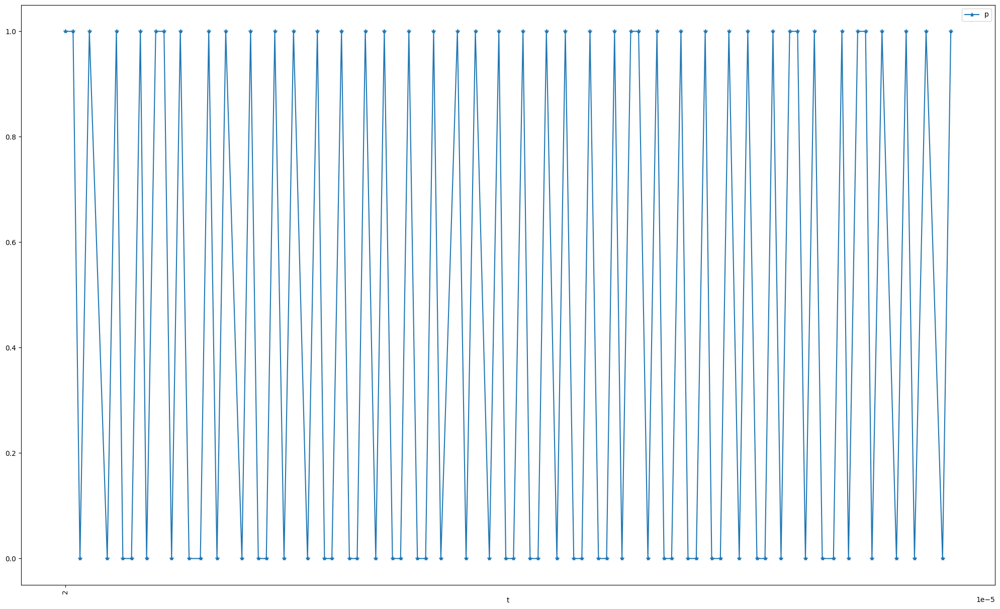

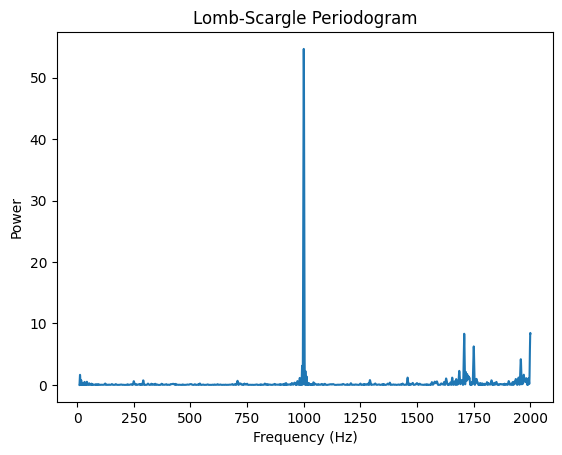

Frequency: 999.92499249925 Hz, Power: 54.67177025569679
Frequency: 1999.8009800980099 Hz, Power: 8.456991993816315
Frequency: 1708.0378037803782 Hz, Power: 8.32277017487613
Frequency: 1750.03100310031 Hz, Power: 6.268922276912086
Frequency: 1957.807780778078 Hz, Power: 4.183607253017952
Frequency: 992.5612561256127 Hz, Power: 3.1157524907113836
Frequency: 1686.3446344634465 Hz, Power: 2.2839988019042523
Frequency: 1007.0897089708972 Hz, Power: 2.2675906450809773
Frequency: 1715.0035003500352 Hz, Power: 2.1108519389046085
Frequency: 1720.775077507751 Hz, Power: 1.7803161512927574
Frequency: 1970.7440744074408 Hz, Power: 1.6596142439376769
Frequency: 12.587258725872587 Hz, Power: 1.6426232873525706
Frequency: 1726.3476347634764 Hz, Power: 1.413205407689275
Frequency: 1012.4632463246326 Hz, Power: 1.3658793335001578
Frequency: 1947.657765776578 Hz, Power: 1.1949252007210969
Frequency: 1458.0688068806883 Hz, Power: 1.193355365823049
Frequency: 1655.0985098509852 Hz, Power: 1.18871336425235

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_1k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 2.5k direct

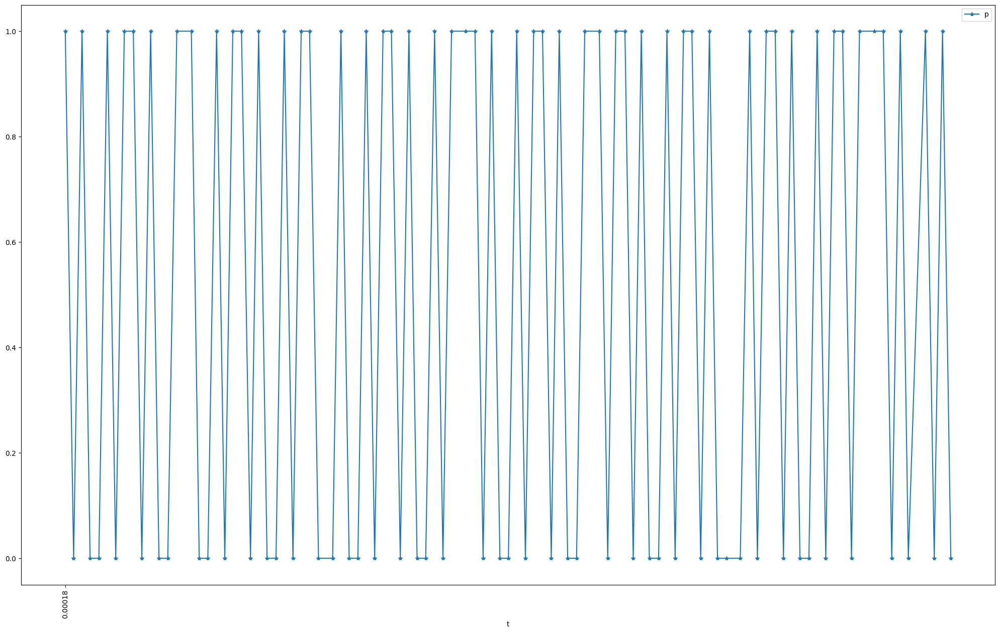

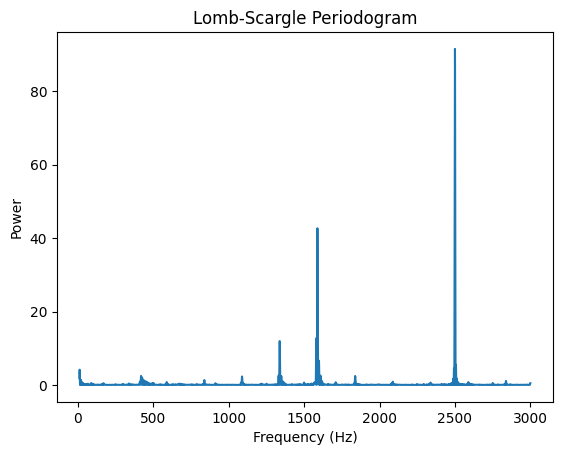

Frequency: 2500.02200220022 Hz, Power: 91.56023214446061
Frequency: 1587.980798079808 Hz, Power: 42.67455391139011
Frequency: 1580.8040804080408 Hz, Power: 12.73117097062823
Frequency: 1337.6927692769277 Hz, Power: 11.957173584257148
Frequency: 1598.147814781478 Hz, Power: 6.5863348095267895
Frequency: 2506.3016301630164 Hz, Power: 5.513340638314789
Frequency: 2493.4433443344333 Hz, Power: 4.46741819370715
Frequency: 11.196119611961196 Hz, Power: 4.150092198110718
Frequency: 1330.8150815081508 Hz, Power: 2.5529312969534628
Frequency: 1608.3148314831483 Hz, Power: 2.5300059932689662
Frequency: 418.47484748474847 Hz, Power: 2.4515609428037966
Frequency: 1838.2688268826882 Hz, Power: 2.425717328276468
Frequency: 1348.1588158815882 Hz, Power: 2.419839201916277
Frequency: 1088.002800280028 Hz, Power: 2.2944832302741736
Frequency: 425.65156515651563 Hz, Power: 1.985286345540439
Frequency: 2511.086108610861 Hz, Power: 1.784353119965969
Frequency: 2488.9578957895787 Hz, Power: 1.67661589709187

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_2_5k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 3000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 5k direct

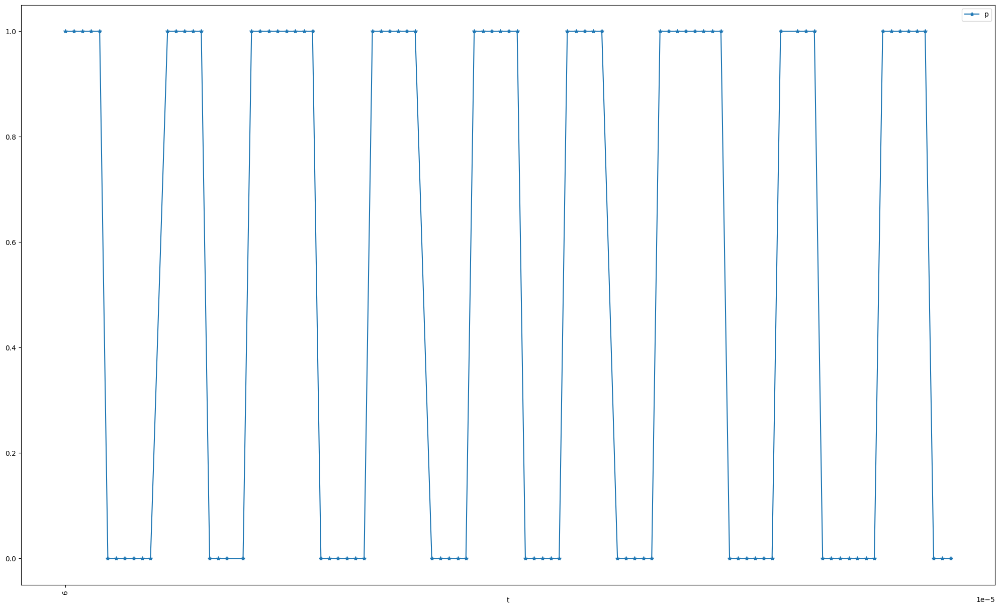

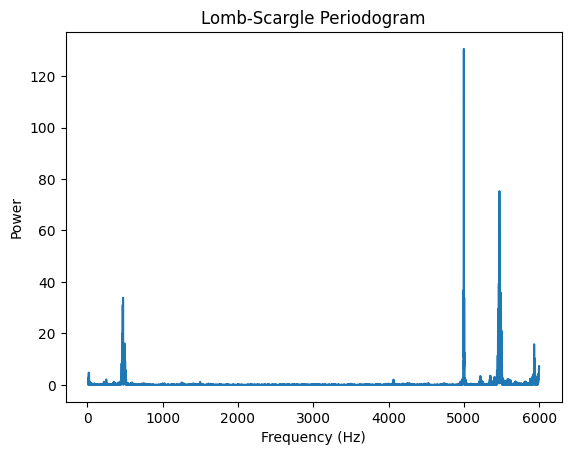

Frequency: 5000.16901690169 Hz, Power: 130.53769771091854
Frequency: 5472.8272827282735 Hz, Power: 75.28188447147714
Frequency: 5468.633863386339 Hz, Power: 61.283353486709345
Frequency: 5465.039503950396 Hz, Power: 39.3549330139231
Frequency: 4995.376537653766 Hz, Power: 36.780545258119695
Frequency: 5491.997199719973 Hz, Power: 35.78188295777036
Frequency: 5004.362436243625 Hz, Power: 33.90296598596831
Frequency: 473.0733073307331 Hz, Power: 33.86909054466512
Frequency: 468.87988798879894 Hz, Power: 31.154476509771104
Frequency: 5460.846084608461 Hz, Power: 29.575210165392352
Frequency: 5485.407540754076 Hz, Power: 25.443796207468186
Frequency: 5500.384038403841 Hz, Power: 21.057588507975183
Frequency: 464.68646864686474 Hz, Power: 20.012029483017887
Frequency: 5454.256425642565 Hz, Power: 19.31211883457015
Frequency: 492.2432243224323 Hz, Power: 16.11506278171556
Frequency: 5934.103410341035 Hz, Power: 15.792125058927084
Frequency: 461.09210921092114 Hz, Power: 12.567817178898853
Fr

In [22]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_5k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 6000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 10k direct

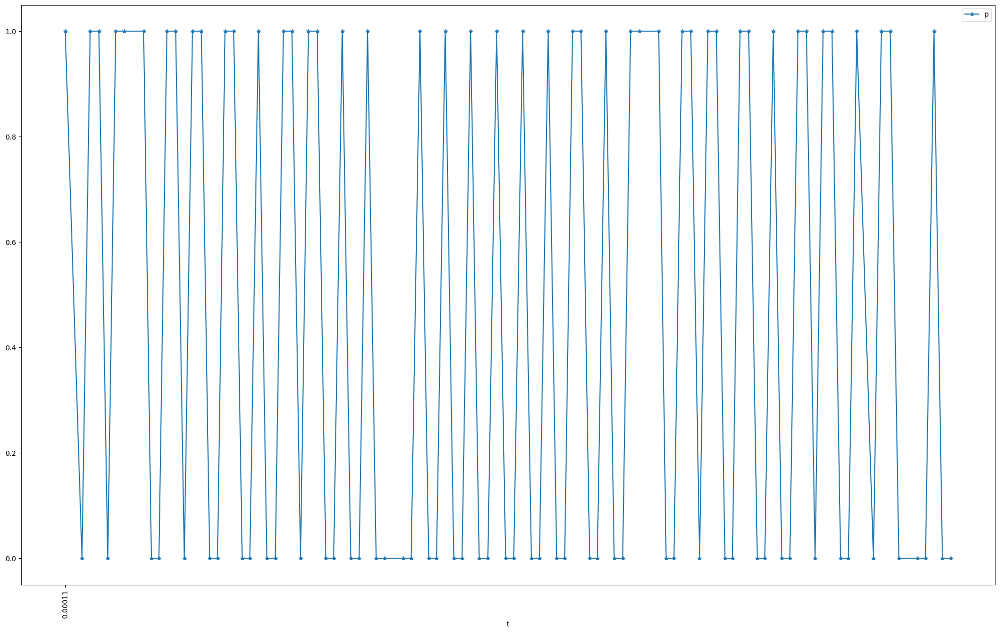

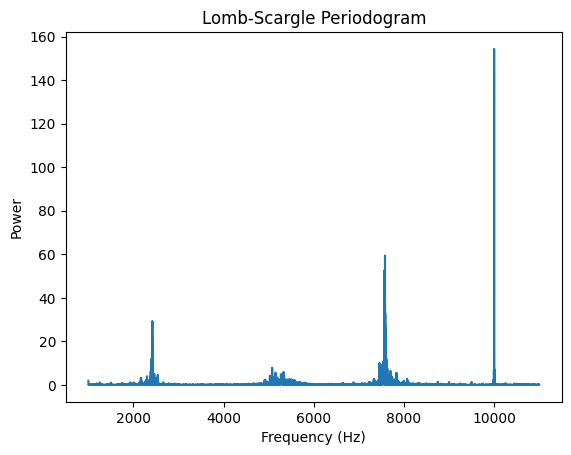

Frequency: 9999.899989999 Hz, Power: 154.3079757850016
Frequency: 7579.657965796579 Hz, Power: 59.414047048941036
Frequency: 7567.656765676567 Hz, Power: 52.698078063561354
Frequency: 7584.6584658465845 Hz, Power: 32.98204289584801
Frequency: 2421.1421142114214 Hz, Power: 29.336356016849397
Frequency: 7597.659765976598 Hz, Power: 26.315775739669203
Frequency: 2432.143214321432 Hz, Power: 21.86416219124023
Frequency: 7592.6592659265925 Hz, Power: 19.751876367311993
Frequency: 2415.1415141514153 Hz, Power: 14.243911028453741
Frequency: 2402.1402140214022 Hz, Power: 12.17834137281396
Frequency: 7617.661766176617 Hz, Power: 11.596332630321921
Frequency: 7536.653665366536 Hz, Power: 10.742186257288953
Frequency: 7458.645864586458 Hz, Power: 10.122470529392084
Frequency: 7573.657365736573 Hz, Power: 9.631792355423283
Frequency: 7612.661266126612 Hz, Power: 9.397602456856625
Frequency: 7493.649364936493 Hz, Power: 9.179753880505412
Frequency: 7550.65506550655 Hz, Power: 8.160020082378226
Freq

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_10k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 11000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## ambient 20k direct

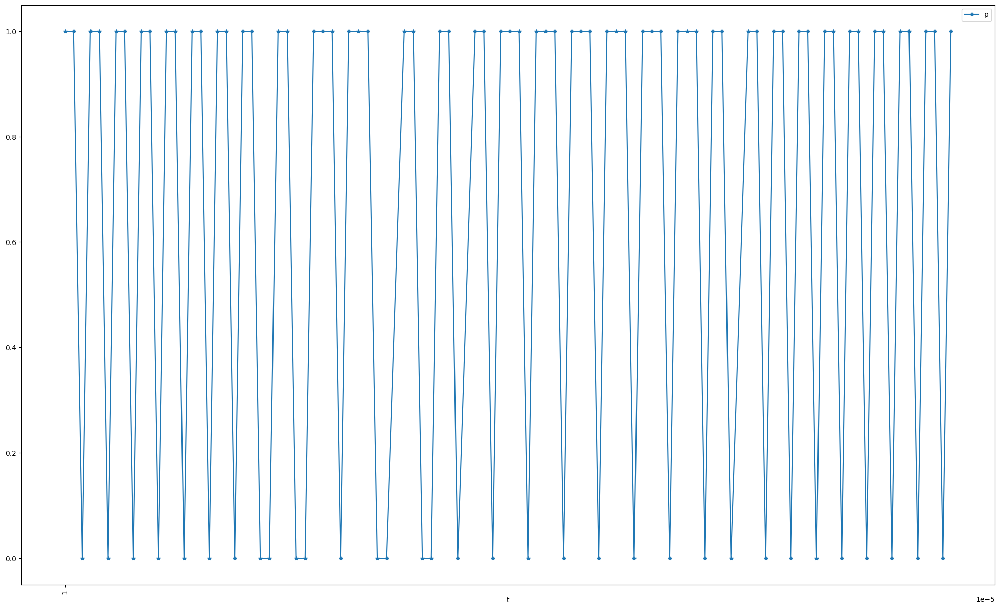

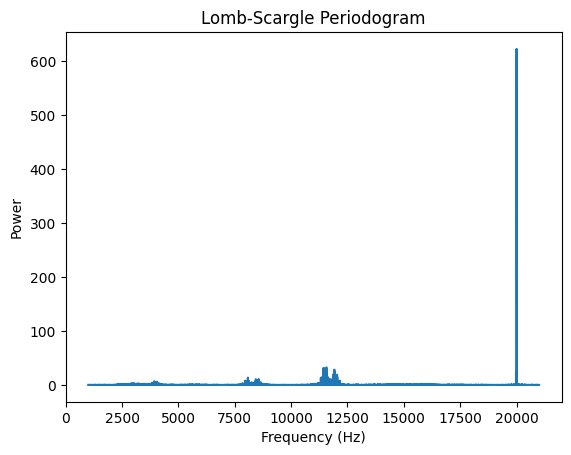

Frequency: 19999.899989998998 Hz, Power: 623.0350325720492
Frequency: 11567.056705670566 Hz, Power: 32.472758908330675
Frequency: 11445.044504450445 Hz, Power: 31.57772772112823
Frequency: 11439.043904390439 Hz, Power: 30.848615121751106
Frequency: 11919.091909190918 Hz, Power: 28.370940936735995
Frequency: 11555.055505550554 Hz, Power: 25.44625740827131
Frequency: 19995.899589958994 Hz, Power: 24.25765836477873
Frequency: 11927.092709270926 Hz, Power: 23.425493143906536
Frequency: 11575.057505750574 Hz, Power: 22.296186746047823
Frequency: 11525.052505250524 Hz, Power: 20.417793432469992
Frequency: 11867.086708670866 Hz, Power: 19.43311455336938
Frequency: 11891.08910891089 Hz, Power: 19.1290127507409
Frequency: 12037.103710371037 Hz, Power: 19.000886652289786
Frequency: 11475.047504750473 Hz, Power: 17.97983725530962
Frequency: 11419.041904190419 Hz, Power: 17.355418068548055
Frequency: 11595.059505950594 Hz, Power: 16.747646766764554
Frequency: 11955.095509550954 Hz, Power: 16.70462

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/ambient_20k_direct.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 21000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their correspondin
# g power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 10k

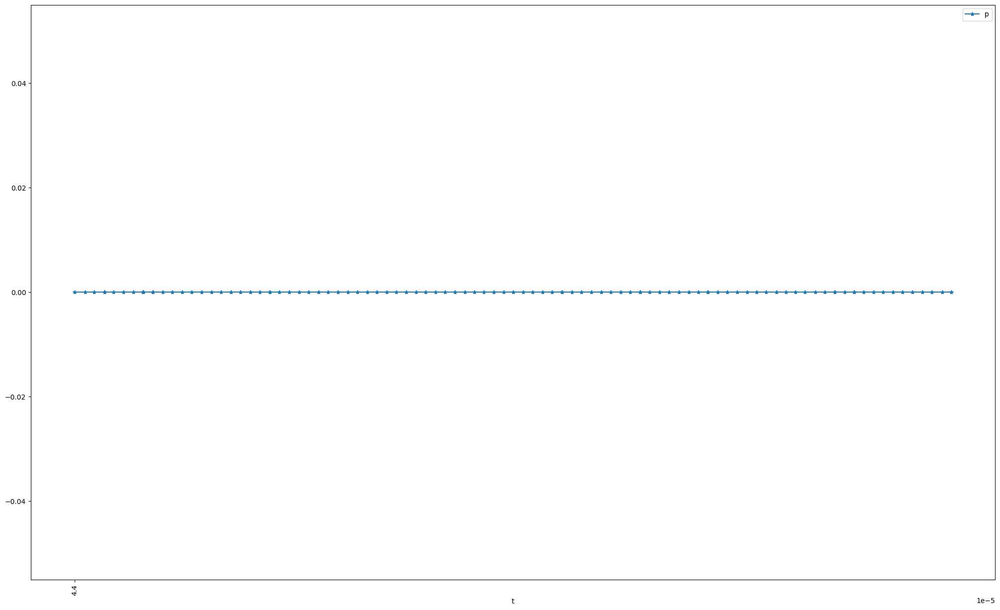

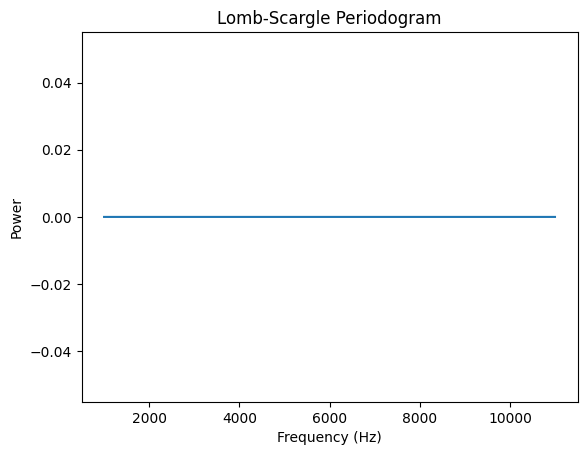

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_10k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 11000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 20k

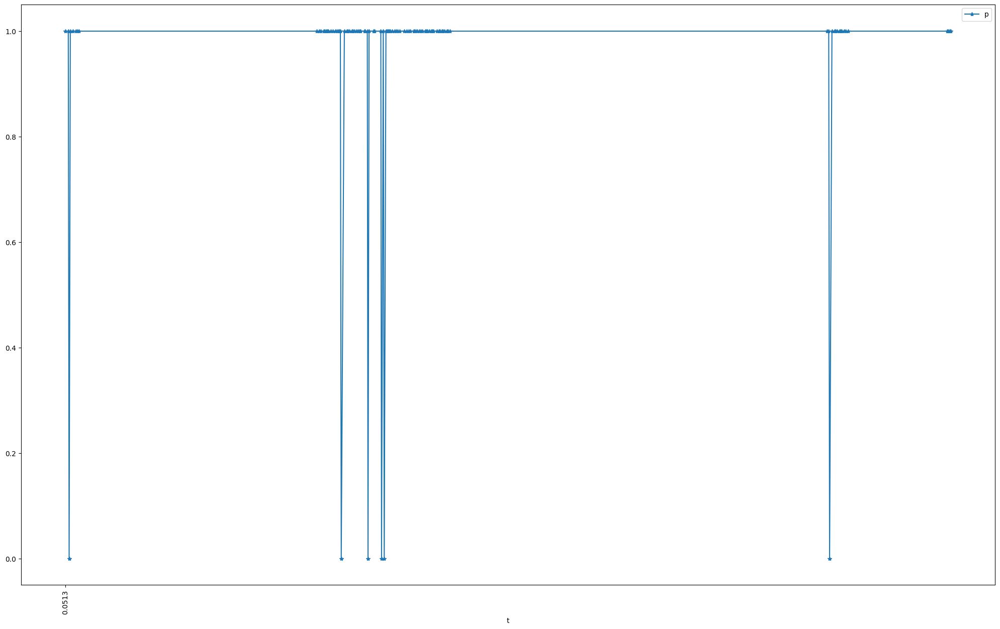

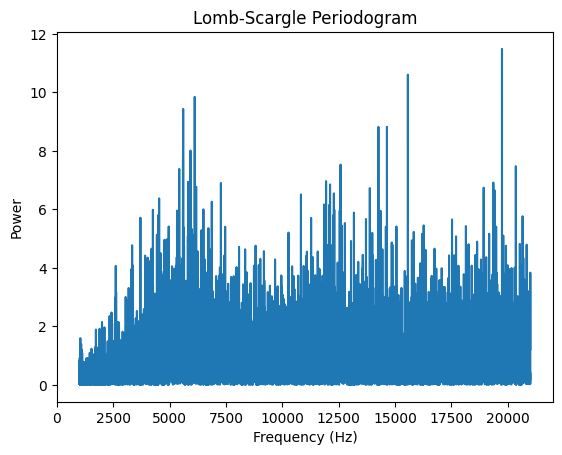

Frequency: 19741.87418741874 Hz, Power: 11.484038804988815
Frequency: 15567.456745674566 Hz, Power: 10.605753710486887
Frequency: 6112.511251125112 Hz, Power: 9.844915594033367
Frequency: 5600.4600460046 Hz, Power: 9.433836919435006
Frequency: 14639.363936393638 Hz, Power: 8.820431774288377
Frequency: 14261.32613261326 Hz, Power: 8.819442194505186
Frequency: 5924.4924492449245 Hz, Power: 8.011808062612033
Frequency: 5592.459245924592 Hz, Power: 7.71332320960084
Frequency: 12581.15811581158 Hz, Power: 7.5304324084560035
Frequency: 20355.935593559356 Hz, Power: 7.475673343568144
Frequency: 5426.442644264426 Hz, Power: 7.382261488513094
Frequency: 11939.093909390938 Hz, Power: 6.964974460155121
Frequency: 5826.482648264826 Hz, Power: 6.94406127249557
Frequency: 19357.835783578357 Hz, Power: 6.9151229583705645
Frequency: 7274.627462746274 Hz, Power: 6.902771648523923
Frequency: 12115.111511151114 Hz, Power: 6.8531128757316555
Frequency: 6176.517651765176 Hz, Power: 6.772417041657384
Freque

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_20k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 21000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead multi object 60Hz

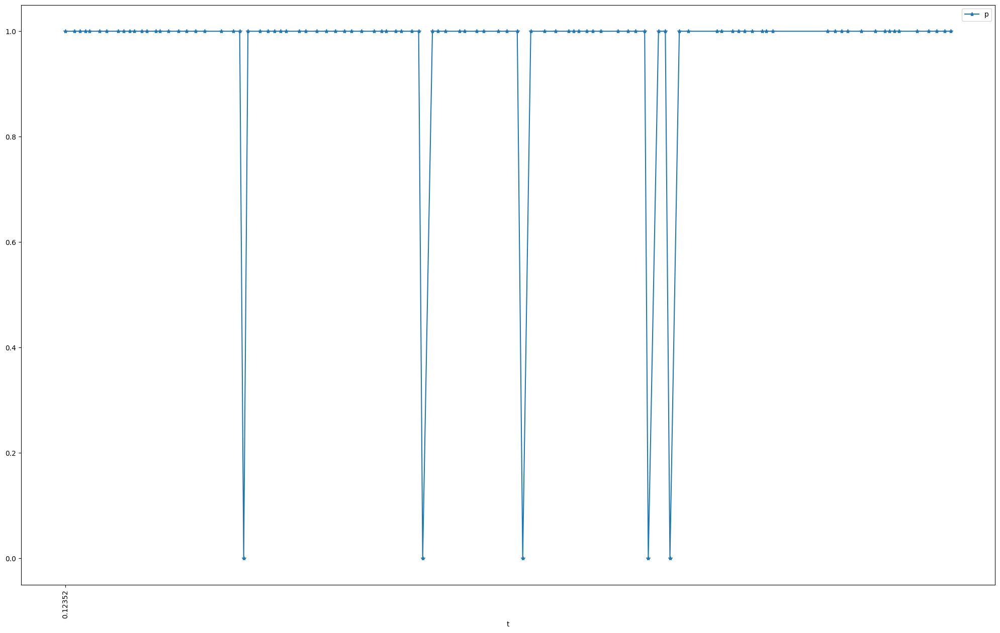

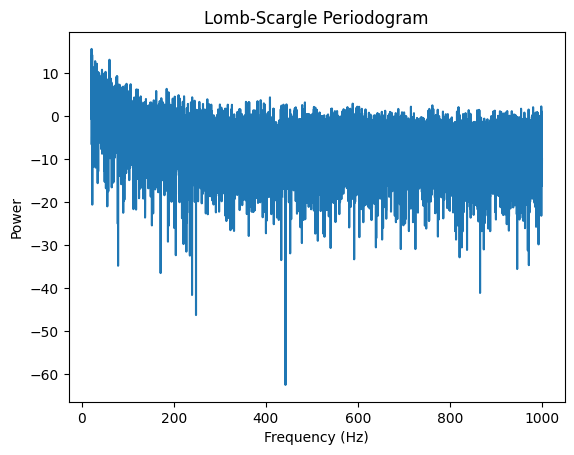

Frequency: 21.078107810781077 Hz, Power: 35.85720360903546
Frequency: 22.352235223522353 Hz, Power: 25.97158842642972
Frequency: 20.294029402940293 Hz, Power: 23.712208947614908
Frequency: 59.98799879987999 Hz, Power: 20.133746547729004
Frequency: 28.91889188918892 Hz, Power: 18.647509479361098
Frequency: 32.44724472447245 Hz, Power: 16.25154787199496
Frequency: 31.76117611761176 Hz, Power: 14.960702620215367
Frequency: 32.25122512251225 Hz, Power: 14.440517642286151
Frequency: 27.546754675467547 Hz, Power: 13.833753313216576
Frequency: 25.684568456845685 Hz, Power: 12.667332209628789
Frequency: 25.194519451945194 Hz, Power: 12.200327407970493
Frequency: 23.03830383038304 Hz, Power: 12.122206616409365
Frequency: 43.71837183718372 Hz, Power: 11.775437995343562
Frequency: 26.46864686468647 Hz, Power: 11.567059690123035
Frequency: 24.116411641164117 Hz, Power: 11.461195594607142
Frequency: 26.762676267626762 Hz, Power: 11.41093823275061
Frequency: 23.43034303430343 Hz, Power: 10.998461573

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_multi_60hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(20, 1000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 1k

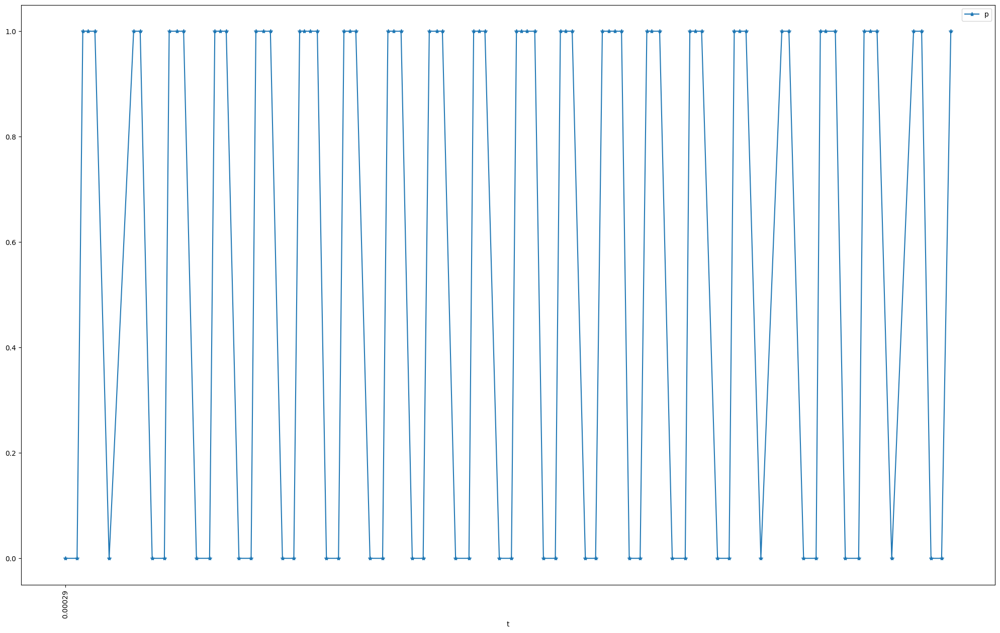

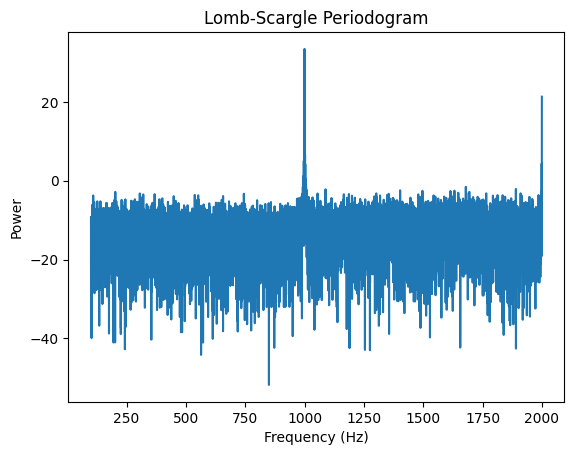

Frequency: 999.9299929993 Hz, Power: 2208.7664936448227
Frequency: 999.1699169916992 Hz, Power: 21.42939887018116
Frequency: 1001.0701070107011 Hz, Power: 20.846007827262856
Frequency: 998.0298029802981 Hz, Power: 5.543693636955706
Frequency: 1002.2102210221022 Hz, Power: 4.613981639718207
Frequency: 996.889688968897 Hz, Power: 3.181173243601326
Frequency: 1999.4299429942996 Hz, Power: 2.7365145068227656
Frequency: 1002.970297029703 Hz, Power: 2.6213363690057756
Frequency: 996.1296129612962 Hz, Power: 1.3288433168872533
Frequency: 994.7994799479949 Hz, Power: 1.1025118546682173
Frequency: 1004.3004300430043 Hz, Power: 1.0959838041361976
Frequency: 1006.3906390639064 Hz, Power: 0.728938431198273
Frequency: 1005.0605060506051 Hz, Power: 0.7086666551669799
Frequency: 992.899289928993 Hz, Power: 0.7079873157719674
Frequency: 1679.6279627962797 Hz, Power: 0.7007733794775699
Frequency: 994.0394039403941 Hz, Power: 0.6958471602732033
Frequency: 1890.5490549054907 Hz, Power: 0.6164783939388019

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_multi_1k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(100, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 5k

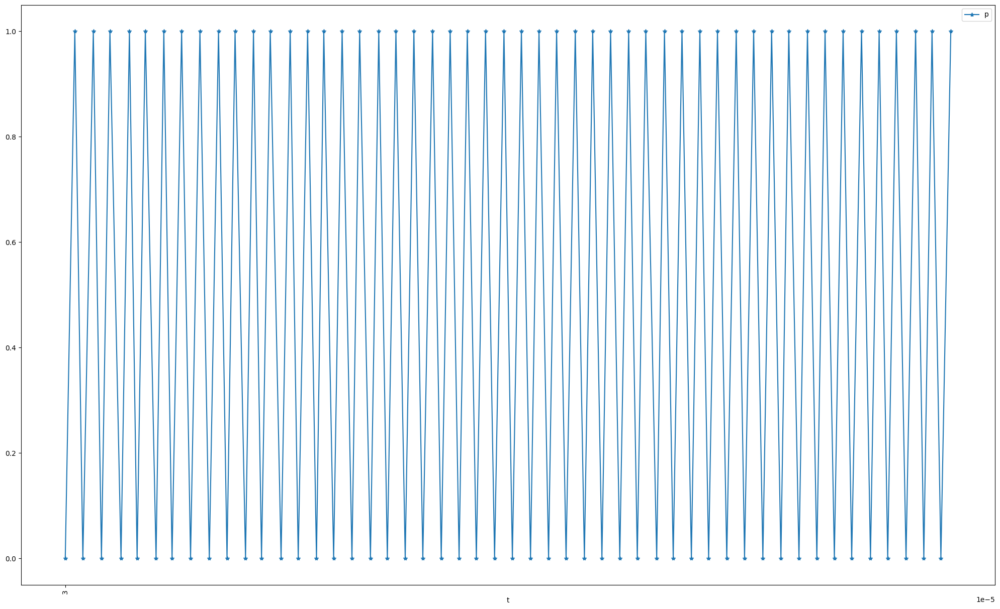

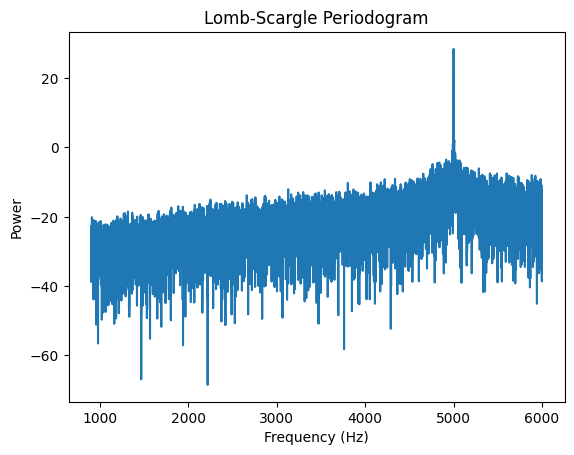

Frequency: 5000.300030003 Hz, Power: 698.7382356232453
Frequency: 4999.2799279927995 Hz, Power: 50.908192587588886
Frequency: 4998.259825982598 Hz, Power: 9.396947182770496
Frequency: 5002.850285028503 Hz, Power: 3.263369361327025
Frequency: 4997.239723972397 Hz, Power: 2.7804390694302947
Frequency: 5003.8703870387035 Hz, Power: 2.6665728334480576
Frequency: 4995.709570957096 Hz, Power: 2.4973160461954915
Frequency: 5005.910591059106 Hz, Power: 1.6551562177535357
Frequency: 5007.440744074407 Hz, Power: 1.5708491091081331
Frequency: 4993.669366936694 Hz, Power: 1.394822746381561
Frequency: 4992.649264926493 Hz, Power: 1.223852587213917
Frequency: 5004.890489048905 Hz, Power: 1.2118014148387541
Frequency: 4994.6894689468945 Hz, Power: 0.9744653302319306
Frequency: 4983.468346834683 Hz, Power: 0.7932635835729059
Frequency: 5008.460846084608 Hz, Power: 0.7449464924417889
Frequency: 5018.661866186619 Hz, Power: 0.6664377393762707
Frequency: 4916.141614161416 Hz, Power: 0.44825360219469923
F

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_multi_5k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 6000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 10k

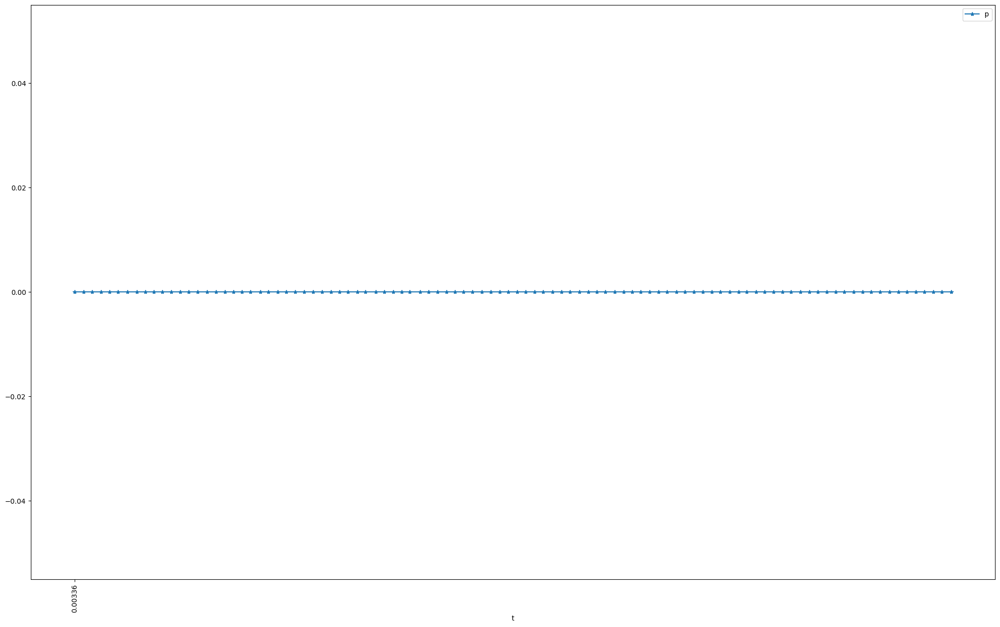

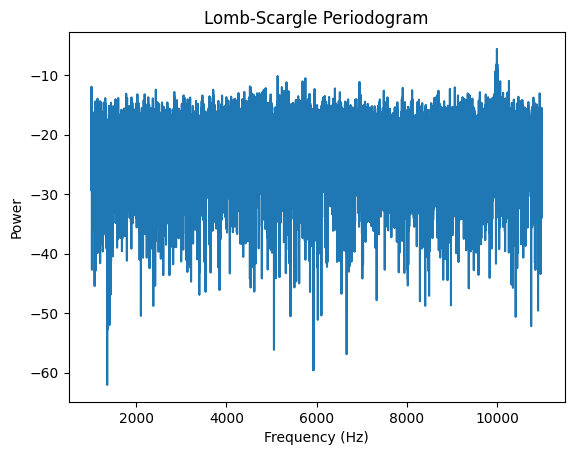

Frequency: 10000.900090009 Hz, Power: 0.2772560992083755
Frequency: 9991.899189918991 Hz, Power: 0.1542418862474072
Frequency: 10010.90109010901 Hz, Power: 0.152777638897774
Frequency: 10004.900490049004 Hz, Power: 0.13214977736632194
Frequency: 9967.896789678967 Hz, Power: 0.11805678597715273
Frequency: 9974.897489748973 Hz, Power: 0.11447185750768094
Frequency: 9984.898489848983 Hz, Power: 0.09839441313479103
Frequency: 5137.413741374137 Hz, Power: 0.09719779487118413
Frequency: 5752.475247524752 Hz, Power: 0.08927495358248029
Frequency: 9977.897789778977 Hz, Power: 0.08342546337606638
Frequency: 10267.926792679267 Hz, Power: 0.08042782722568893
Frequency: 10072.907290729072 Hz, Power: 0.07948206965566988
Frequency: 5689.468946894689 Hz, Power: 0.0791935046159083
Frequency: 6953.595359535953 Hz, Power: 0.0771509953436626
Frequency: 5333.433343334333 Hz, Power: 0.07646472168207198
Frequency: 9996.899689968996 Hz, Power: 0.06948611825034574
Frequency: 4523.352335233523 Hz, Power: 0.065

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_multi_10k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 11000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

## Overhead 20k

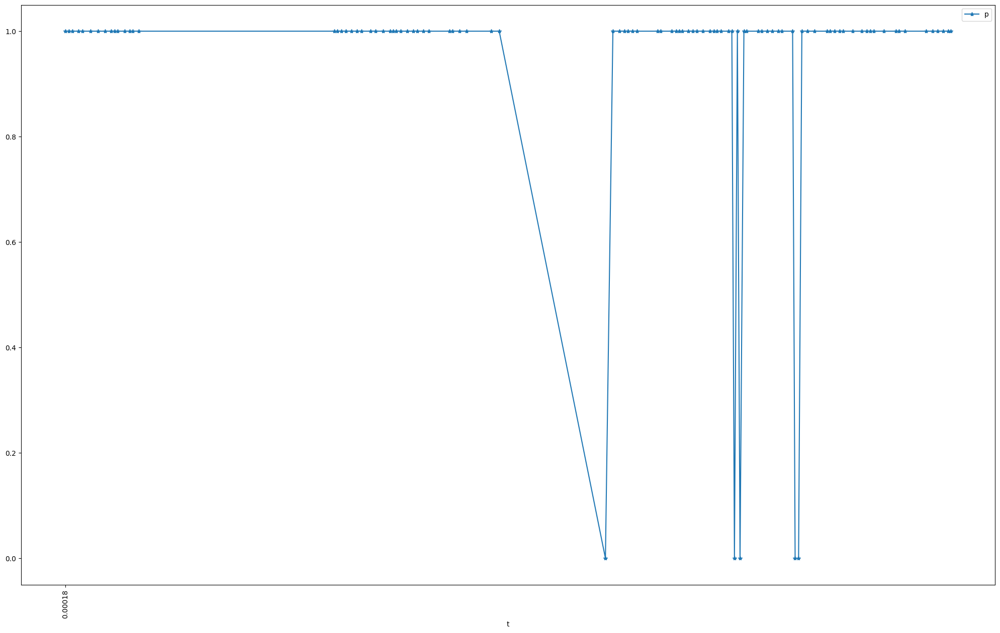

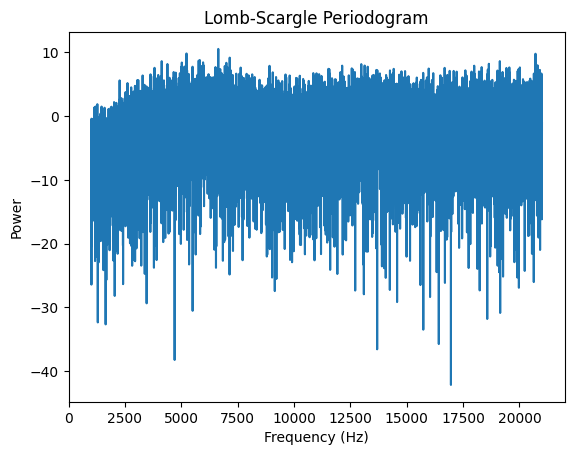

Frequency: 6642.564256425642 Hz, Power: 11.317445229749351
Frequency: 5232.423242324232 Hz, Power: 9.60537606124851
Frequency: 20711.97119711971 Hz, Power: 9.513942603696751
Frequency: 7148.614861486148 Hz, Power: 8.260630864533987
Frequency: 5822.482248224822 Hz, Power: 7.574967211550185
Frequency: 5772.4772477247725 Hz, Power: 7.417772433105015
Frequency: 19129.812981298128 Hz, Power: 7.278781051360263
Frequency: 4132.313231323133 Hz, Power: 7.275451801886429
Frequency: 5968.496849684968 Hz, Power: 6.968321261235024
Frequency: 5024.402440244025 Hz, Power: 6.923384246692594
Frequency: 7000.600060006 Hz, Power: 6.856588391961511
Frequency: 18643.76437643764 Hz, Power: 6.618690310903146
Frequency: 4386.338633863386 Hz, Power: 6.5639881489556515
Frequency: 12985.198519851985 Hz, Power: 6.537874872801412
Frequency: 5982.498249824982 Hz, Power: 6.321719123933385
Frequency: 20801.9801980198 Hz, Power: 6.2732638406838594
Frequency: 13133.213321332132 Hz, Power: 6.2105655975320815
Frequency: 

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/overhead_multi_20k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(1000, 21000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# laser 60 Hz

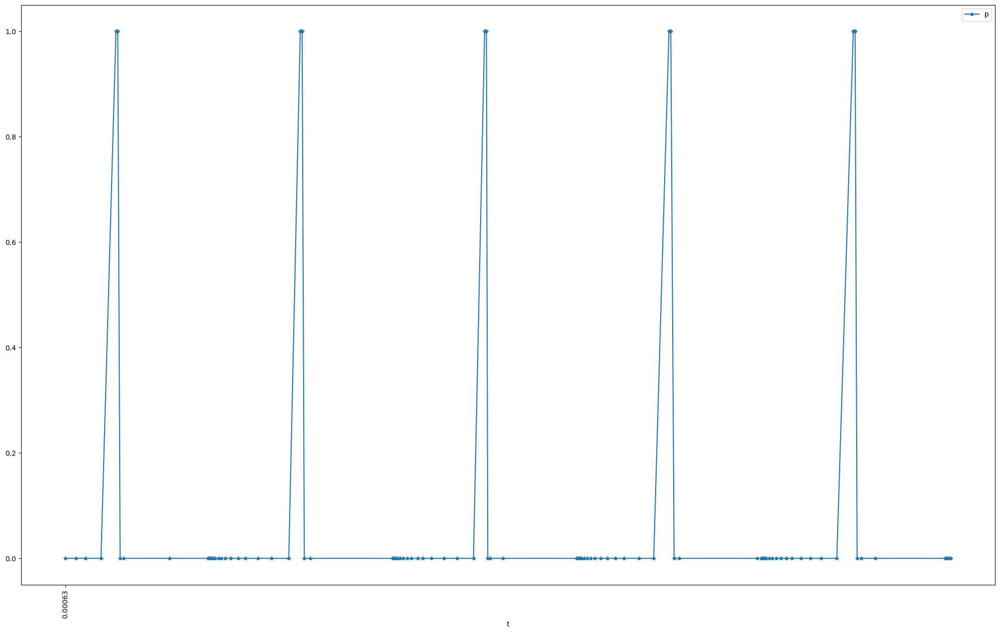

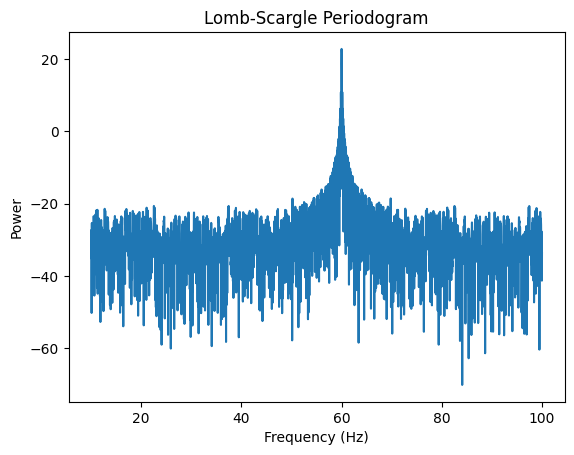

Frequency: 60.0 Hz, Power: 192.0826836563721
Frequency: 60.13501350135014 Hz, Power: 12.224690341809955
Frequency: 59.86498649864987 Hz, Power: 12.133488074578823
Frequency: 59.774977497749774 Hz, Power: 4.284679430742527
Frequency: 60.225022502250226 Hz, Power: 4.242468247239724
Frequency: 59.684968496849685 Hz, Power: 2.255948505837102
Frequency: 60.324032403240324 Hz, Power: 2.2546738357899994
Frequency: 60.41404140414041 Hz, Power: 1.3784170557235937
Frequency: 59.58595859585959 Hz, Power: 1.3661941518191765
Frequency: 59.4959495949595 Hz, Power: 0.8914168242840409
Frequency: 60.50405040504051 Hz, Power: 0.8896013487054043
Frequency: 59.40594059405941 Hz, Power: 0.6255471616215948
Frequency: 60.5940594059406 Hz, Power: 0.6180389533050823
Frequency: 59.31593159315932 Hz, Power: 0.5043162207126639
Frequency: 60.693069306930695 Hz, Power: 0.5007000877601897
Frequency: 60.783078307830785 Hz, Power: 0.3793138594329468
Frequency: 59.216921692169215 Hz, Power: 0.3716915694213396
Frequency

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_60hz.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(10, 100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# laser 50k

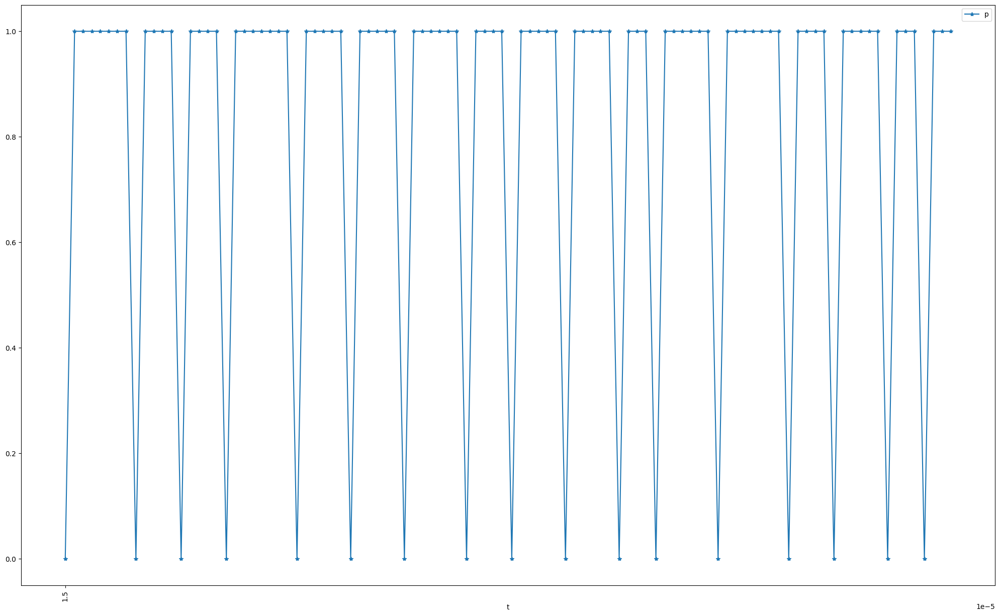

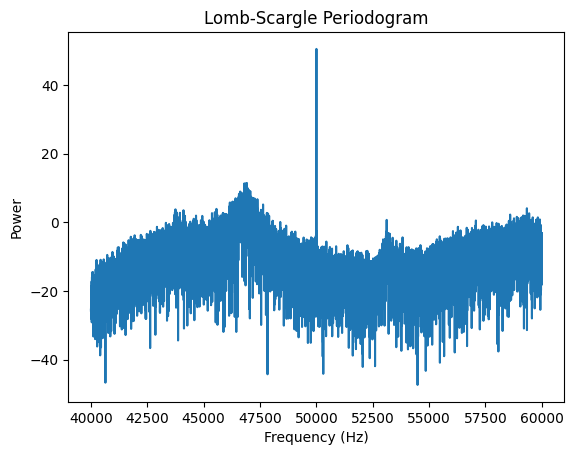

Frequency: 50001.00010001 Hz, Power: 111433.603802321
Frequency: 46916.69166916692 Hz, Power: 13.99110159320058
Frequency: 46864.68646864686 Hz, Power: 13.636187561829036
Frequency: 46802.6802680268 Hz, Power: 13.567241351835905
Frequency: 46884.688468846885 Hz, Power: 12.81822563311294
Frequency: 46898.6898689869 Hz, Power: 11.94882700259322
Frequency: 46816.68166816681 Hz, Power: 11.274531271652245
Frequency: 46946.694669466946 Hz, Power: 9.970046978598122
Frequency: 46890.68906890689 Hz, Power: 9.491505319624467
Frequency: 46838.68386838684 Hz, Power: 9.344479915772979
Frequency: 46904.6904690469 Hz, Power: 9.289053024062145
Frequency: 46792.67926792679 Hz, Power: 9.273388859125834
Frequency: 46928.692869286926 Hz, Power: 9.22890467519625
Frequency: 46850.68506850685 Hz, Power: 9.14332286913459
Frequency: 47006.700670067 Hz, Power: 8.751452513639663
Frequency: 46820.68206820682 Hz, Power: 8.161498348944207
Frequency: 47066.70667066707 Hz, Power: 8.113487617692584
Frequency: 46940.69

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_50k.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(40000, 60000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k 250k 500k laser LED direct
# sqare patch old data direct data
# 4 bits all combo - 

# laser 100k

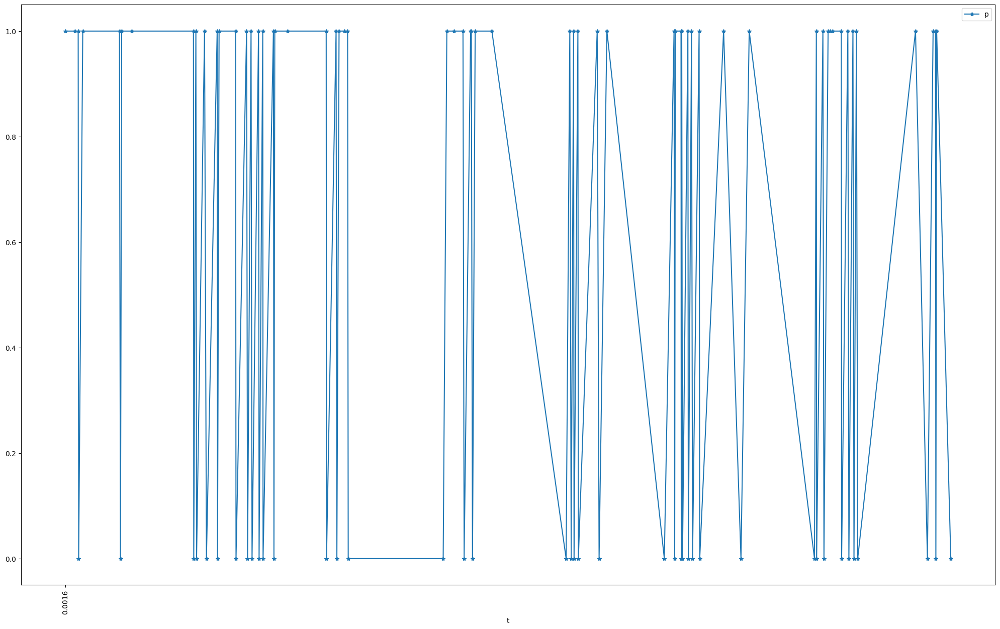

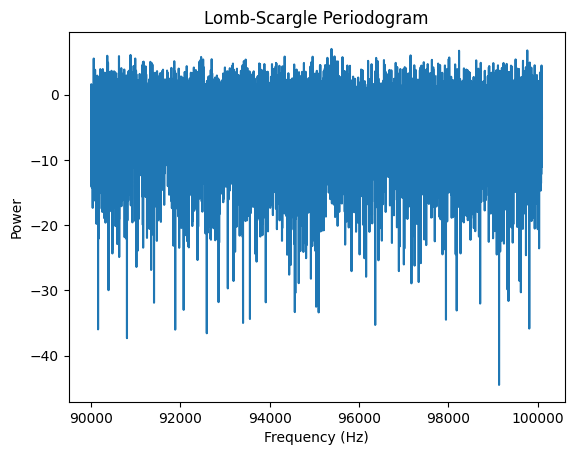

Frequency: 95384.84848484848 Hz, Power: 4.995314175607764
Frequency: 99770.70707070707 Hz, Power: 4.737680133674666
Frequency: 98242.42424242424 Hz, Power: 4.685051184760964
Frequency: 90883.83838383839 Hz, Power: 4.036700844143485
Frequency: 97156.56565656565 Hz, Power: 3.976592681763472
Frequency: 90362.62626262626 Hz, Power: 3.923901045739475
Frequency: 90625.25252525252 Hz, Power: 3.87615128984095
Frequency: 95452.52525252526 Hz, Power: 3.83885918816849
Frequency: 94336.36363636363 Hz, Power: 3.813725707672269
Frequency: 94962.62626262626 Hz, Power: 3.797483526388561
Frequency: 92464.64646464646 Hz, Power: 3.7622473778390586
Frequency: 95631.31313131313 Hz, Power: 3.7381228456188795
Frequency: 98022.22222222222 Hz, Power: 3.694204404158067
Frequency: 95293.93939393939 Hz, Power: 3.651169963747214
Frequency: 96385.85858585859 Hz, Power: 3.6378295895366213
Frequency: 90988.88888888889 Hz, Power: 3.5642798471692427
Frequency: 90059.59595959596 Hz, Power: 3.5587187108852234
Frequency: 

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_laser.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k laser with bias

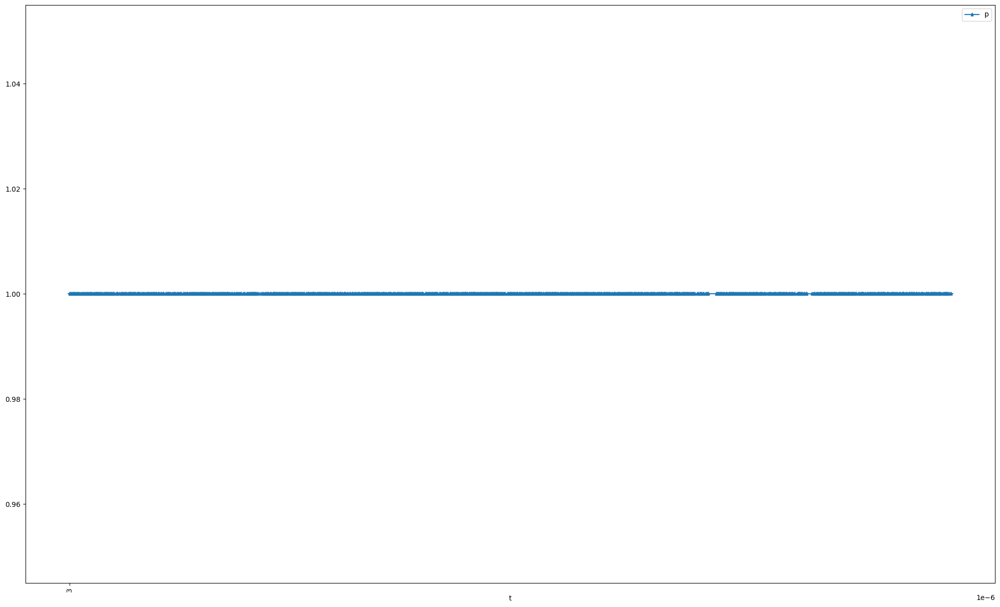

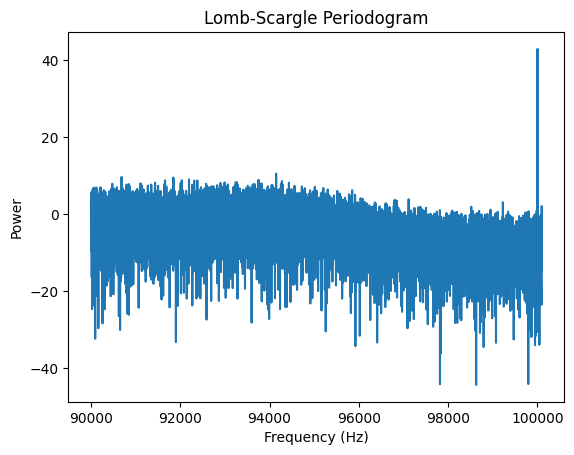

Frequency: 100002.0202020202 Hz, Power: 19341.471445418352
Frequency: 94148.48484848485 Hz, Power: 11.203428944017997
Frequency: 90685.85858585859 Hz, Power: 9.182767795932476
Frequency: 91845.45454545454 Hz, Power: 8.844754635645472
Frequency: 92196.9696969697 Hz, Power: 7.910659477945392
Frequency: 93753.53535353535 Hz, Power: 7.722195053367846
Frequency: 91850.50505050505 Hz, Power: 7.5751581115758455
Frequency: 92034.34343434343 Hz, Power: 7.517418543880665
Frequency: 91659.59595959596 Hz, Power: 7.480991919620139
Frequency: 92382.82828282828 Hz, Power: 7.4203439457128555
Frequency: 92312.12121212122 Hz, Power: 7.380280562090049
Frequency: 94277.77777777778 Hz, Power: 7.154795203054764
Frequency: 93243.43434343435 Hz, Power: 6.709717790273181
Frequency: 93270.70707070707 Hz, Power: 6.6323617391465035
Frequency: 92992.9292929293 Hz, Power: 6.6016175669033865
Frequency: 91436.36363636363 Hz, Power: 6.554813010660511
Frequency: 94435.35353535354 Hz, Power: 6.5067814392860175
Frequency

In [66]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_laser_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 1000, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k laser 

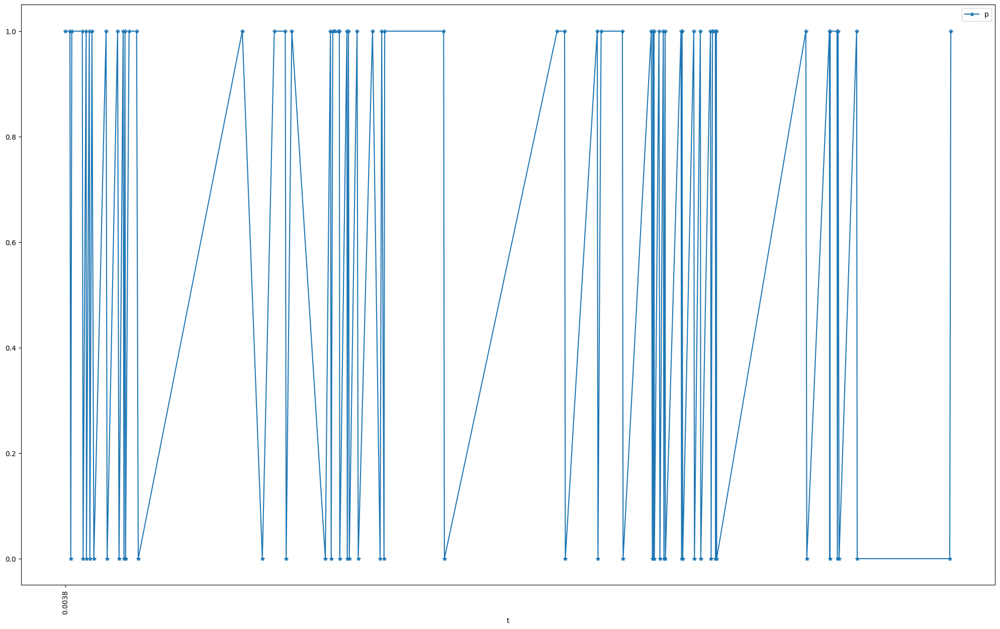

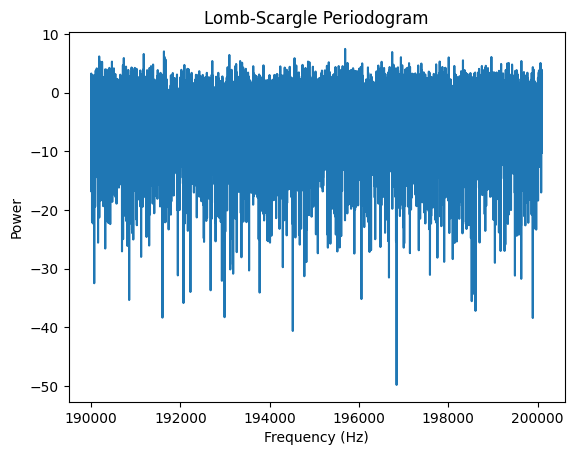

Frequency: 195690.9090909091 Hz, Power: 5.5959677191985255
Frequency: 191632.32323232322 Hz, Power: 5.074176788859283
Frequency: 196744.44444444444 Hz, Power: 4.951558959400299
Frequency: 191179.797979798 Hz, Power: 4.585869658169761
Frequency: 193096.9696969697 Hz, Power: 4.412416193636915
Frequency: 190181.81818181818 Hz, Power: 4.166821987528935
Frequency: 191642.42424242425 Hz, Power: 4.109976817203913
Frequency: 198966.66666666666 Hz, Power: 4.075663910151393
Frequency: 196940.40404040404 Hz, Power: 4.040692987221668
Frequency: 198011.11111111112 Hz, Power: 4.011263473530924
Frequency: 190733.33333333334 Hz, Power: 3.910363268435643
Frequency: 194557.57575757575 Hz, Power: 3.8880452869274347
Frequency: 191669.69696969696 Hz, Power: 3.672418110016758
Frequency: 198330.30303030304 Hz, Power: 3.5785354750918175
Frequency: 193339.39393939395 Hz, Power: 3.4817559128473015
Frequency: 199638.38383838383 Hz, Power: 3.4783007810111077
Frequency: 192715.15151515152 Hz, Power: 3.476348355280

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/200k_laser.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k laser bias

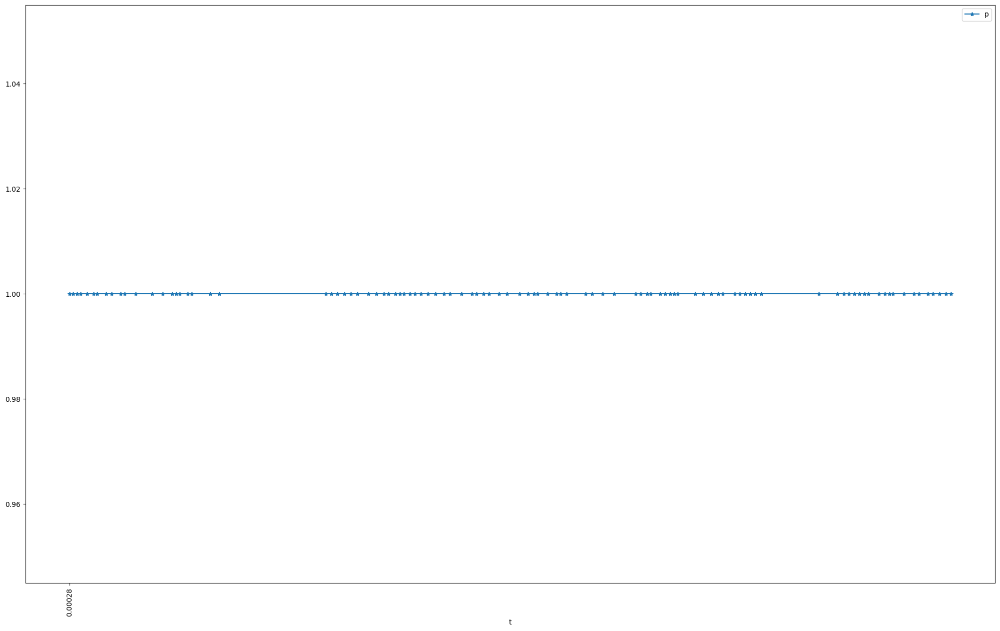

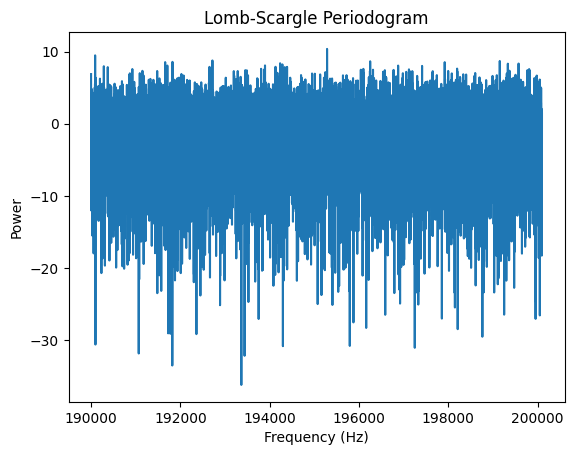

Frequency: 195285.8585858586 Hz, Power: 10.91493143817333
Frequency: 190090.9090909091 Hz, Power: 8.888188965528999
Frequency: 192718.18181818182 Hz, Power: 7.549226381201621
Frequency: 199154.54545454547 Hz, Power: 7.426240417409945
Frequency: 196251.51515151514 Hz, Power: 7.353061089817755
Frequency: 191823.2323232323 Hz, Power: 7.221587251063575
Frequency: 191659.59595959596 Hz, Power: 7.1614724557412615
Frequency: 197921.21212121213 Hz, Power: 7.151207241234264
Frequency: 194234.34343434343 Hz, Power: 6.905921367236315
Frequency: 199575.75757575757 Hz, Power: 6.842064047139276
Frequency: 199335.35353535353 Hz, Power: 6.811950750848354
Frequency: 194284.84848484848 Hz, Power: 6.661342030162921
Frequency: 193895.9595959596 Hz, Power: 6.444393197642296
Frequency: 191708.08080808082 Hz, Power: 6.418519762763276
Frequency: 196877.77777777778 Hz, Power: 6.412982656352074
Frequency: 197414.14141414143 Hz, Power: 6.343291513611701
Frequency: 190285.85858585857 Hz, Power: 6.277249208358813


In [19]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 1000000000
df_chunked = pd.read_csv('csv_data/200k_laser_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500k laser 

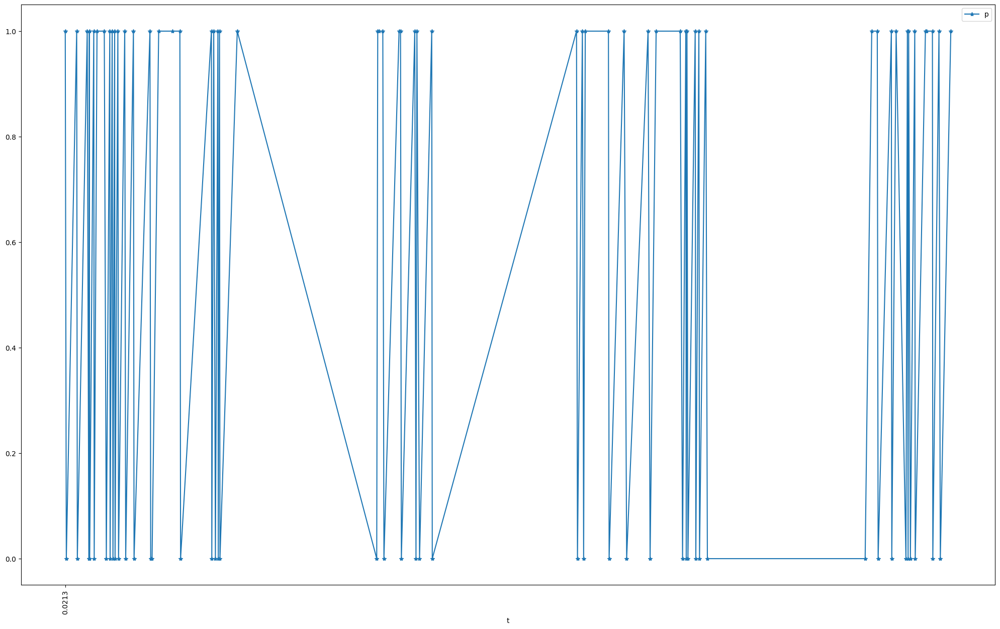

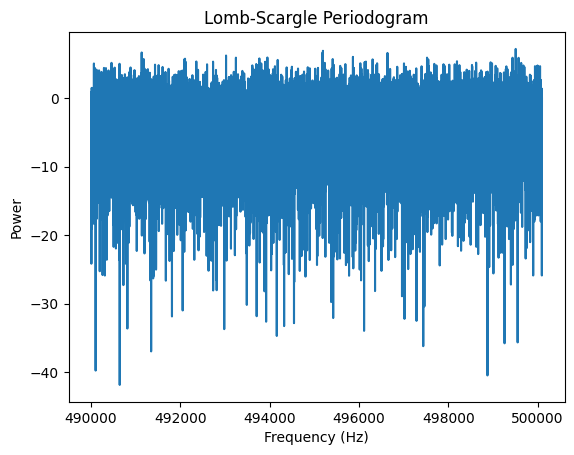

Frequency: 499511.1111111111 Hz, Power: 5.246165957636817
Frequency: 495193.9393939394 Hz, Power: 4.929347964921022
Frequency: 491133.3333333333 Hz, Power: 4.65435195094003
Frequency: 495177.77777777775 Hz, Power: 4.585265741609414
Frequency: 496639.3939393939 Hz, Power: 4.583339776176484
Frequency: 493023.23232323234 Hz, Power: 4.201155420684952
Frequency: 495865.6565656566 Hz, Power: 4.0179548194076995
Frequency: 493949.49494949495 Hz, Power: 3.9320843243678536
Frequency: 497525.2525252525 Hz, Power: 3.912381716771116
Frequency: 493244.44444444444 Hz, Power: 3.9118643196994087
Frequency: 499440.404040404 Hz, Power: 3.9016171696641546
Frequency: 499575.75757575757 Hz, Power: 3.8904565509482754
Frequency: 493769.69696969696 Hz, Power: 3.8099429769155275
Frequency: 492104.0404040404 Hz, Power: 3.774741258245758
Frequency: 491177.77777777775 Hz, Power: 3.7352368414255026
Frequency: 495412.1212121212 Hz, Power: 3.7327142768793795
Frequency: 496306.0606060606 Hz, Power: 3.6921673006174243


In [20]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 1000000000
df_chunked = pd.read_csv('csv_data/500k_laser.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500K laser bias

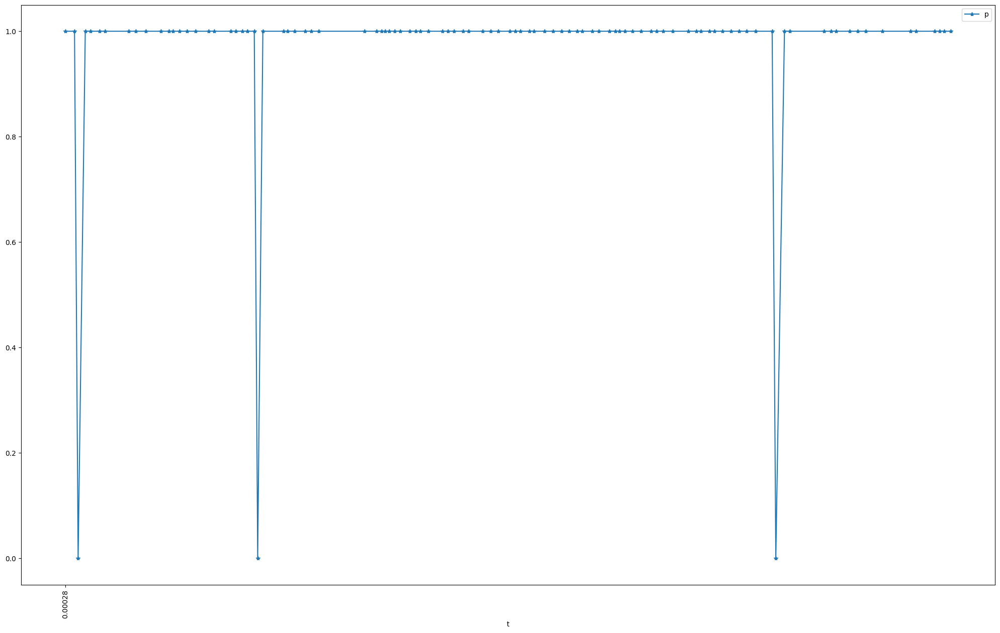

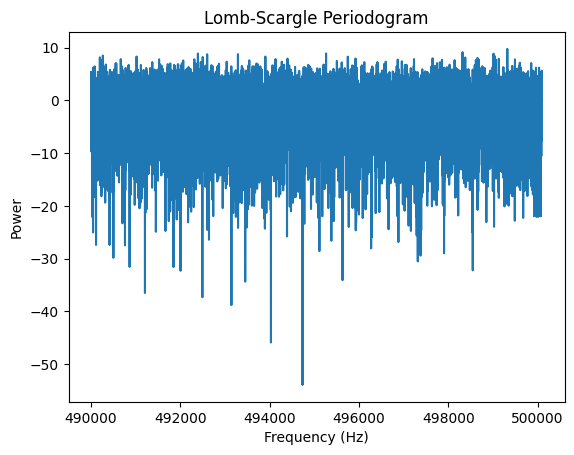

Frequency: 499323.23232323234 Hz, Power: 9.507619271693574
Frequency: 498320.202020202 Hz, Power: 8.236369831321927
Frequency: 495263.63636363635 Hz, Power: 7.833150309784577
Frequency: 492392.9292929293 Hz, Power: 7.781533314906999
Frequency: 499015.1515151515 Hz, Power: 7.735663355962254
Frequency: 493289.89898989897 Hz, Power: 7.562416665950161
Frequency: 492600.0 Hz, Power: 7.536219274022489
Frequency: 490263.63636363635 Hz, Power: 7.1009384452022655
Frequency: 499042.42424242425 Hz, Power: 6.932276076046875
Frequency: 491019.1919191919 Hz, Power: 6.81181757990364
Frequency: 493904.0404040404 Hz, Power: 6.8034824551738335
Frequency: 495750.50505050505 Hz, Power: 6.771443256749102
Frequency: 492501.0101010101 Hz, Power: 6.679678355996534
Frequency: 490196.9696969697 Hz, Power: 6.5712545653438195
Frequency: 498380.8080808081 Hz, Power: 6.532409602765876
Frequency: 498654.54545454547 Hz, Power: 6.415326294969003
Frequency: 497649.49494949495 Hz, Power: 6.314658839804024
Frequency: 495

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/500k_laser_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 60hz dark backscatter Laser

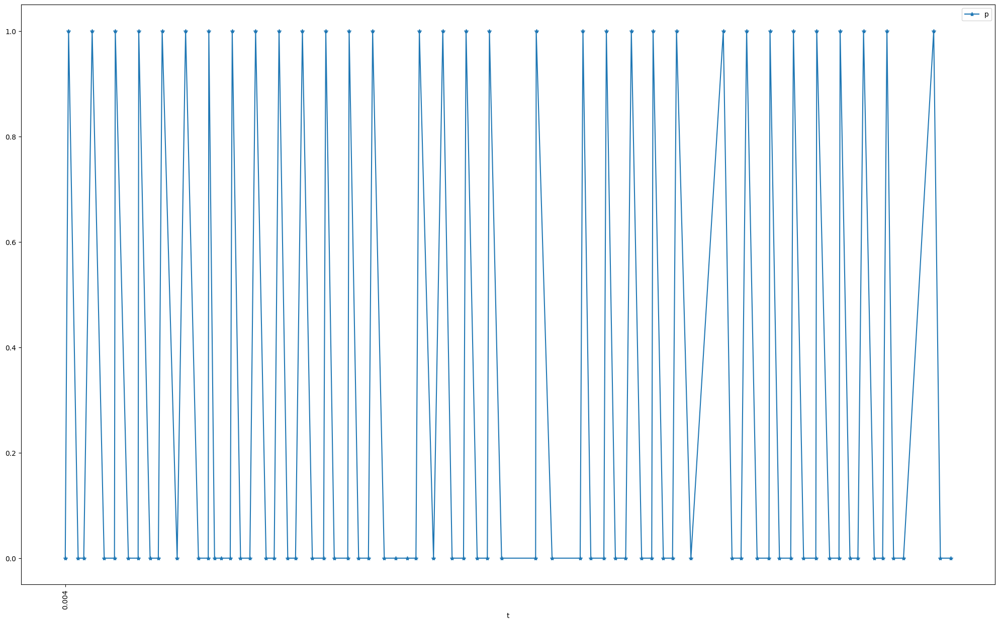

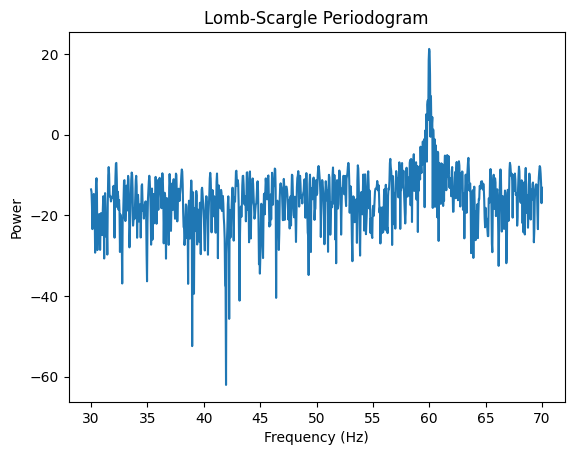

Frequency: 59.98998998998999 Hz, Power: 133.0160158509227
Frequency: 60.150150150150154 Hz, Power: 8.95437304826822
Frequency: 59.86986986986987 Hz, Power: 7.02110560352973
Frequency: 59.74974974974975 Hz, Power: 3.230453327596299
Frequency: 60.270270270270274 Hz, Power: 2.7087296461613284
Frequency: 60.350350350350354 Hz, Power: 1.3293982689736243
Frequency: 59.62962962962963 Hz, Power: 1.256071705031601
Frequency: 60.470470470470474 Hz, Power: 0.7717844644077214
Frequency: 59.54954954954955 Hz, Power: 0.7671236978735669
Frequency: 59.42942942942943 Hz, Power: 0.6720414513557342
Frequency: 60.550550550550554 Hz, Power: 0.5519029260953757
Frequency: 59.22922922922923 Hz, Power: 0.4995238780304064
Frequency: 60.750750750750754 Hz, Power: 0.3740690255494017
Frequency: 58.62862862862863 Hz, Power: 0.32582659504839234
Frequency: 61.591591591591595 Hz, Power: 0.3099055394463089
Frequency: 59.34934934934935 Hz, Power: 0.3092775696888527
Frequency: 60.670670670670674 Hz, Power: 0.302654604855

In [23]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/60hz_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(30, 70, 1000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 60hz backscatter bias

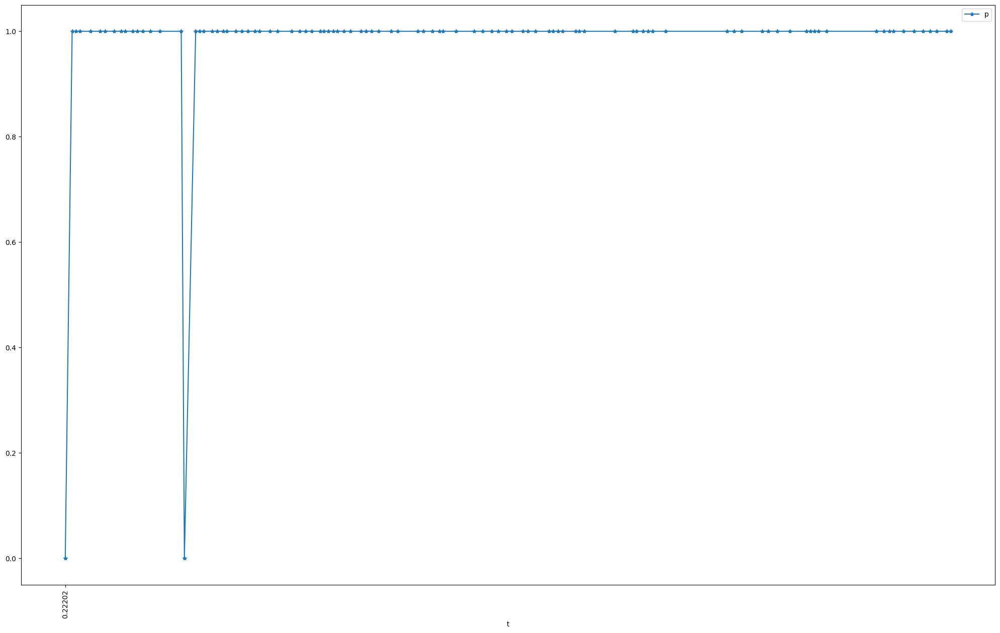

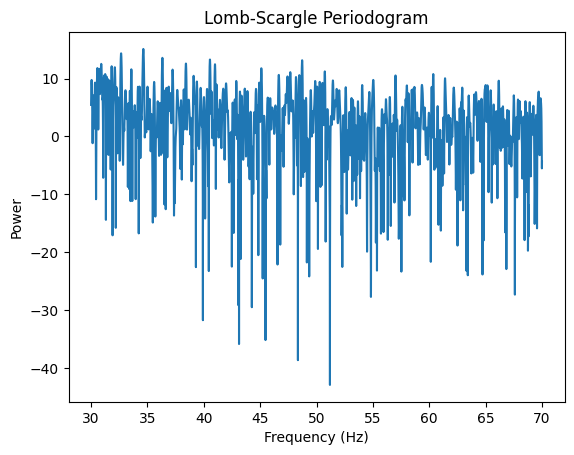

Frequency: 34.63646364636464 Hz, Power: 32.57223522255199
Frequency: 32.66426642664266 Hz, Power: 27.334588557157105
Frequency: 36.324632463246324 Hz, Power: 22.840038753117287
Frequency: 40.545054505450544 Hz, Power: 21.364351852348314
Frequency: 48.72187218721872 Hz, Power: 20.733844474772734
Frequency: 38.41284128412841 Hz, Power: 18.190960869467737
Frequency: 30.904090409040904 Hz, Power: 17.965038666895182
Frequency: 40.993099309931 Hz, Power: 17.665744569805724
Frequency: 31.824182418241826 Hz, Power: 16.337922252795817
Frequency: 32.10821082108211 Hz, Power: 15.690181630921927
Frequency: 30.56005600560056 Hz, Power: 15.197215194089537
Frequency: 45.101510151015106 Hz, Power: 15.076673753851399
Frequency: 30.70807080708071 Hz, Power: 14.711527603193774
Frequency: 33.57235723572357 Hz, Power: 14.471080147657233
Frequency: 37.22872287228723 Hz, Power: 14.29859665139826
Frequency: 50.73407340734073 Hz, Power: 13.305475699280437
Frequency: 47.67376737673767 Hz, Power: 12.899403161079

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/60hz_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(30, 70, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 60hz ambient backscatter

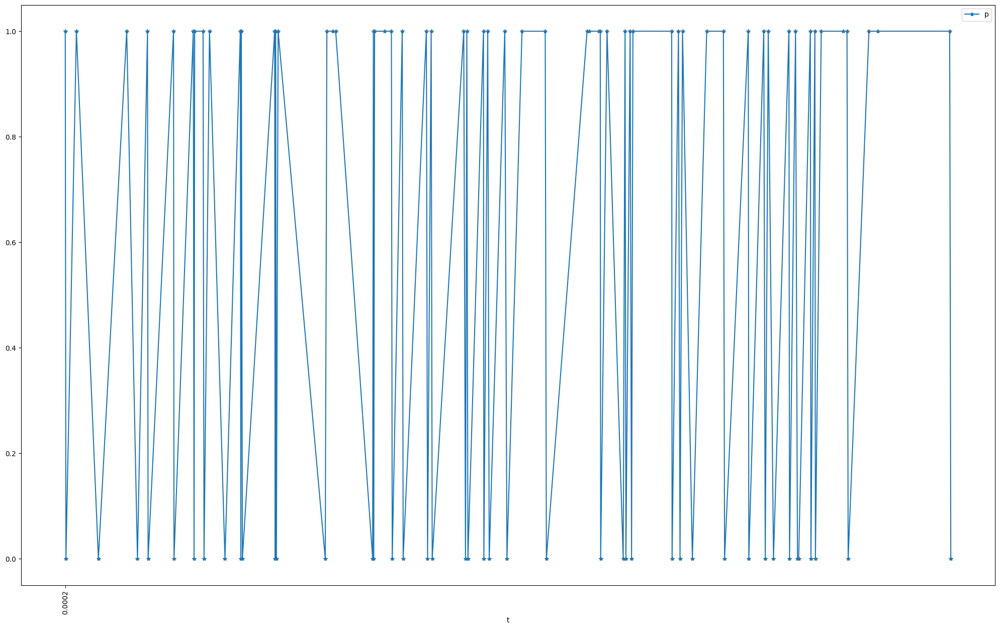

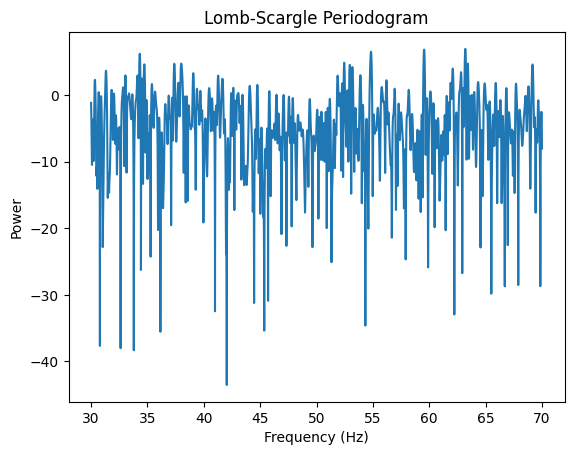

Frequency: 63.1993199319932 Hz, Power: 4.923834044224932
Frequency: 59.54295429542954 Hz, Power: 4.813147292949338
Frequency: 54.83048304830483 Hz, Power: 4.474849511603069
Frequency: 34.316431643164314 Hz, Power: 4.164484307372043
Frequency: 52.45424542454245 Hz, Power: 3.0526556443251103
Frequency: 63.41534153415341 Hz, Power: 2.973366351819959
Frequency: 37.996799679968 Hz, Power: 2.9658269503849284
Frequency: 37.38073807380738 Hz, Power: 2.9502536249303937
Frequency: 34.72047204720472 Hz, Power: 2.8877155011844207
Frequency: 69.16391639163916 Hz, Power: 2.8723490153921953
Frequency: 52.95029502950295 Hz, Power: 2.831261949538079
Frequency: 53.178317831783176 Hz, Power: 2.628101680929041
Frequency: 62.083208320832085 Hz, Power: 2.494665057774939
Frequency: 31.324132413241323 Hz, Power: 2.3174819518483654
Frequency: 62.81928192819282 Hz, Power: 2.2013400911999543
Frequency: 39.06890689068907 Hz, Power: 2.1292950072692687
Frequency: 53.89438943894389 Hz, Power: 1.9835442083197248
Freq

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/60hz_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(30, 70, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100hz dark backscatter

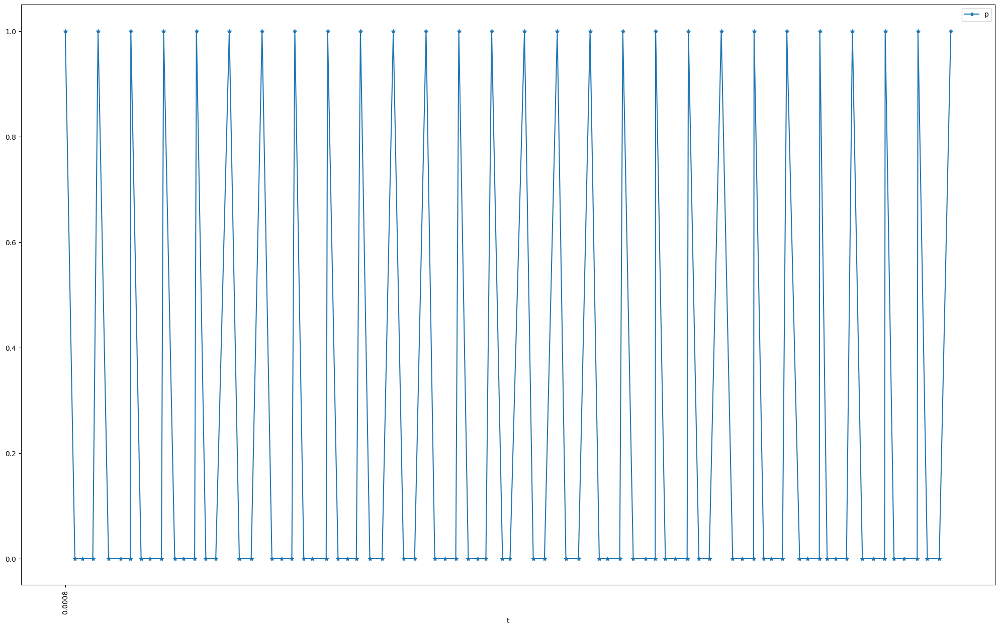

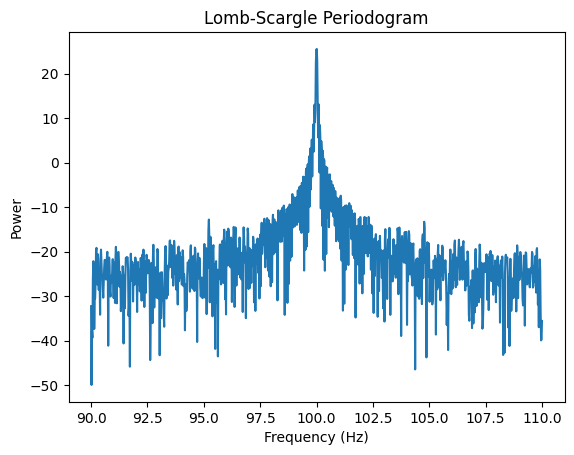

Frequency: 100.01001001001 Hz, Power: 358.34126519114614
Frequency: 100.09009009009009 Hz, Power: 20.523098621195338
Frequency: 99.90990990990991 Hz, Power: 20.007306202825088
Frequency: 99.84984984984985 Hz, Power: 7.200684702256111
Frequency: 100.15015015015015 Hz, Power: 6.966922483519971
Frequency: 99.7897897897898 Hz, Power: 3.274110512705101
Frequency: 100.2102102102102 Hz, Power: 3.0540302980390415
Frequency: 99.72972972972973 Hz, Power: 2.0885168711289817
Frequency: 100.27027027027027 Hz, Power: 1.8710525563939566
Frequency: 99.66966966966967 Hz, Power: 1.3831582551614818
Frequency: 100.33033033033033 Hz, Power: 1.20142795318448
Frequency: 99.6096096096096 Hz, Power: 0.9143584859739753
Frequency: 100.4104104104104 Hz, Power: 0.8126359042071418
Frequency: 100.47047047047047 Hz, Power: 0.7706256905496511
Frequency: 99.54954954954955 Hz, Power: 0.7370731286682194
Frequency: 100.5905905905906 Hz, Power: 0.5452821057708345
Frequency: 100.53053053053053 Hz, Power: 0.5339183434920254


In [29]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100hz_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90, 110, 1000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100hz dark backscatter bias

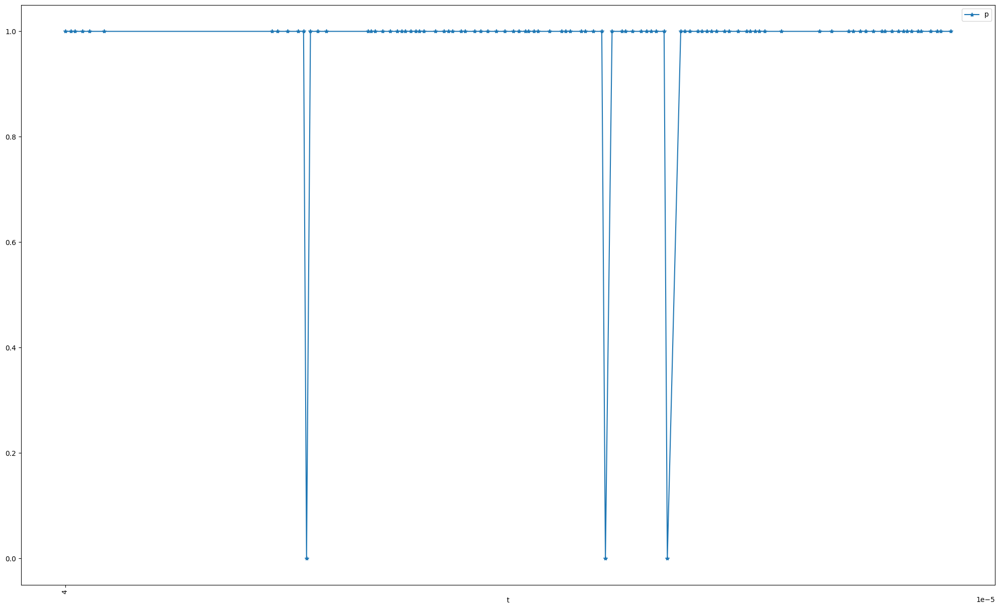

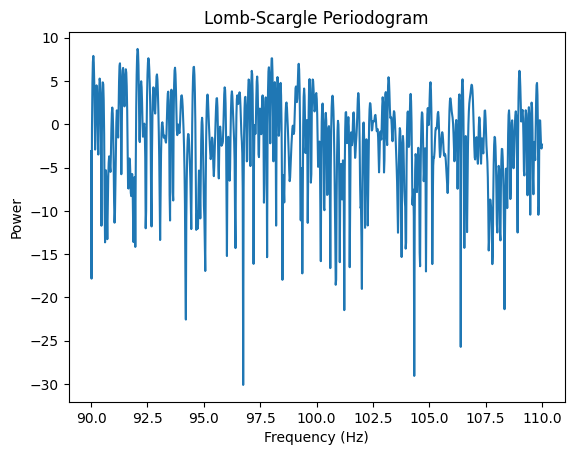

Frequency: 92.06206206206207 Hz, Power: 7.428664175788217
Frequency: 90.10010010010011 Hz, Power: 6.16778207785636
Frequency: 92.54254254254255 Hz, Power: 5.795014874247461
Frequency: 98.02802802802803 Hz, Power: 5.787178381996228
Frequency: 91.28128128128128 Hz, Power: 5.064746349377275
Frequency: 99.2092092092092 Hz, Power: 5.001450583408156
Frequency: 94.56456456456456 Hz, Power: 4.614308522439693
Frequency: 97.88788788788789 Hz, Power: 4.555635089454536
Frequency: 93.72372372372372 Hz, Power: 4.5070879797359495
Frequency: 91.42142142142143 Hz, Power: 4.482285223232733
Frequency: 91.54154154154155 Hz, Power: 4.324641108924801
Frequency: 108.998998998999 Hz, Power: 4.1492331565481395
Frequency: 97.12712712712712 Hz, Power: 4.144145596312219
Frequency: 92.92292292292292 Hz, Power: 3.770179682106827
Frequency: 97.36736736736736 Hz, Power: 3.5646241050414034
Frequency: 98.26826826826827 Hz, Power: 3.512660994687218
Frequency: 103.1931931931932 Hz, Power: 3.4972870858749077
Frequency: 90

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100hz_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90, 110, 1000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100 hz ambient backscatter

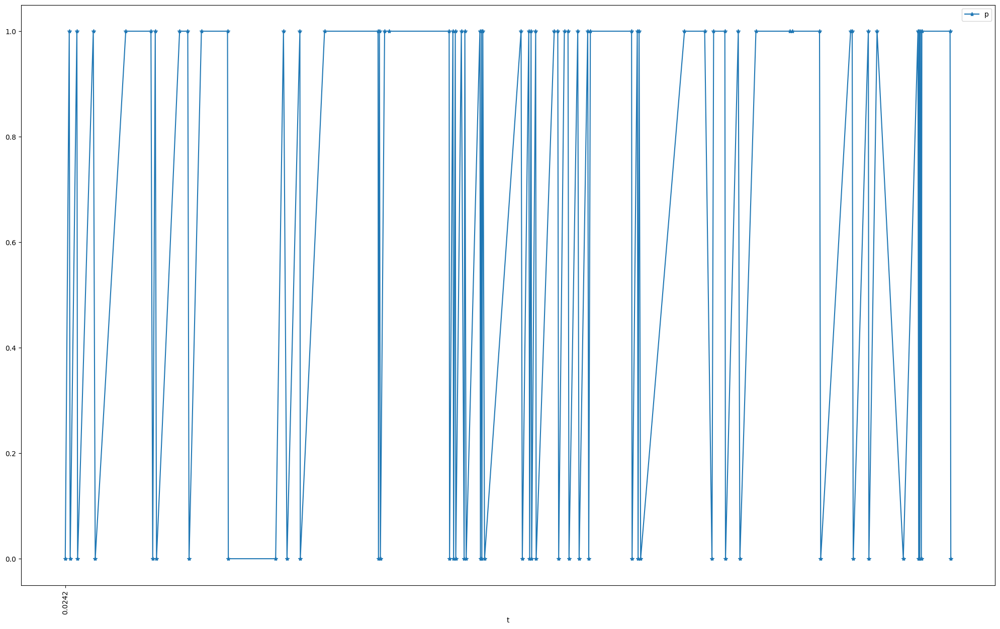

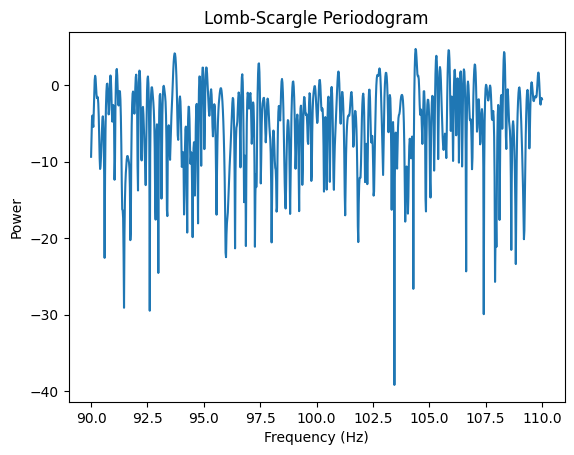

Frequency: 104.3943943943944 Hz, Power: 2.9869974452983787
Frequency: 105.85585585585585 Hz, Power: 2.875181856226584
Frequency: 108.31831831831832 Hz, Power: 2.7197773652787243
Frequency: 93.70370370370371 Hz, Power: 2.612522466015275
Frequency: 105.31531531531532 Hz, Power: 2.4273987534089296
Frequency: 97.44744744744744 Hz, Power: 1.9352023313393893
Frequency: 107.01701701701703 Hz, Power: 1.8713768310500938
Frequency: 105.47547547547548 Hz, Power: 1.7293157184274959
Frequency: 95.10510510510511 Hz, Power: 1.7100487249117065
Frequency: 94.96496496496496 Hz, Power: 1.70043509017543
Frequency: 102.7927927927928 Hz, Power: 1.6621692338688667
Frequency: 91.14114114114115 Hz, Power: 1.6326295507133297
Frequency: 106.53653653653654 Hz, Power: 1.61313816630577
Frequency: 106.13613613613614 Hz, Power: 1.5958604075662324
Frequency: 92.14214214214215 Hz, Power: 1.556888947297348
Frequency: 106.3963963963964 Hz, Power: 1.5184407166602312
Frequency: 100.97097097097097 Hz, Power: 1.5117944278225

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100hz_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90, 110, 1000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 1k dark backscatter

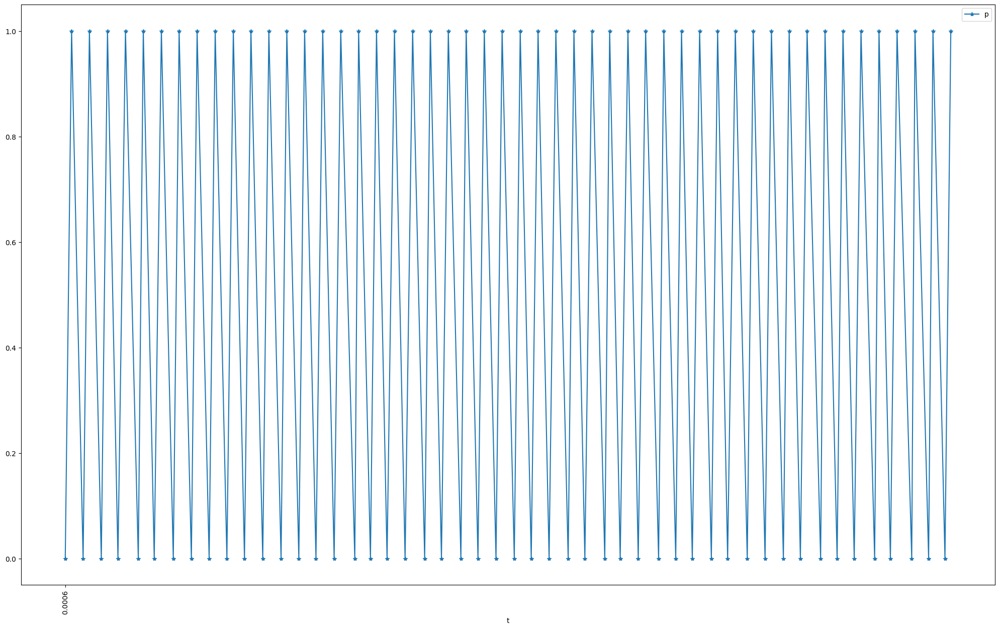

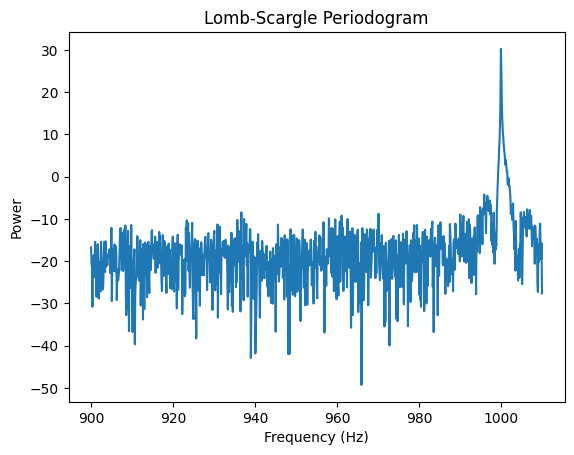

Frequency: 999.97997997998 Hz, Power: 1055.6792634754872
Frequency: 1001.1911911911911 Hz, Power: 2.4882428307427067
Frequency: 1001.8518518518518 Hz, Power: 0.9158490599897997
Frequency: 1002.072072072072 Hz, Power: 0.6170261987511355
Frequency: 995.9059059059059 Hz, Power: 0.38060833650539333
Frequency: 996.6766766766767 Hz, Power: 0.35275013280401285
Frequency: 997.2272272272272 Hz, Power: 0.2758035536821512
Frequency: 996.4564564564564 Hz, Power: 0.23723490344755674
Frequency: 1002.952952952953 Hz, Power: 0.23277712259048178
Frequency: 996.8968968968969 Hz, Power: 0.22494163673042744
Frequency: 997.5575575575575 Hz, Power: 0.2085304816500884
Frequency: 994.9149149149149 Hz, Power: 0.19047288562919232
Frequency: 1002.5125125125126 Hz, Power: 0.1859555836903687
Frequency: 995.5755755755756 Hz, Power: 0.1769403638665178
Frequency: 1006.3663663663664 Hz, Power: 0.16901921844131498
Frequency: 1007.0270270270271 Hz, Power: 0.16336346341820246
Frequency: 995.2452452452452 Hz, Power: 0.155

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 1010, 1000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 1k dark backscatter bias

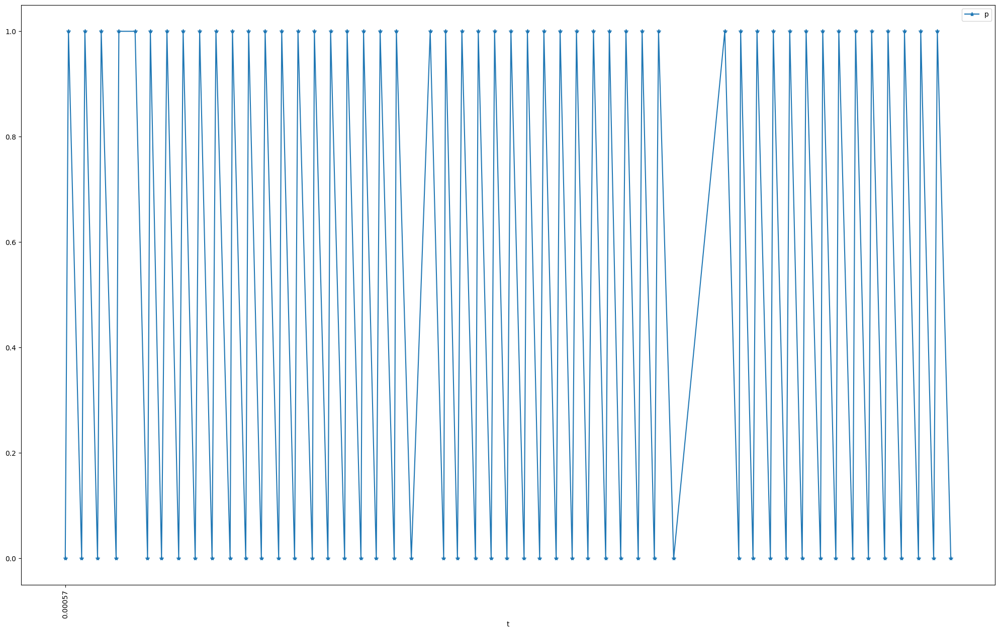

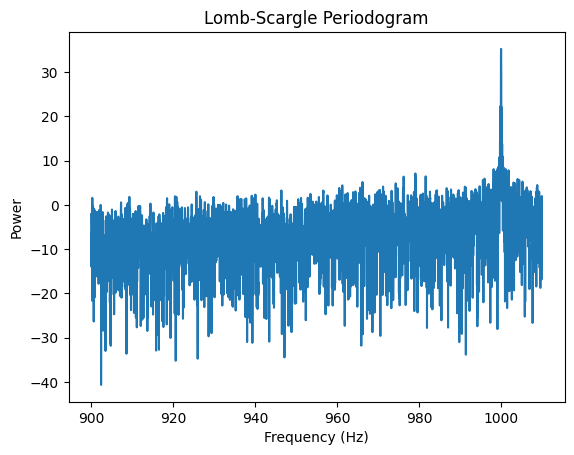

Frequency: 1000.0220022002201 Hz, Power: 3303.7548783270527
Frequency: 999.9119911991199 Hz, Power: 171.14628195769598
Frequency: 1000.1320132013201 Hz, Power: 160.72038482582442
Frequency: 999.8349834983499 Hz, Power: 72.0257693533027
Frequency: 1000.2090209020902 Hz, Power: 70.1673951144557
Frequency: 999.7579757975798 Hz, Power: 25.401190158860654
Frequency: 1000.2750275027503 Hz, Power: 23.41826731899486
Frequency: 1000.3520352035204 Hz, Power: 12.372767844131598
Frequency: 999.6919691969197 Hz, Power: 11.943328886793195
Frequency: 999.6149614961496 Hz, Power: 11.753971265428095
Frequency: 1000.4290429042904 Hz, Power: 11.729738509364807
Frequency: 999.3949394939494 Hz, Power: 7.280310036841941
Frequency: 1000.5720572057206 Hz, Power: 6.982485110763656
Frequency: 1000.6490649064906 Hz, Power: 6.698566084806832
Frequency: 999.1749174917492 Hz, Power: 6.519069387787072
Frequency: 999.5379537953795 Hz, Power: 6.517072526483007
Frequency: 999.4719471947195 Hz, Power: 6.456322269708948


In [34]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 1010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 1k ambient backscatter

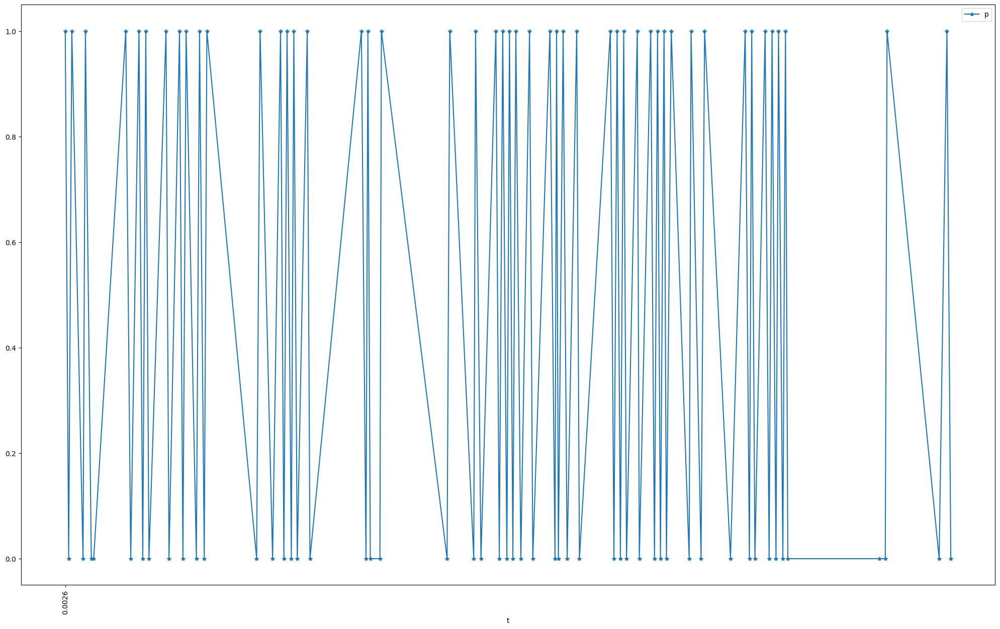

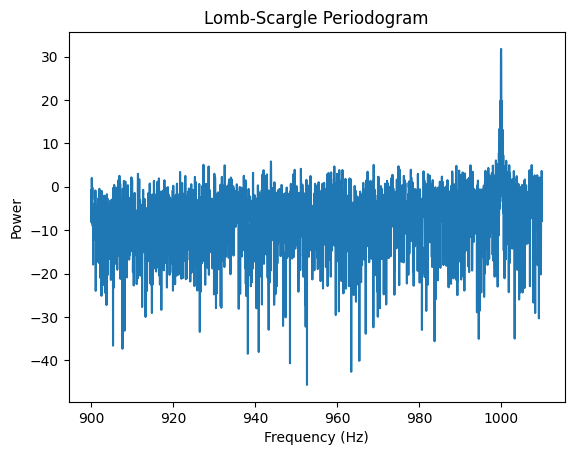

Frequency: 1000.0220022002201 Hz, Power: 1498.2639573771453
Frequency: 999.90099009901 Hz, Power: 96.61139053061625
Frequency: 1000.1430143014302 Hz, Power: 95.5193941882583
Frequency: 1000.2200220022003 Hz, Power: 50.594234004426184
Frequency: 999.8129812981298 Hz, Power: 49.49820686149529
Frequency: 999.6479647964796 Hz, Power: 21.656832787493165
Frequency: 1000.3850385038504 Hz, Power: 20.61097818488066
Frequency: 1000.3080308030803 Hz, Power: 13.562665361589575
Frequency: 999.7359735973597 Hz, Power: 11.133899879791135
Frequency: 999.4829482948295 Hz, Power: 6.016359301085707
Frequency: 1000.5500550055006 Hz, Power: 5.312518617871384
Frequency: 998.7568756875687 Hz, Power: 4.03862007455051
Frequency: 1001.2761276127612 Hz, Power: 3.9660190757338762
Frequency: 943.8833883388339 Hz, Power: 3.822773181658393
Frequency: 1000.4730473047305 Hz, Power: 3.768081380584707
Frequency: 999.0759075907591 Hz, Power: 3.302488424145271
Frequency: 927.4147414741474 Hz, Power: 3.2072656813939693
Fre

In [35]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 1010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 1k ambient backscatter bias

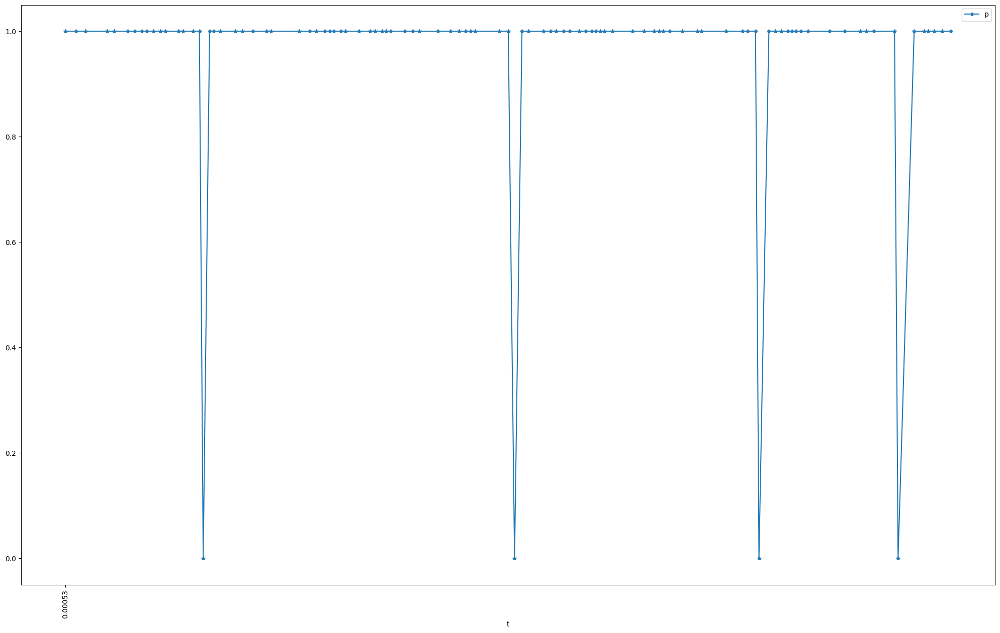

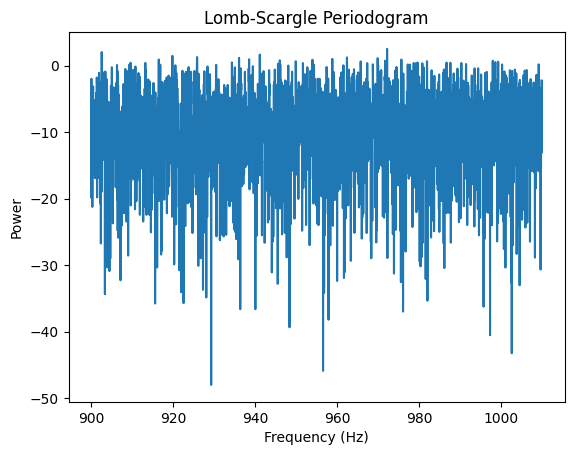

Frequency: 972.2112211221122 Hz, Power: 1.78623448979243
Frequency: 902.5962596259626 Hz, Power: 1.601534490747735
Frequency: 941.1551155115511 Hz, Power: 1.4668026455776288
Frequency: 919.8349834983499 Hz, Power: 1.4077584577005198
Frequency: 925.8525852585259 Hz, Power: 1.3474806686885388
Frequency: 962.4202420242025 Hz, Power: 1.3314751761765289
Frequency: 936.0946094609461 Hz, Power: 1.3104559154836675
Frequency: 969.9119911991199 Hz, Power: 1.2956683436433214
Frequency: 958.8448844884489 Hz, Power: 1.2647167241421886
Frequency: 938.5478547854785 Hz, Power: 1.2494917012821467
Frequency: 916.5126512651265 Hz, Power: 1.2357834944427284
Frequency: 975.6985698569857 Hz, Power: 1.235427737822913
Frequency: 954.004400440044 Hz, Power: 1.2266978548045335
Frequency: 946.039603960396 Hz, Power: 1.2046060743463487
Frequency: 971.7381738173817 Hz, Power: 1.1875424439735285
Frequency: 997.986798679868 Hz, Power: 1.1858812787787816
Frequency: 981.947194719472 Hz, Power: 1.1696415245932639
Frequ

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/1k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(900, 1010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 5k dark backscatter

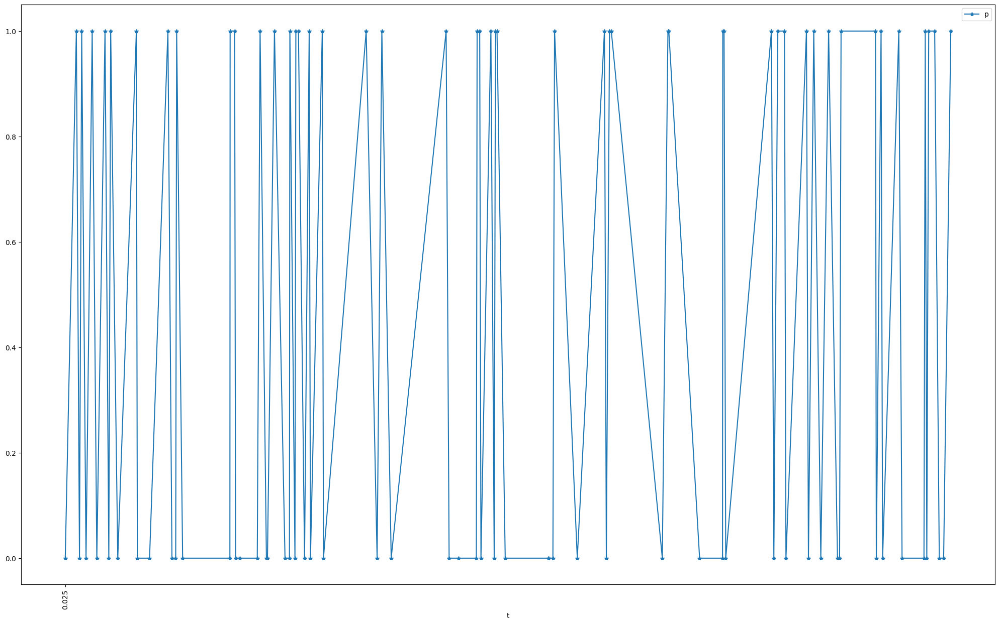

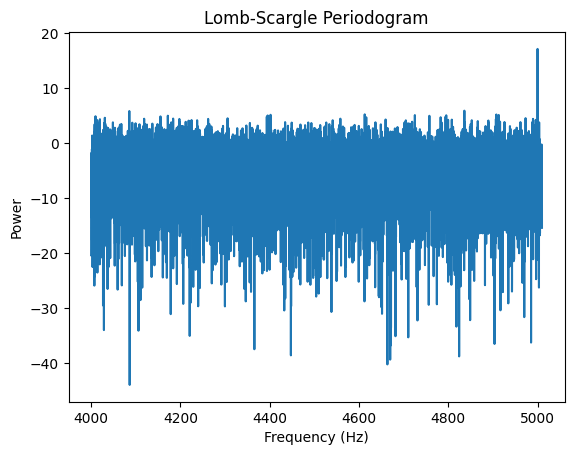

Frequency: 5000.10101010101 Hz, Power: 51.47629662085486
Frequency: 4836.161616161617 Hz, Power: 3.8907128783092215
Frequency: 4085.656565656566 Hz, Power: 3.834026960811558
Frequency: 4612.929292929293 Hz, Power: 3.335723989546954
Frequency: 4907.777777777777 Hz, Power: 3.317475915763696
Frequency: 4402.020202020202 Hz, Power: 3.2756545843084792
Frequency: 4913.131313131313 Hz, Power: 3.250590817375924
Frequency: 4725.252525252526 Hz, Power: 3.234419413445392
Frequency: 4795.555555555556 Hz, Power: 3.2080405626631223
Frequency: 4395.555555555556 Hz, Power: 3.1847497117108703
Frequency: 4171.919191919192 Hz, Power: 3.1532659315157456
Frequency: 4757.777777777777 Hz, Power: 3.142209920534167
Frequency: 4009.89898989899 Hz, Power: 3.0829151694784453
Frequency: 4155.454545454545 Hz, Power: 3.063547444092225
Frequency: 4794.040404040404 Hz, Power: 3.0334477967424185
Frequency: 4393.636363636364 Hz, Power: 3.02384422149242
Frequency: 4783.030303030303 Hz, Power: 2.95628870514019
Frequency: 

In [37]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/5k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(4000, 5010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 5k dark backscatter bias

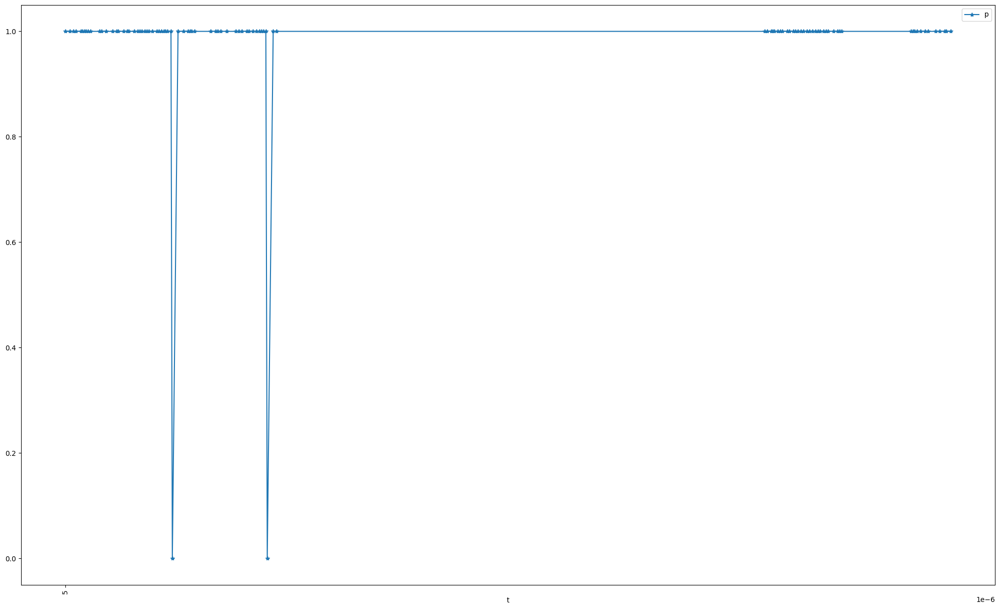

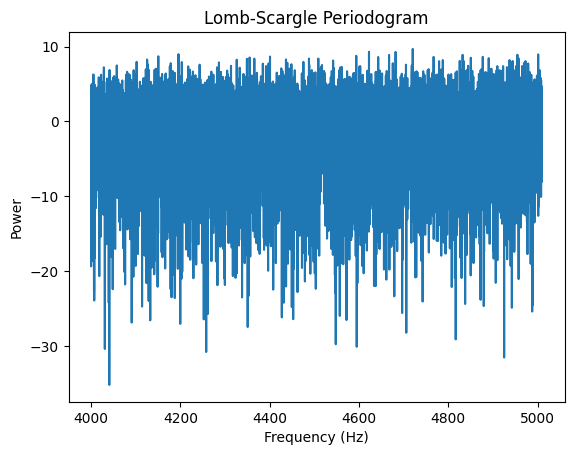

Frequency: 4720.50505050505 Hz, Power: 9.305447280370629
Frequency: 4622.525252525253 Hz, Power: 8.524033802440554
Frequency: 4682.121212121212 Hz, Power: 8.484957062989118
Frequency: 4195.757575757576 Hz, Power: 7.923376458909007
Frequency: 5001.515151515152 Hz, Power: 7.862192266735436
Frequency: 4954.949494949495 Hz, Power: 7.779528700730514
Frequency: 4832.222222222223 Hz, Power: 7.7604886674266105
Frequency: 4667.474747474747 Hz, Power: 7.738139252679253
Frequency: 4594.040404040404 Hz, Power: 7.533111923422229
Frequency: 4150.606060606061 Hz, Power: 7.427205375284626
Frequency: 4400.80808080808 Hz, Power: 7.357300257437146
Frequency: 4877.373737373738 Hz, Power: 7.298871412057865
Frequency: 4767.272727272727 Hz, Power: 7.285044837208137
Frequency: 4643.131313131313 Hz, Power: 7.258239335414428
Frequency: 4355.050505050505 Hz, Power: 7.149119846164439
Frequency: 4850.606060606061 Hz, Power: 7.092772863759274
Frequency: 4957.171717171717 Hz, Power: 7.020642119994427
Frequency: 4890

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/5k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(4000, 5010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 5k ambient backscatter

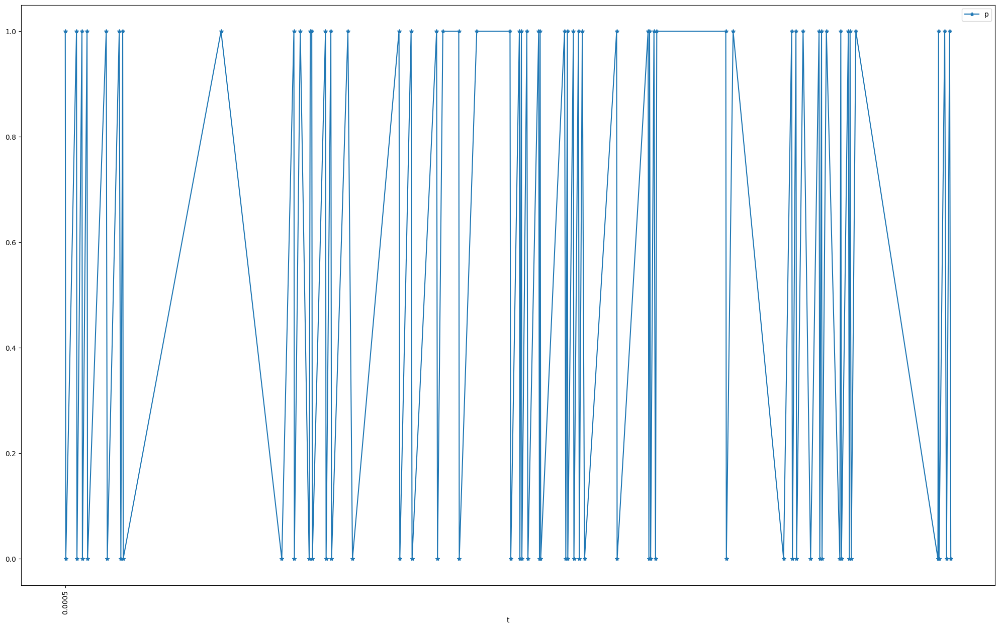

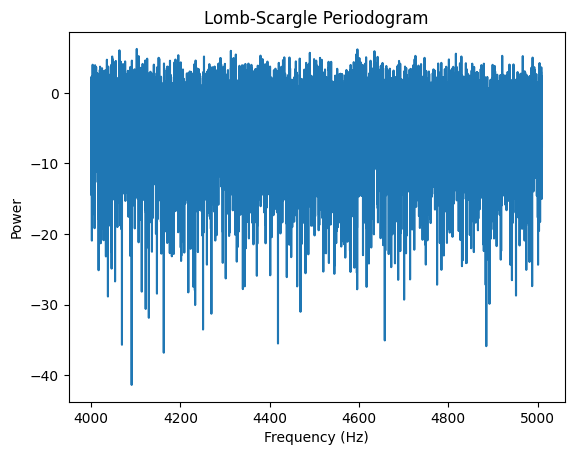

Frequency: 4102.323232323232 Hz, Power: 4.212265857983413
Frequency: 4596.565656565656 Hz, Power: 4.150626883621067
Frequency: 4063.5353535353534 Hz, Power: 4.024391334033606
Frequency: 4313.131313131313 Hz, Power: 3.9595636648741275
Frequency: 4634.747474747474 Hz, Power: 3.907090512173963
Frequency: 4490.0 Hz, Power: 3.711154452032774
Frequency: 4817.171717171717 Hz, Power: 3.6047593690950506
Frequency: 4593.838383838383 Hz, Power: 3.513613105676651
Frequency: 4324.242424242424 Hz, Power: 3.509533153550787
Frequency: 4195.353535353535 Hz, Power: 3.4321965819828737
Frequency: 4379.49494949495 Hz, Power: 3.3843000410516058
Frequency: 4920.909090909091 Hz, Power: 3.363765555118769
Frequency: 4726.565656565656 Hz, Power: 3.3583855606036837
Frequency: 4106.565656565656 Hz, Power: 3.3316992681678044
Frequency: 4966.969696969697 Hz, Power: 3.3315832415466864
Frequency: 4829.49494949495 Hz, Power: 3.2905738956609896
Frequency: 4047.2727272727275 Hz, Power: 3.288273255948697
Frequency: 4252.9

In [39]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/5k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(4000, 5010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 5k ambient backscatter bias

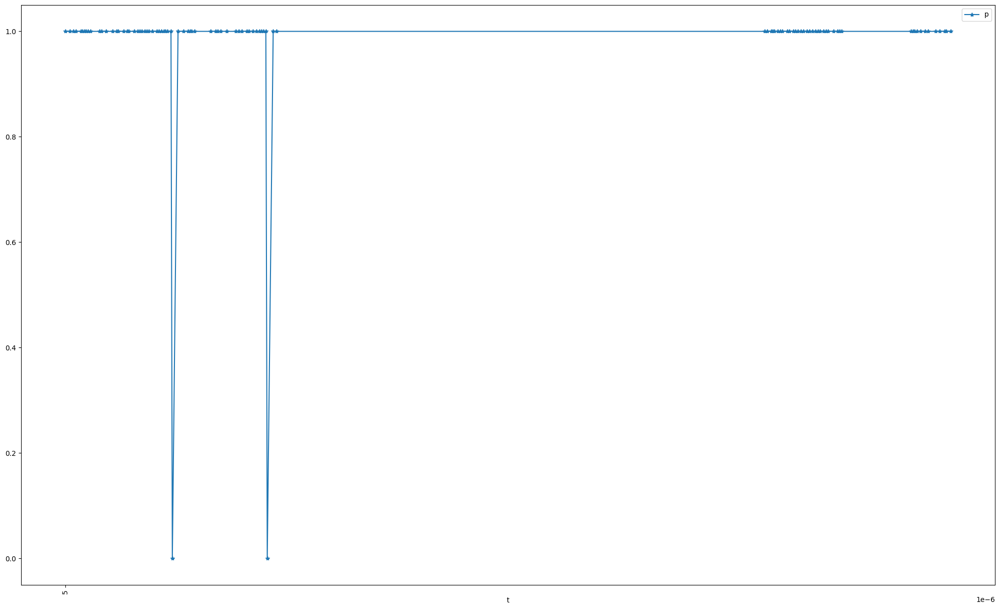

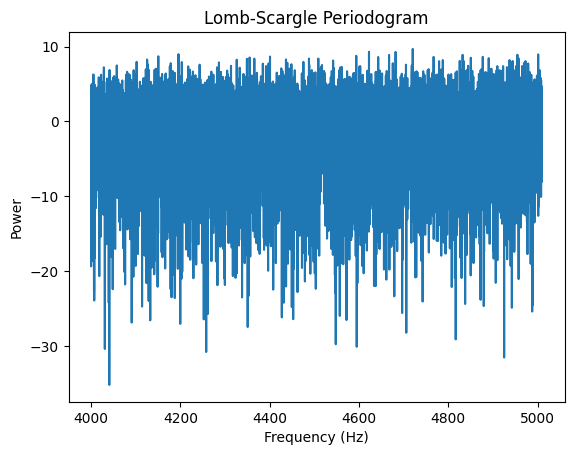

Frequency: 4720.50505050505 Hz, Power: 9.305447280370629
Frequency: 4622.525252525253 Hz, Power: 8.524033802440554
Frequency: 4682.121212121212 Hz, Power: 8.484957062989118
Frequency: 4195.757575757576 Hz, Power: 7.923376458909007
Frequency: 5001.515151515152 Hz, Power: 7.862192266735436
Frequency: 4954.949494949495 Hz, Power: 7.779528700730514
Frequency: 4832.222222222223 Hz, Power: 7.7604886674266105
Frequency: 4667.474747474747 Hz, Power: 7.738139252679253
Frequency: 4594.040404040404 Hz, Power: 7.533111923422229
Frequency: 4150.606060606061 Hz, Power: 7.427205375284626
Frequency: 4400.80808080808 Hz, Power: 7.357300257437146
Frequency: 4877.373737373738 Hz, Power: 7.298871412057865
Frequency: 4767.272727272727 Hz, Power: 7.285044837208137
Frequency: 4643.131313131313 Hz, Power: 7.258239335414428
Frequency: 4355.050505050505 Hz, Power: 7.149119846164439
Frequency: 4850.606060606061 Hz, Power: 7.092772863759274
Frequency: 4957.171717171717 Hz, Power: 7.020642119994427
Frequency: 4890

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/5k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(4000, 5010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 10k dark backscatter

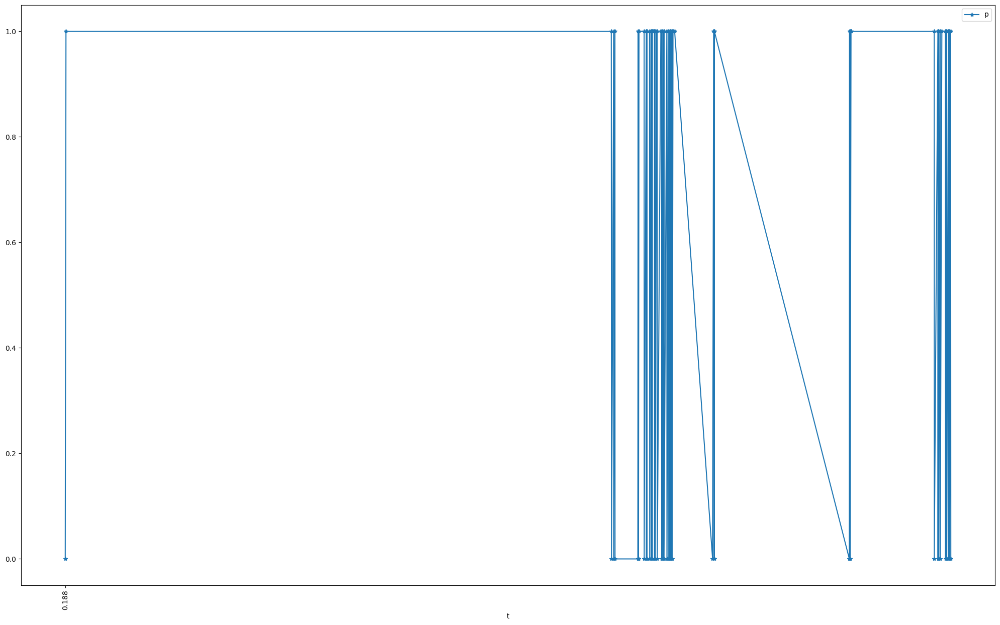

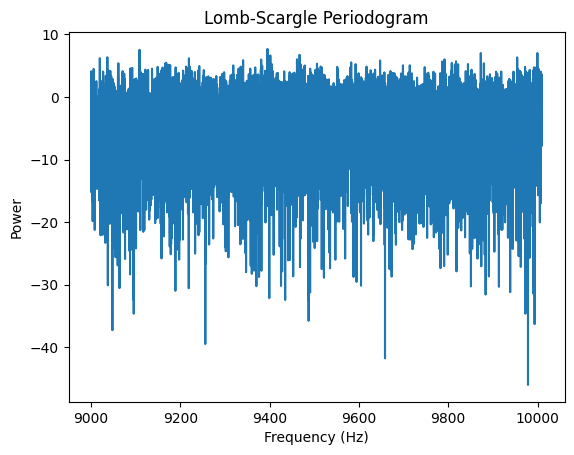

Frequency: 9395.151515151516 Hz, Power: 5.879753631389928
Frequency: 9108.484848484848 Hz, Power: 5.697026939567134
Frequency: 9999.69696969697 Hz, Power: 5.062157901579642
Frequency: 9872.929292929293 Hz, Power: 5.055493724065298
Frequency: 9467.070707070707 Hz, Power: 4.738180723305209
Frequency: 9401.515151515152 Hz, Power: 4.621438386204869
Frequency: 9036.464646464647 Hz, Power: 4.3318331146793545
Frequency: 9954.444444444445 Hz, Power: 4.301612244647835
Frequency: 9019.59595959596 Hz, Power: 4.1814825834751055
Frequency: 9219.191919191919 Hz, Power: 4.165663060412614
Frequency: 9461.212121212122 Hz, Power: 4.015467123244919
Frequency: 9791.61616161616 Hz, Power: 4.005075959137755
Frequency: 9381.0101010101 Hz, Power: 3.9793492653058724
Frequency: 9340.505050505051 Hz, Power: 3.88838151874862
Frequency: 9647.373737373737 Hz, Power: 3.8441531298977187
Frequency: 9817.474747474747 Hz, Power: 3.735743604385631
Frequency: 9786.363636363636 Hz, Power: 3.6951661393994226
Frequency: 9582

In [41]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/10k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(9000, 10010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 10k dark backscatter bias

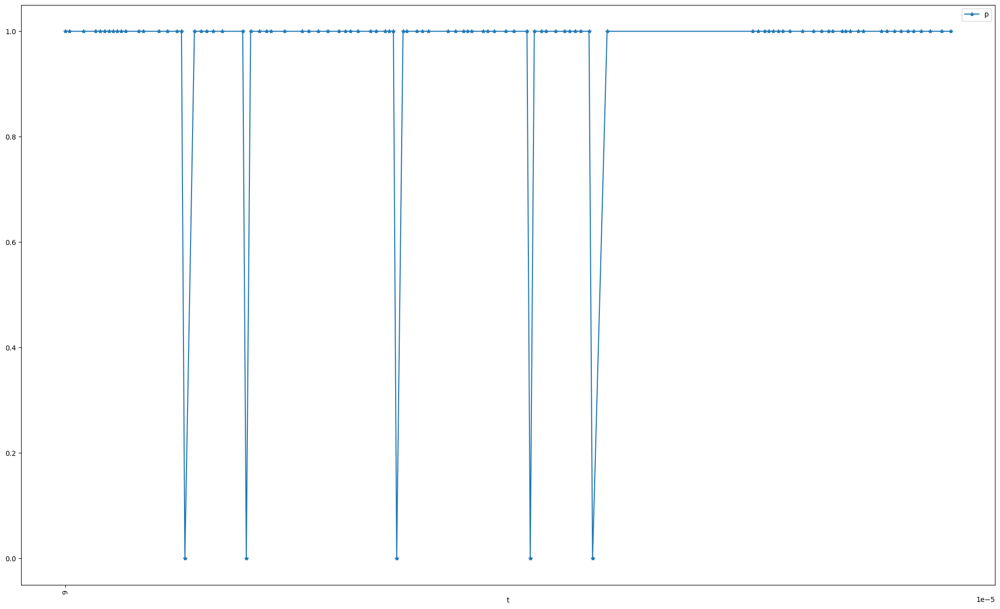

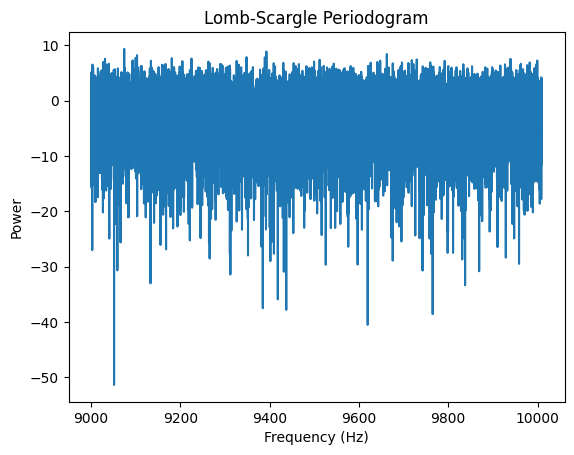

Frequency: 9074.242424242424 Hz, Power: 8.586117475436122
Frequency: 9392.626262626263 Hz, Power: 7.703579132616025
Frequency: 9662.525252525253 Hz, Power: 6.92707026027133
Frequency: 9102.929292929293 Hz, Power: 6.615734487804092
Frequency: 9348.181818181818 Hz, Power: 6.092340451391786
Frequency: 9389.191919191919 Hz, Power: 6.062097589909548
Frequency: 9099.89898989899 Hz, Power: 5.938541819576868
Frequency: 9180.808080808081 Hz, Power: 5.854885819638124
Frequency: 9224.848484848484 Hz, Power: 5.7450916191627535
Frequency: 9031.212121212122 Hz, Power: 5.6874135973303135
Frequency: 9939.39393939394 Hz, Power: 5.680724312391761
Frequency: 9729.494949494949 Hz, Power: 5.542129234665257
Frequency: 9511.919191919193 Hz, Power: 5.479699384331886
Frequency: 9718.383838383837 Hz, Power: 5.382103869450716
Frequency: 9092.929292929293 Hz, Power: 5.314040922153061
Frequency: 9999.39393939394 Hz, Power: 5.295439713735718
Frequency: 9647.575757575758 Hz, Power: 5.2691879670674995
Frequency: 9134

In [43]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/10k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(9000, 10010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 10k ambient backscatter 

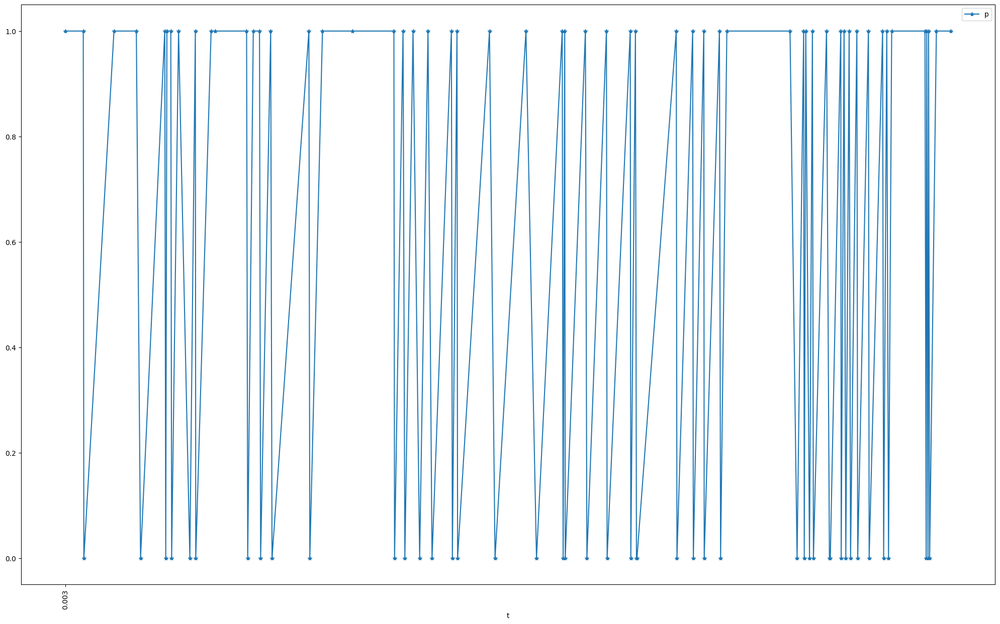

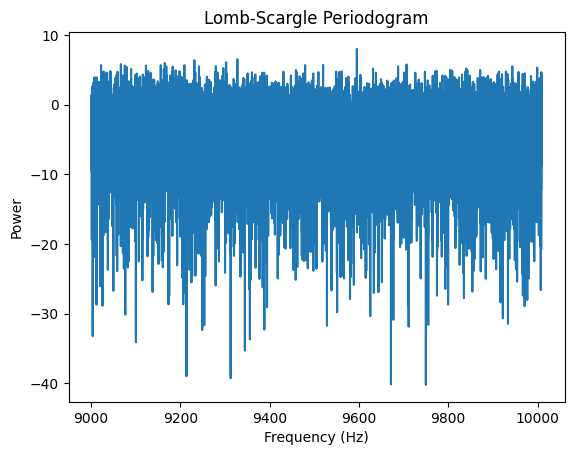

Frequency: 9595.353535353535 Hz, Power: 6.2792525054593264
Frequency: 9327.676767676767 Hz, Power: 4.45163477246867
Frequency: 9231.31313131313 Hz, Power: 4.333042518707279
Frequency: 9302.525252525253 Hz, Power: 4.034754690308148
Frequency: 9165.252525252525 Hz, Power: 3.948509082279819
Frequency: 9066.767676767677 Hz, Power: 3.79654686197825
Frequency: 9706.666666666666 Hz, Power: 3.75497519790732
Frequency: 9519.69696969697 Hz, Power: 3.6993446644970804
Frequency: 9327.474747474747 Hz, Power: 3.693336120065007
Frequency: 9479.494949494949 Hz, Power: 3.6844721175538373
Frequency: 9022.323232323231 Hz, Power: 3.682682848137486
Frequency: 9156.060606060606 Hz, Power: 3.6702504572368198
Frequency: 9208.9898989899 Hz, Power: 3.666447910170754
Frequency: 9075.555555555555 Hz, Power: 3.630489940106817
Frequency: 9122.929292929293 Hz, Power: 3.6173273976606106
Frequency: 9279.494949494949 Hz, Power: 3.559123170506288
Frequency: 9687.676767676767 Hz, Power: 3.538734454940943
Frequency: 9943.

In [44]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/10k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(9000, 10010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 10k ambient backscatter bias

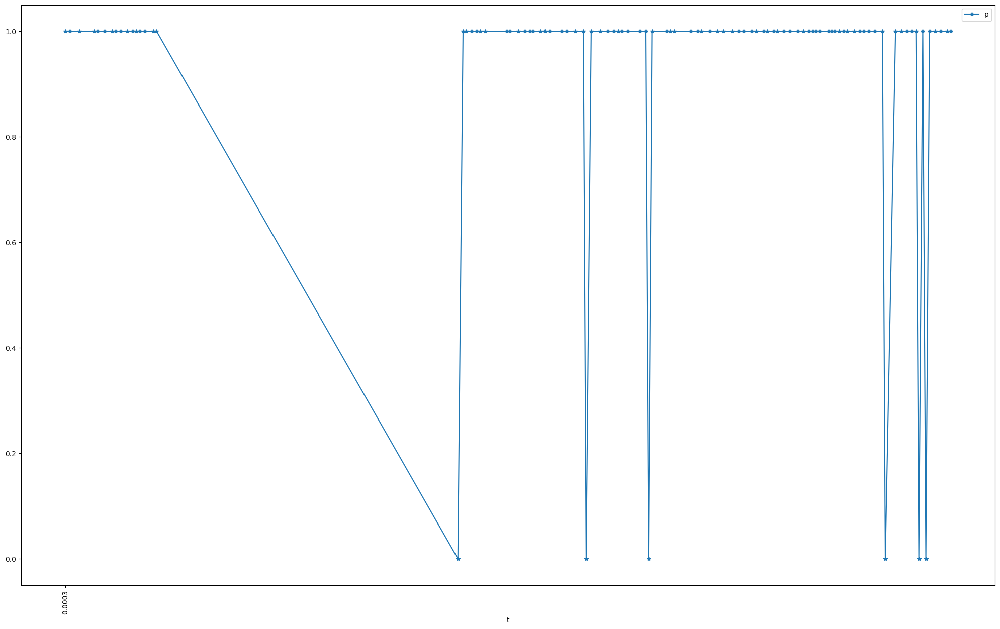

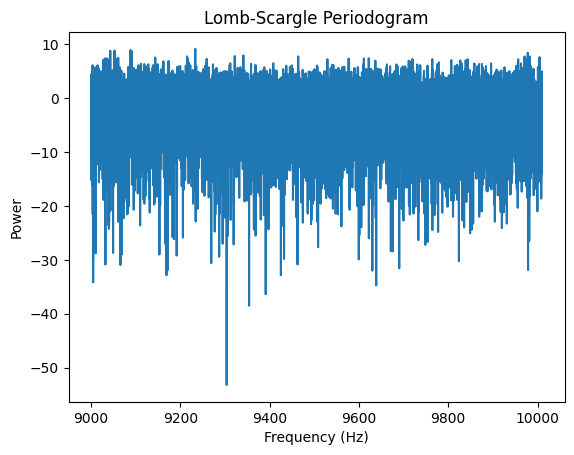

Frequency: 9233.434343434343 Hz, Power: 8.154814111595158
Frequency: 9088.38383838384 Hz, Power: 7.797503573425788
Frequency: 9052.525252525253 Hz, Power: 7.612390798424534
Frequency: 9043.030303030304 Hz, Power: 7.545201382383091
Frequency: 9091.31313131313 Hz, Power: 7.319627778368254
Frequency: 9978.181818181818 Hz, Power: 6.937282577946634
Frequency: 9341.111111111111 Hz, Power: 6.174740602361838
Frequency: 9321.818181818182 Hz, Power: 6.012973289446066
Frequency: 9214.949494949495 Hz, Power: 5.928573920670724
Frequency: 9463.939393939394 Hz, Power: 5.922693601540423
Frequency: 9982.323232323233 Hz, Power: 5.9201892697680165
Frequency: 9970.808080808081 Hz, Power: 5.916059132238704
Frequency: 9982.525252525253 Hz, Power: 5.754766741691898
Frequency: 10004.444444444445 Hz, Power: 5.745633977430189
Frequency: 9143.636363636364 Hz, Power: 5.664644626059145
Frequency: 9060.808080808081 Hz, Power: 5.559479943333438
Frequency: 9215.757575757576 Hz, Power: 5.547957505708551
Frequency: 997

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/10k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(9000, 10010, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 50k dark backscatter

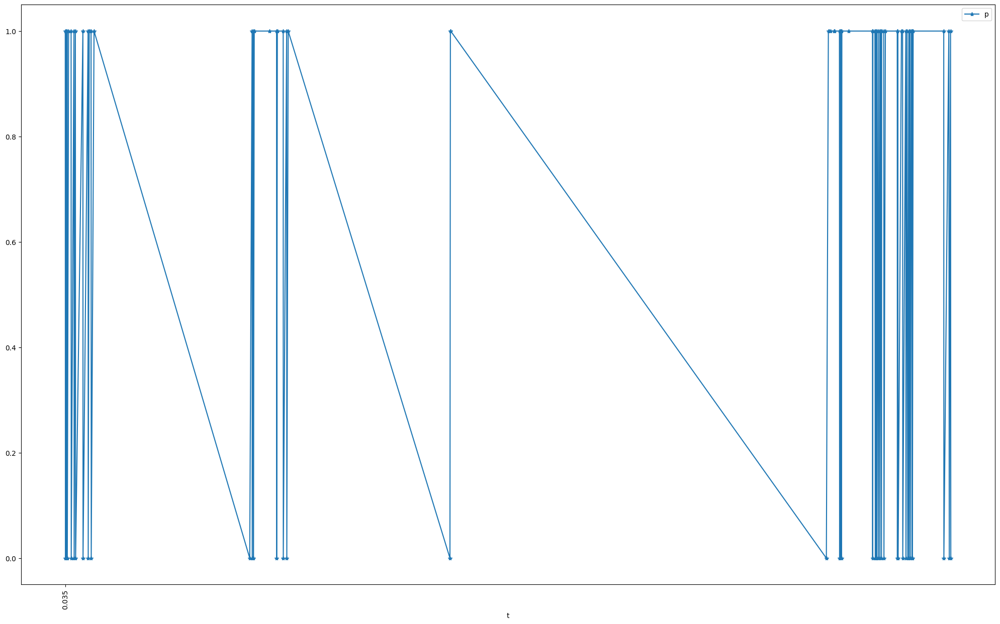

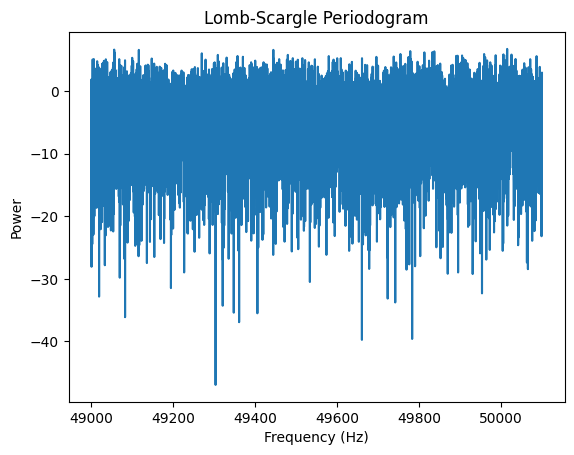

Frequency: 50015.071507150715 Hz, Power: 4.722892090781317
Frequency: 49056.43564356436 Hz, Power: 4.604453113505028
Frequency: 49444.664466446644 Hz, Power: 4.5604826268420595
Frequency: 49116.50165016502 Hz, Power: 4.558773504469261
Frequency: 49778.657865786576 Hz, Power: 4.355603084586599
Frequency: 49837.293729372934 Hz, Power: 4.319689579578135
Frequency: 49832.783278327835 Hz, Power: 4.207273403257347
Frequency: 49056.98569856986 Hz, Power: 4.167466311855718
Frequency: 49813.09130913091 Hz, Power: 4.15828665096025
Frequency: 49270.07700770077 Hz, Power: 4.016611366217925
Frequency: 49754.67546754675 Hz, Power: 3.91822623483805
Frequency: 49958.85588558856 Hz, Power: 3.916419174449792
Frequency: 50005.94059405941 Hz, Power: 3.8615390459946948
Frequency: 50025.632563256324 Hz, Power: 3.835108908138409
Frequency: 49479.97799779978 Hz, Power: 3.793597183911257
Frequency: 49309.24092409241 Hz, Power: 3.7902498419210437
Frequency: 50014.301430143016 Hz, Power: 3.7711151148446636
Frequ

In [46]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/50k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(49000, 50100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 50k dark backscatter bias

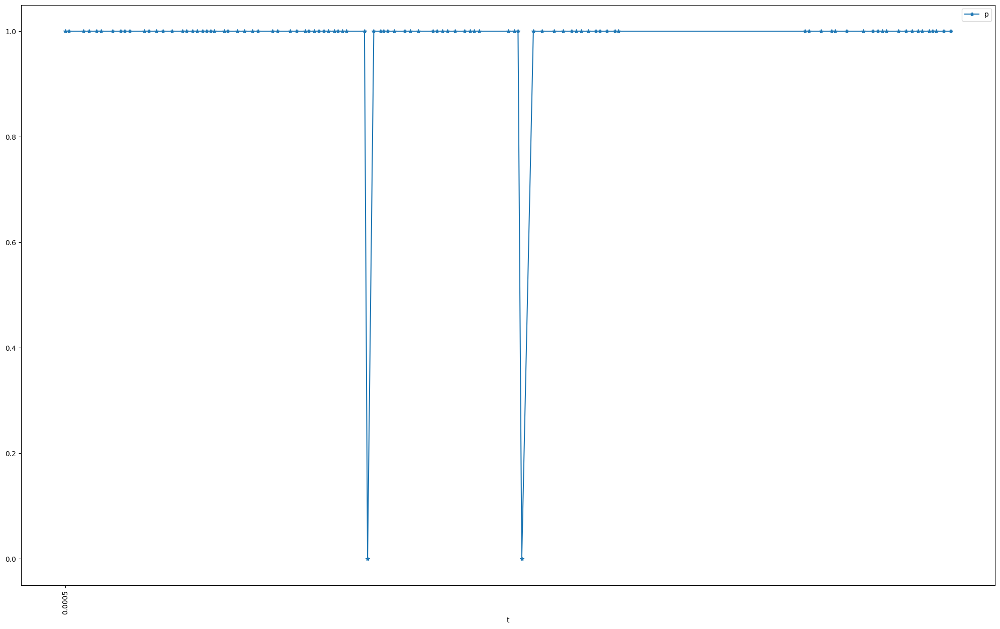

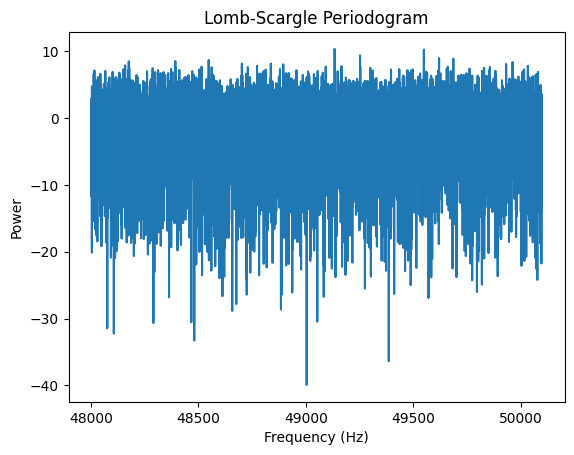

Frequency: 49134.32343234323 Hz, Power: 10.857721921137975
Frequency: 49549.95499549955 Hz, Power: 10.620469075667504
Frequency: 49252.56525652565 Hz, Power: 8.744411554897766
Frequency: 49620.73207320732 Hz, Power: 7.910469280889076
Frequency: 49687.09870987099 Hz, Power: 7.745397062416601
Frequency: 48547.73477347735 Hz, Power: 7.419384196675801
Frequency: 48392.31923192319 Hz, Power: 7.156875588814285
Frequency: 48175.57755775577 Hz, Power: 7.105290372372025
Frequency: 49963.066306630666 Hz, Power: 6.912378325240804
Frequency: 48837.143714371436 Hz, Power: 6.565500542368799
Frequency: 48702.310231023104 Hz, Power: 6.5475555467549
Frequency: 49933.03330333033 Hz, Power: 6.470904895395031
Frequency: 48895.10951095109 Hz, Power: 6.383862704248008
Frequency: 48158.77587758776 Hz, Power: 6.171794896737889
Frequency: 50034.26342634264 Hz, Power: 6.067353607625814
Frequency: 48772.87728772877 Hz, Power: 6.05936383811311
Frequency: 49166.24662466247 Hz, Power: 5.983834715340228
Frequency: 4

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/50k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(48000, 50100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 50k ambient backscatter 

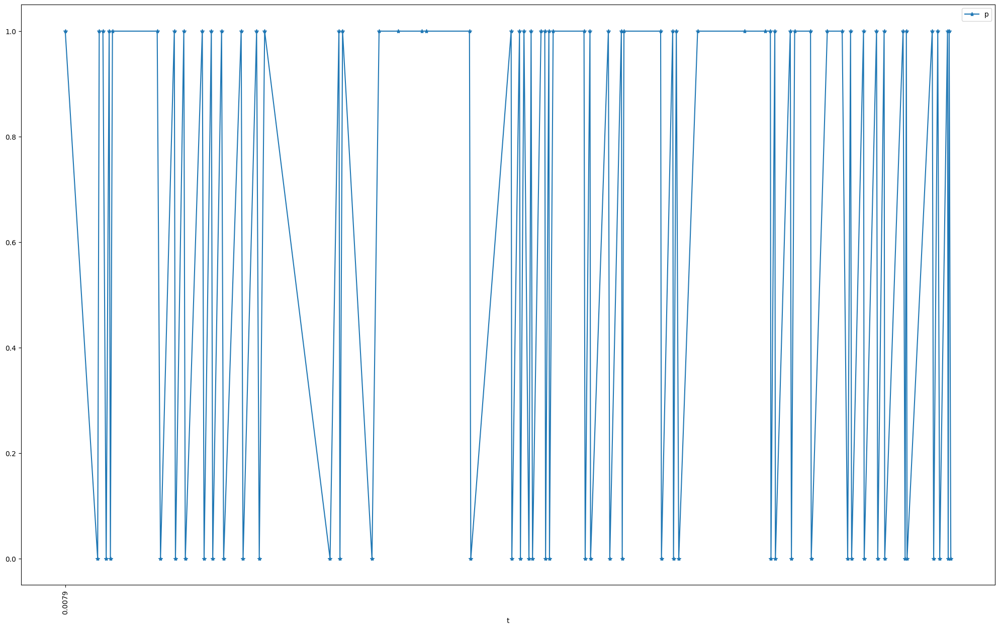

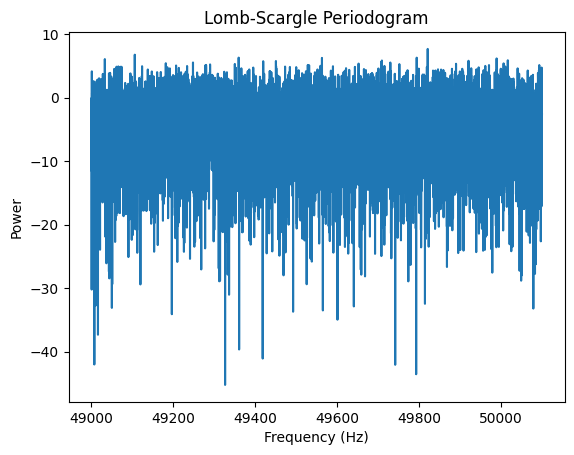

Frequency: 49821.23212321232 Hz, Power: 5.8721010363971455
Frequency: 49106.600660066004 Hz, Power: 4.763152502470494
Frequency: 49360.06600660066 Hz, Power: 4.282493973211112
Frequency: 49794.389438943894 Hz, Power: 4.273488469651331
Frequency: 49563.25632563257 Hz, Power: 4.239061216421158
Frequency: 49989.32893289329 Hz, Power: 4.156976901448083
Frequency: 49033.553355335534 Hz, Power: 4.060000213012203
Frequency: 50016.61166116612 Hz, Power: 3.889743911411342
Frequency: 49709.46094609461 Hz, Power: 3.856956806805729
Frequency: 49920.792079207924 Hz, Power: 3.821079389423362
Frequency: 49450.93509350935 Hz, Power: 3.787628954113036
Frequency: 49419.91199119912 Hz, Power: 3.759214143886139
Frequency: 49707.480748074806 Hz, Power: 3.6582874164079935
Frequency: 49248.62486248625 Hz, Power: 3.5908273201819996
Frequency: 49730.03300330033 Hz, Power: 3.5834252817879992
Frequency: 49182.28822882288 Hz, Power: 3.4941627317698316
Frequency: 50006.380638063805 Hz, Power: 3.474497826045087
Fre

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/50k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(49000, 50100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 50k ambient backscatter bias

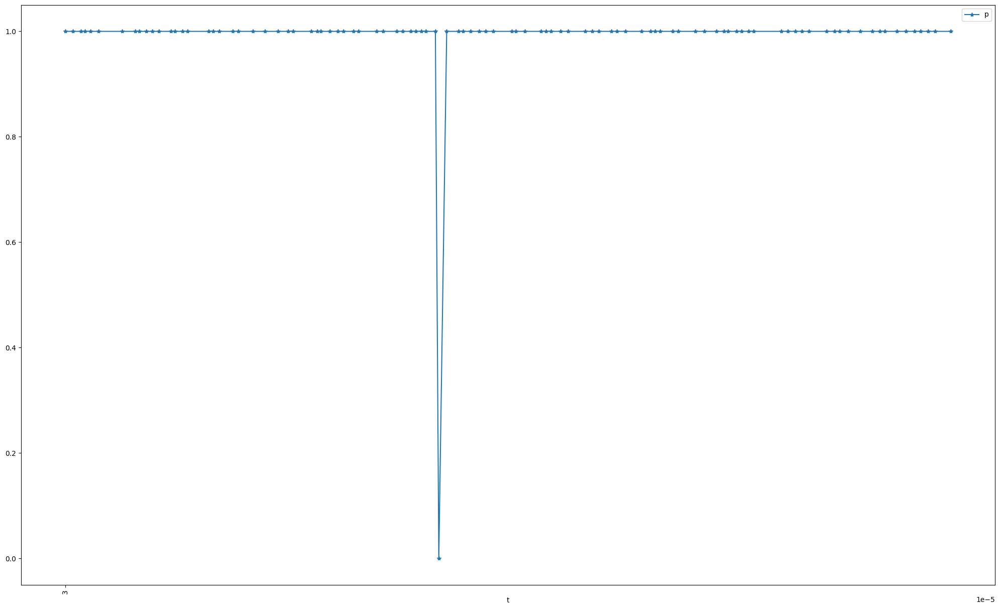

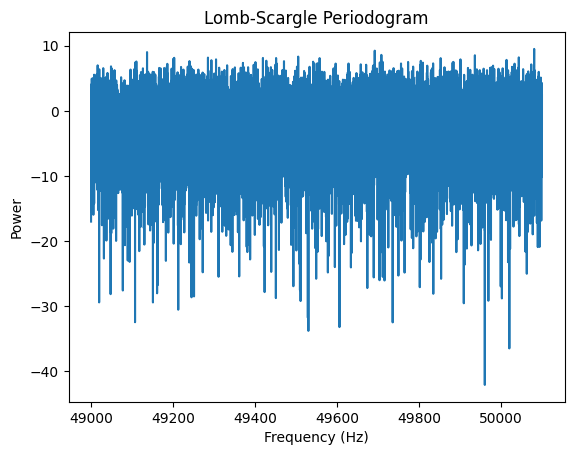

Frequency: 50080.96809680968 Hz, Power: 8.905120746207952
Frequency: 49691.969196919694 Hz, Power: 8.369897321368558
Frequency: 49136.523652365235 Hz, Power: 7.957806232227078
Frequency: 49708.14081408141 Hz, Power: 7.215942503255957
Frequency: 49936.303630363036 Hz, Power: 7.1172255582685215
Frequency: 49505.280528052805 Hz, Power: 6.79089958994903
Frequency: 50043.45434543454 Hz, Power: 6.607508813574389
Frequency: 49285.148514851484 Hz, Power: 6.55319508091638
Frequency: 49202.7502750275 Hz, Power: 6.50468276427683
Frequency: 49419.25192519252 Hz, Power: 6.472789864268975
Frequency: 49451.37513751375 Hz, Power: 6.45829097757438
Frequency: 49557.53575357536 Hz, Power: 6.438053514332365
Frequency: 49852.80528052805 Hz, Power: 6.430187741752185
Frequency: 49200.3300330033 Hz, Power: 6.265050657987714
Frequency: 49304.84048404841 Hz, Power: 6.1603056898651465
Frequency: 49901.100110011 Hz, Power: 6.156632091356392
Frequency: 50013.53135313532 Hz, Power: 6.047530739521237
Frequency: 4929

In [49]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/50k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(49000, 50100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k dark backscatter

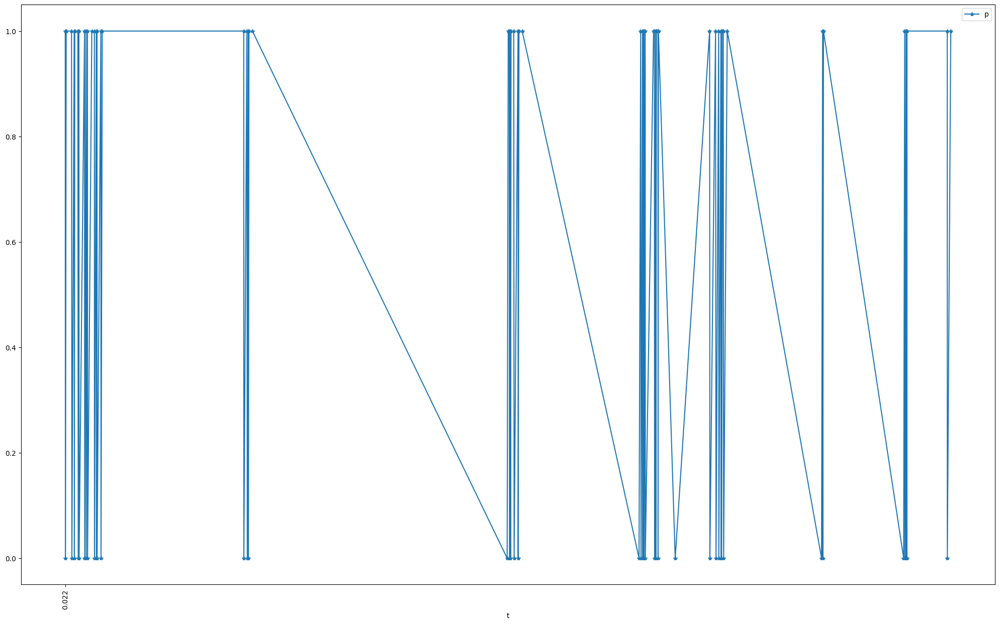

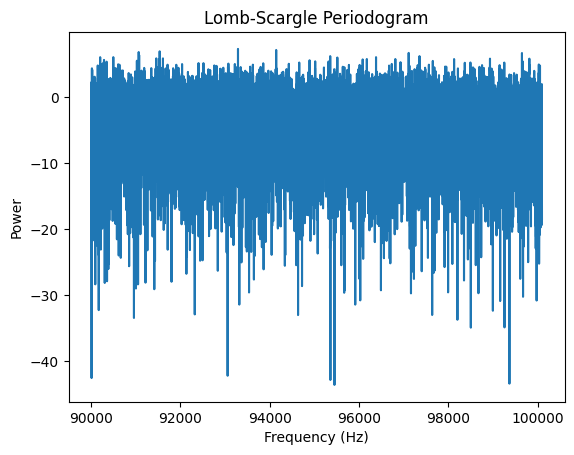

Frequency: 93290.90909090909 Hz, Power: 5.320585050663137
Frequency: 94146.46464646465 Hz, Power: 5.13056550418457
Frequency: 91536.36363636363 Hz, Power: 4.895752487082859
Frequency: 91066.66666666667 Hz, Power: 4.773811525325912
Frequency: 97114.14141414141 Hz, Power: 4.6321001723731765
Frequency: 99651.51515151515 Hz, Power: 4.612417125781817
Frequency: 91076.76767676767 Hz, Power: 4.280622373766683
Frequency: 97356.56565656565 Hz, Power: 4.142428747017893
Frequency: 95356.56565656565 Hz, Power: 4.138607918080872
Frequency: 90497.9797979798 Hz, Power: 3.995750123948944
Frequency: 96382.82828282828 Hz, Power: 3.99368576553956
Frequency: 90204.04040404041 Hz, Power: 3.9897495833915007
Frequency: 95516.16161616161 Hz, Power: 3.9419426103826476
Frequency: 91460.60606060606 Hz, Power: 3.829427346012747
Frequency: 91610.101010101 Hz, Power: 3.827298271597584
Frequency: 98935.35353535354 Hz, Power: 3.790135089227493
Frequency: 99817.17171717172 Hz, Power: 3.7885468391297117
Frequency: 9617

In [50]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k dark backscatter bias

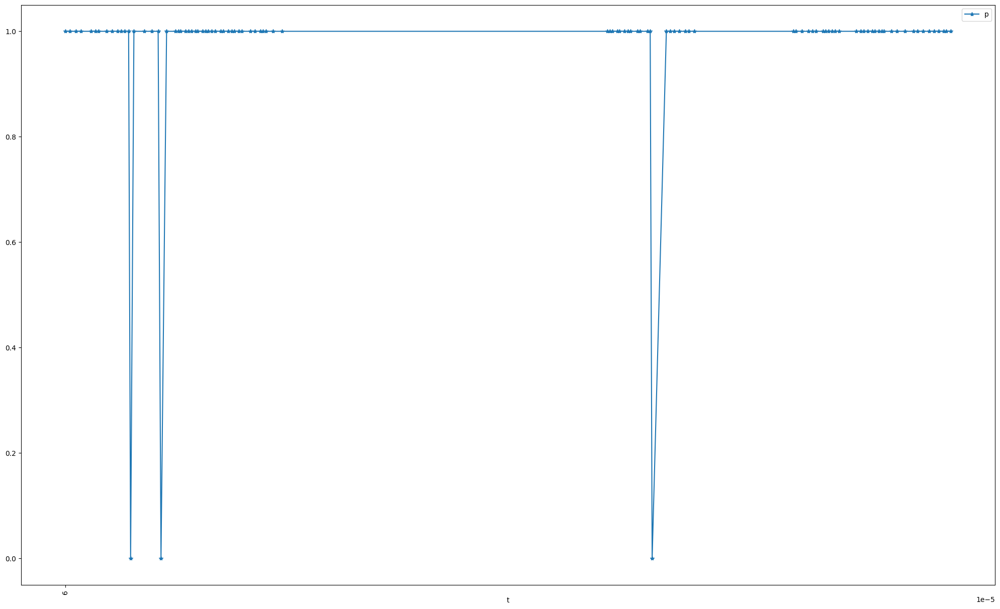

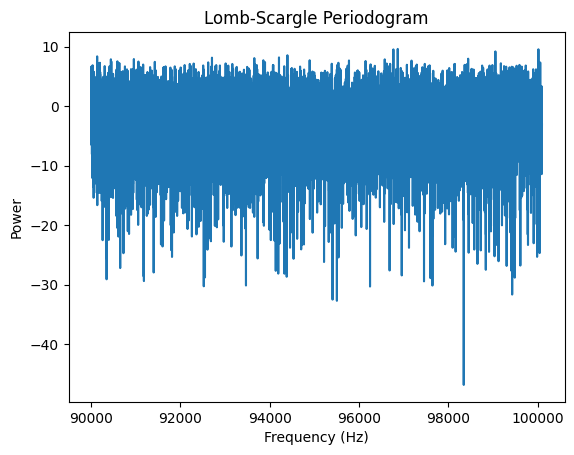

Frequency: 96868.68686868687 Hz, Power: 9.193898523469723
Frequency: 100020.20202020202 Hz, Power: 9.063284580785716
Frequency: 96771.71717171717 Hz, Power: 9.027312371691805
Frequency: 99056.56565656565 Hz, Power: 8.349585080636874
Frequency: 94397.9797979798 Hz, Power: 7.194134094545502
Frequency: 90136.36363636363 Hz, Power: 6.896061206958262
Frequency: 94209.09090909091 Hz, Power: 6.619013284334727
Frequency: 92708.0808080808 Hz, Power: 6.553755531741604
Frequency: 93656.56565656565 Hz, Power: 6.439129488992374
Frequency: 98446.46464646465 Hz, Power: 6.297143974423188
Frequency: 90958.58585858587 Hz, Power: 6.215621112145219
Frequency: 90443.43434343435 Hz, Power: 6.156389336652601
Frequency: 96577.77777777778 Hz, Power: 6.1392121999231515
Frequency: 94895.95959595959 Hz, Power: 5.928843678128393
Frequency: 93858.58585858587 Hz, Power: 5.927996350854299
Frequency: 95776.76767676767 Hz, Power: 5.877492233842511
Frequency: 97177.77777777778 Hz, Power: 5.84829005022913
Frequency: 9614

In [51]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k ambient backscatter

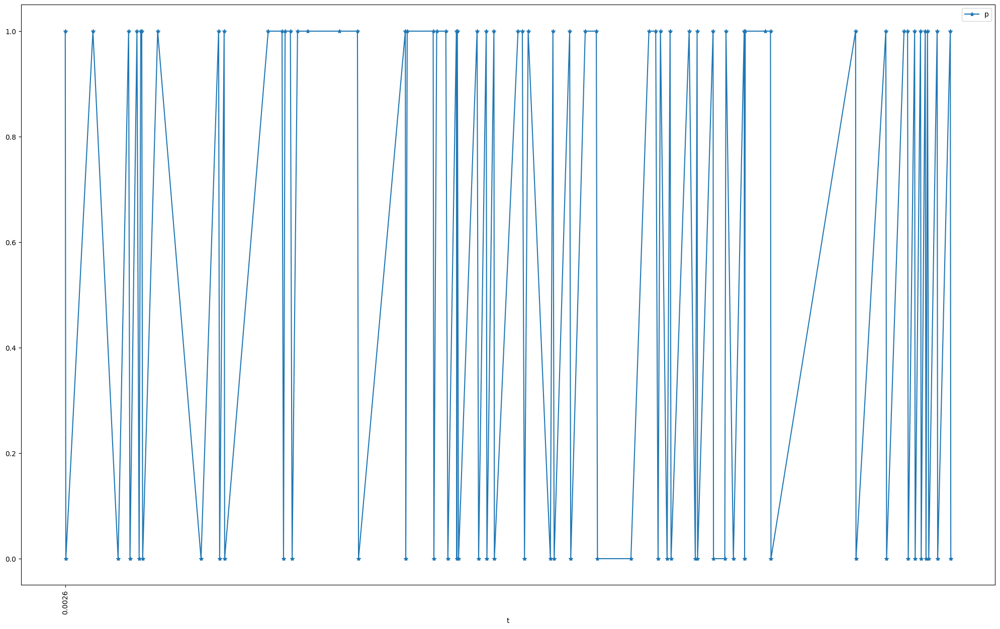

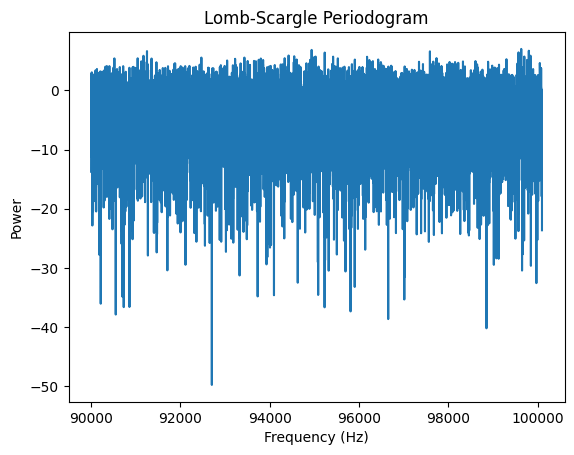

Frequency: 99635.35353535354 Hz, Power: 5.016759045420269
Frequency: 94940.40404040404 Hz, Power: 4.83015791327886
Frequency: 99805.0505050505 Hz, Power: 4.677696130110668
Frequency: 91252.52525252526 Hz, Power: 4.60702918075954
Frequency: 97589.898989899 Hz, Power: 4.566796626904875
Frequency: 99574.74747474748 Hz, Power: 4.387165797191726
Frequency: 95233.33333333333 Hz, Power: 4.353688056196851
Frequency: 94424.24242424243 Hz, Power: 3.883992251514259
Frequency: 99842.42424242424 Hz, Power: 3.85650712492094
Frequency: 91173.73737373737 Hz, Power: 3.8423594895422046
Frequency: 94550.50505050505 Hz, Power: 3.7725306931893936
Frequency: 99704.04040404041 Hz, Power: 3.7300405338989417
Frequency: 95028.28282828283 Hz, Power: 3.725086539733476
Frequency: 95421.21212121213 Hz, Power: 3.7136958378547513
Frequency: 96181.81818181818 Hz, Power: 3.6994067258478704
Frequency: 95003.0303030303 Hz, Power: 3.6747613462117457
Frequency: 92470.70707070707 Hz, Power: 3.5816826485496174
Frequency: 934

In [52]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 100k ambient backscatter bias

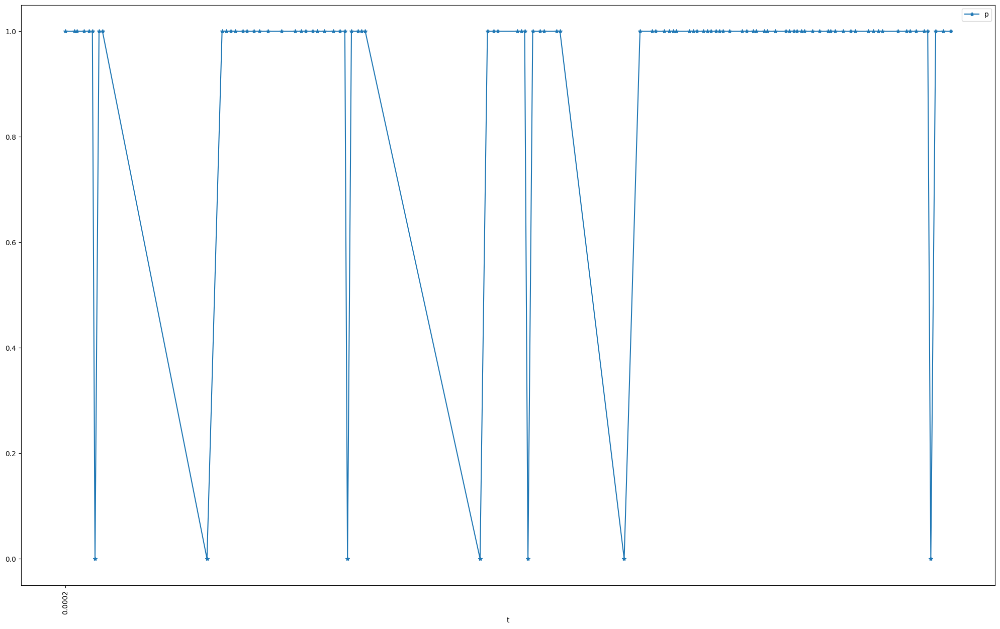

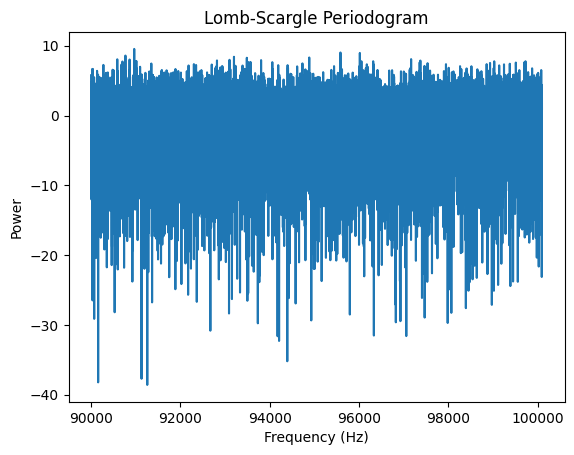

Frequency: 90966.66666666667 Hz, Power: 9.000438809872572
Frequency: 95585.85858585859 Hz, Power: 7.997283952682663
Frequency: 96020.20202020202 Hz, Power: 7.882244187589682
Frequency: 90769.69696969698 Hz, Power: 7.226717079831921
Frequency: 93201.0101010101 Hz, Power: 6.945900539000659
Frequency: 94886.8686868687 Hz, Power: 6.783727318476632
Frequency: 93488.88888888889 Hz, Power: 6.723232795278268
Frequency: 97168.68686868687 Hz, Power: 6.428951985976863
Frequency: 90586.8686868687 Hz, Power: 6.390692618114108
Frequency: 90862.62626262626 Hz, Power: 6.34185452942053
Frequency: 93101.0101010101 Hz, Power: 6.2854094847757205
Frequency: 93808.0808080808 Hz, Power: 6.220742140978362
Frequency: 92820.20202020202 Hz, Power: 6.155270853133027
Frequency: 97375.75757575757 Hz, Power: 6.130947310891918
Frequency: 91014.14141414141 Hz, Power: 6.0505602139701065
Frequency: 96319.19191919192 Hz, Power: 5.996235913226604
Frequency: 96055.55555555556 Hz, Power: 5.99521250893185
Frequency: 99730.30

In [53]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/100k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(90000, 100100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k dark backscatter 

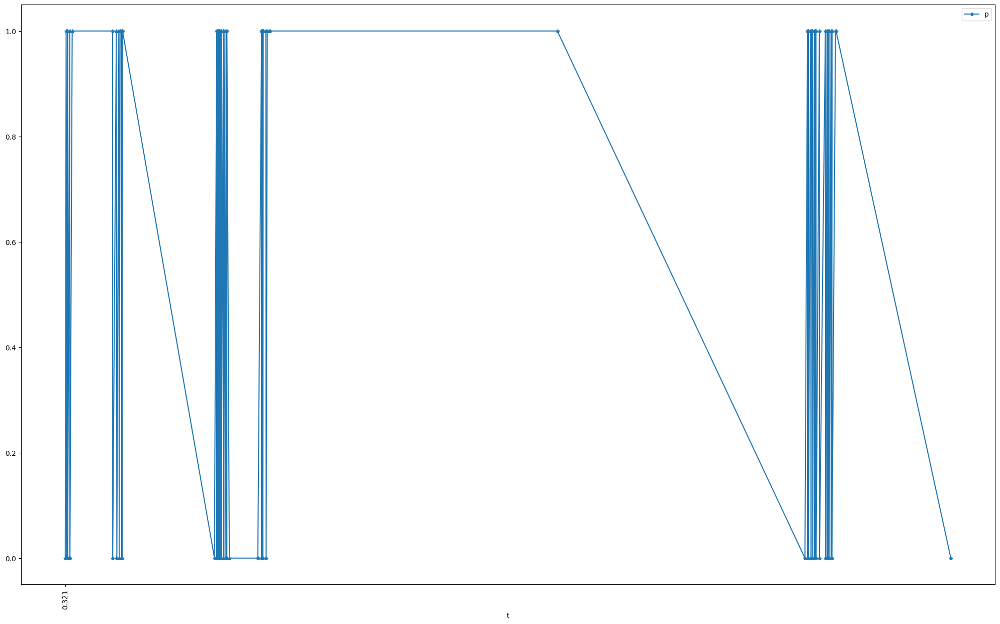

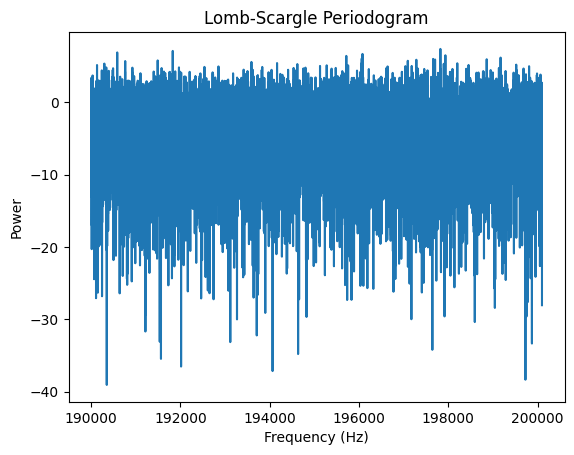

Frequency: 197824.24242424243 Hz, Power: 5.456558995282418
Frequency: 191829.29292929292 Hz, Power: 5.119507144742828
Frequency: 190585.85858585857 Hz, Power: 4.879565907650179
Frequency: 196079.797979798 Hz, Power: 4.6534194707685375
Frequency: 197936.36363636365 Hz, Power: 4.457275949324557
Frequency: 195717.17171717173 Hz, Power: 4.369564791746211
Frequency: 199172.72727272726 Hz, Power: 4.13766788563518
Frequency: 196062.62626262626 Hz, Power: 4.015140692673283
Frequency: 197661.61616161617 Hz, Power: 3.970395129021199
Frequency: 198861.61616161617 Hz, Power: 3.9275243298316154
Frequency: 197705.05050505052 Hz, Power: 3.892638574922829
Frequency: 197285.8585858586 Hz, Power: 3.865189093223156
Frequency: 191491.91919191918 Hz, Power: 3.7834191431156947
Frequency: 197093.9393939394 Hz, Power: 3.740857899864083
Frequency: 190764.64646464647 Hz, Power: 3.709770499852694
Frequency: 193591.91919191918 Hz, Power: 3.603864772590335
Frequency: 194165.65656565657 Hz, Power: 3.479667208633805

In [54]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/200k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k dark backscatter bias

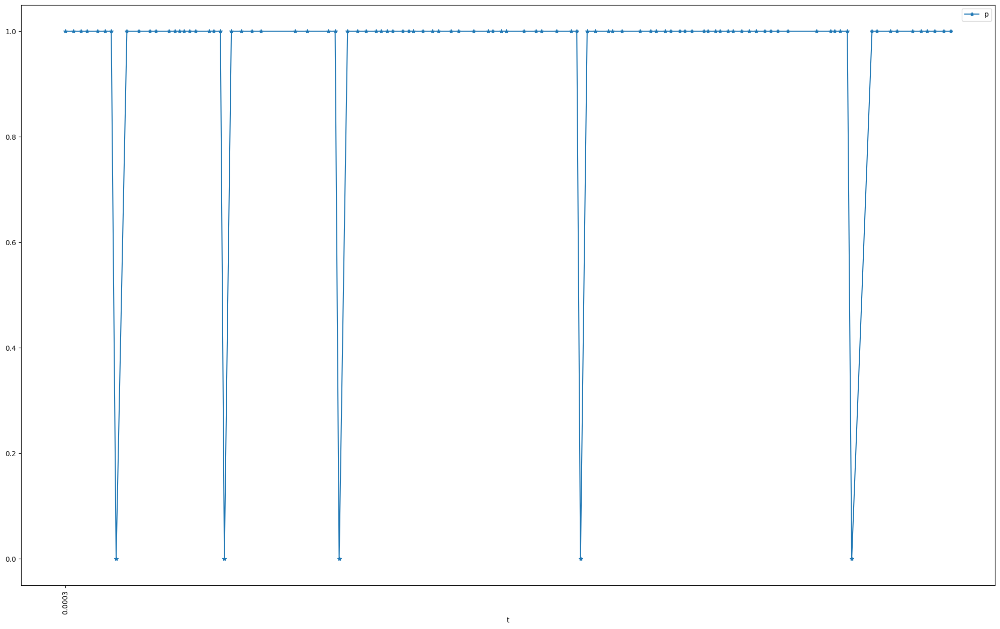

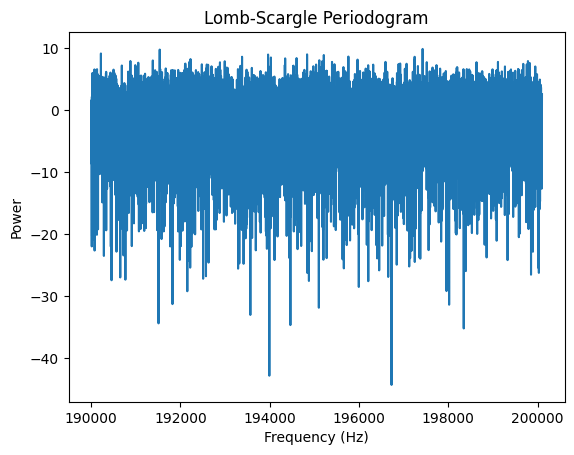

Frequency: 197426.2626262626 Hz, Power: 9.765884674534881
Frequency: 191537.37373737374 Hz, Power: 9.527620206393532
Frequency: 190220.202020202 Hz, Power: 8.24796143928643
Frequency: 194838.38383838383 Hz, Power: 7.979387499765403
Frequency: 193964.64646464647 Hz, Power: 7.927434244820274
Frequency: 195213.1313131313 Hz, Power: 7.785113552024461
Frequency: 195763.63636363635 Hz, Power: 7.354642053397169
Frequency: 193381.81818181818 Hz, Power: 7.304449154688509
Frequency: 197247.47474747474 Hz, Power: 7.295044769664884
Frequency: 194028.28282828283 Hz, Power: 7.108193496752709
Frequency: 194603.0303030303 Hz, Power: 6.9457050054344105
Frequency: 194347.47474747474 Hz, Power: 6.875392783454465
Frequency: 197254.54545454544 Hz, Power: 6.7652564150210335
Frequency: 192227.27272727274 Hz, Power: 6.696318395846803
Frequency: 195968.68686868687 Hz, Power: 6.5656020153696275
Frequency: 195112.12121212122 Hz, Power: 6.412350318992897
Frequency: 191382.8282828283 Hz, Power: 6.364107153638274
F

In [55]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/200k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k ambient bakscatter

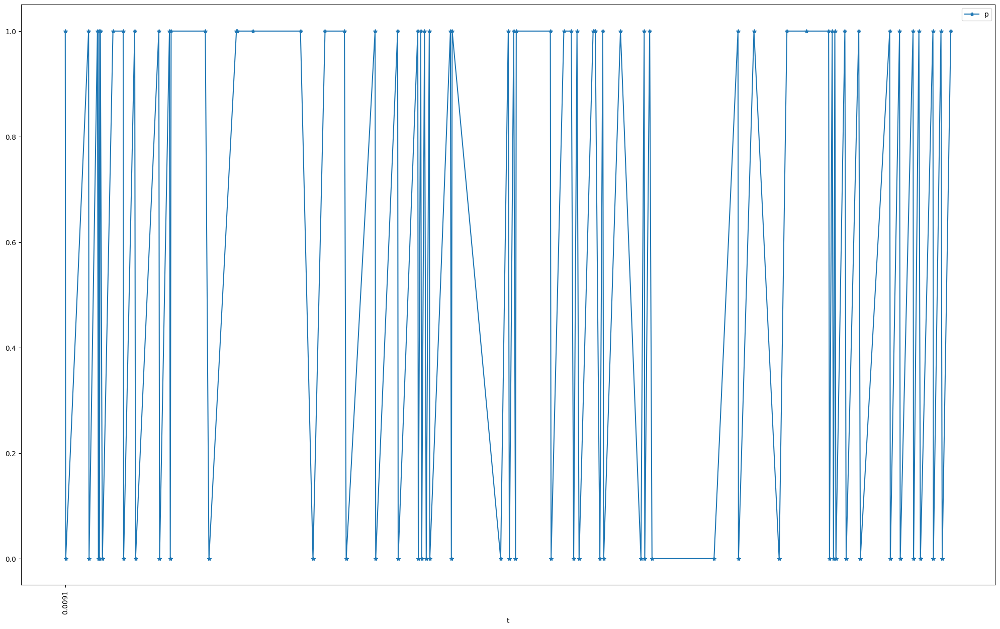

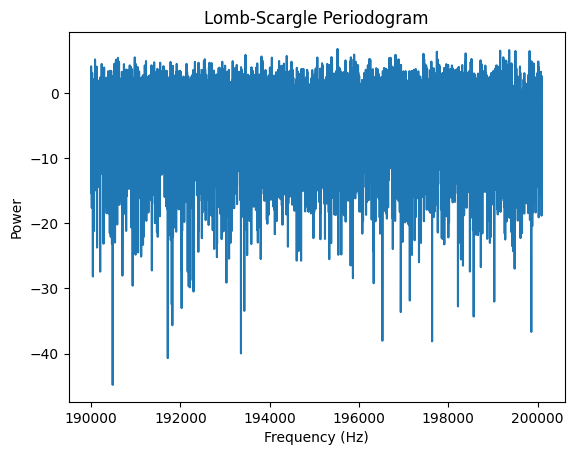

Frequency: 195520.202020202 Hz, Power: 4.720550114288112
Frequency: 199365.65656565657 Hz, Power: 4.535366440866096
Frequency: 199163.63636363635 Hz, Power: 4.440675333540235
Frequency: 199505.05050505052 Hz, Power: 4.388454769558679
Frequency: 199822.22222222222 Hz, Power: 4.376729911089514
Frequency: 197745.45454545456 Hz, Power: 4.280262905219596
Frequency: 198389.898989899 Hz, Power: 4.032651969567302
Frequency: 197445.45454545456 Hz, Power: 3.971169198010726
Frequency: 195892.9292929293 Hz, Power: 3.86199783001963
Frequency: 196819.19191919192 Hz, Power: 3.83583846126046
Frequency: 193458.58585858587 Hz, Power: 3.8195707374316763
Frequency: 194382.82828282827 Hz, Power: 3.6801672321688086
Frequency: 196830.30303030304 Hz, Power: 3.6432546309498743
Frequency: 193817.17171717173 Hz, Power: 3.611595453163307
Frequency: 195384.84848484848 Hz, Power: 3.5384625679455692
Frequency: 195819.19191919192 Hz, Power: 3.5161447031140556
Frequency: 199233.33333333334 Hz, Power: 3.513393751894826

In [56]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/200k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 200k ambient backscatter bias

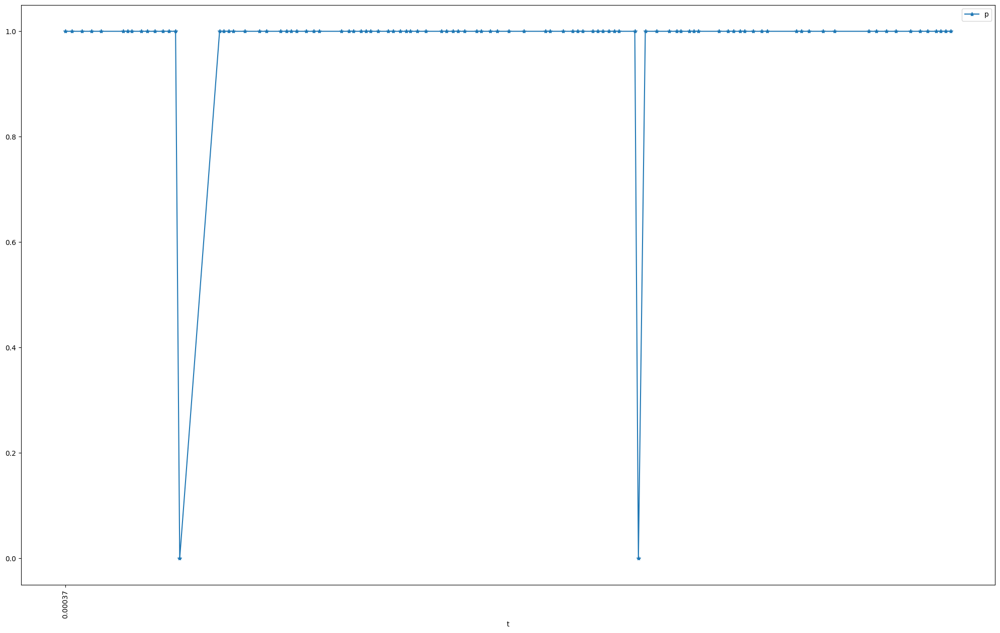

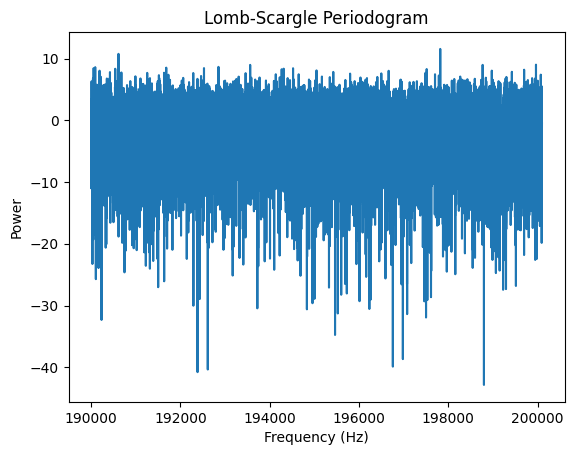

Frequency: 197821.21212121213 Hz, Power: 14.30362349333689
Frequency: 190614.14141414143 Hz, Power: 11.905894093653524
Frequency: 199965.65656565657 Hz, Power: 7.953449287487394
Frequency: 198770.70707070708 Hz, Power: 7.896730155965198
Frequency: 193563.63636363635 Hz, Power: 7.889501905709725
Frequency: 192853.53535353535 Hz, Power: 7.3292151050374
Frequency: 190092.9292929293 Hz, Power: 7.247062476475939
Frequency: 191683.8383838384 Hz, Power: 7.113187819743684
Frequency: 192529.29292929292 Hz, Power: 6.996113740673056
Frequency: 190057.57575757575 Hz, Power: 6.99409509320245
Frequency: 194524.24242424243 Hz, Power: 6.961296011912714
Frequency: 194314.14141414143 Hz, Power: 6.848753780603653
Frequency: 190541.41414141413 Hz, Power: 6.826766836403168
Frequency: 197517.17171717173 Hz, Power: 6.7573793616171685
Frequency: 194269.69696969696 Hz, Power: 6.701872156784132
Frequency: 199700.0 Hz, Power: 6.590162693554509
Frequency: 195049.49494949495 Hz, Power: 6.422159201200534
Frequency:

In [57]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/200k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 200100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 250k dark backscatter

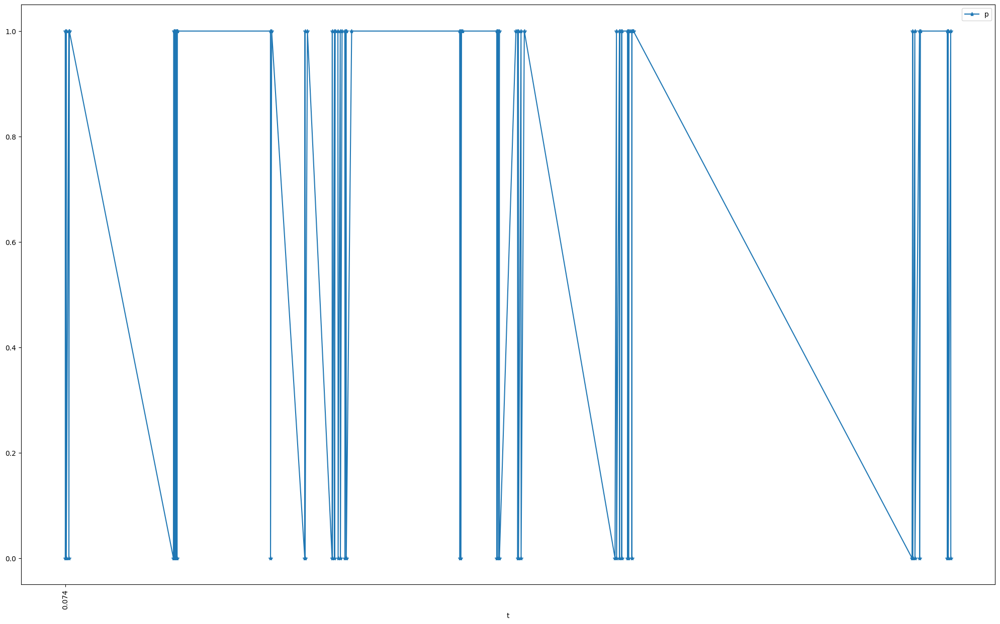

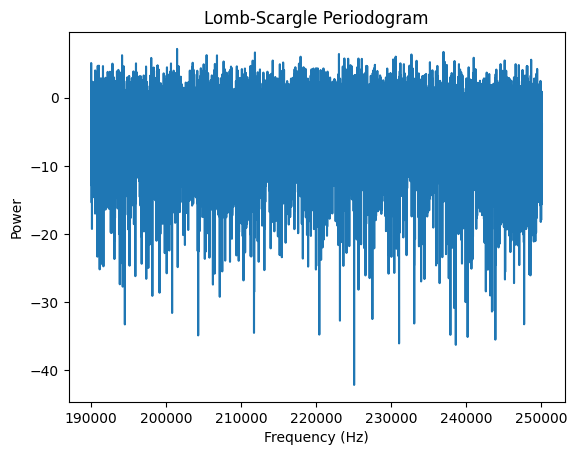

Frequency: 201462.21622162216 Hz, Power: 5.204800193096267
Frequency: 236972.8472847285 Hz, Power: 4.706688931813076
Frequency: 211842.52425242524 Hz, Power: 4.617287175537362
Frequency: 223040.27402740275 Hz, Power: 4.385851120105419
Frequency: 232699.3099309931 Hz, Power: 4.313681127712491
Frequency: 205399.1599159916 Hz, Power: 4.219660566283312
Frequency: 194129.2829282928 Hz, Power: 4.205138428472423
Frequency: 206781.59815981597 Hz, Power: 4.188313865426526
Frequency: 230607.6207620762 Hz, Power: 4.010180515893181
Frequency: 217925.25252525252 Hz, Power: 4.002622670230406
Frequency: 230619.6419641964 Hz, Power: 3.91003629751425
Frequency: 240999.9499949995 Hz, Power: 3.8622016100513443
Frequency: 198018.1418141814 Hz, Power: 3.837988989369489
Frequency: 206769.57695769577 Hz, Power: 3.786108167044771
Frequency: 223761.54615461547 Hz, Power: 3.7705118724092572
Frequency: 225636.85368536855 Hz, Power: 3.7619342300360743
Frequency: 224266.43664366438 Hz, Power: 3.74203152612887
Freq

In [58]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/250k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 250100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 250k dark backscatter bias

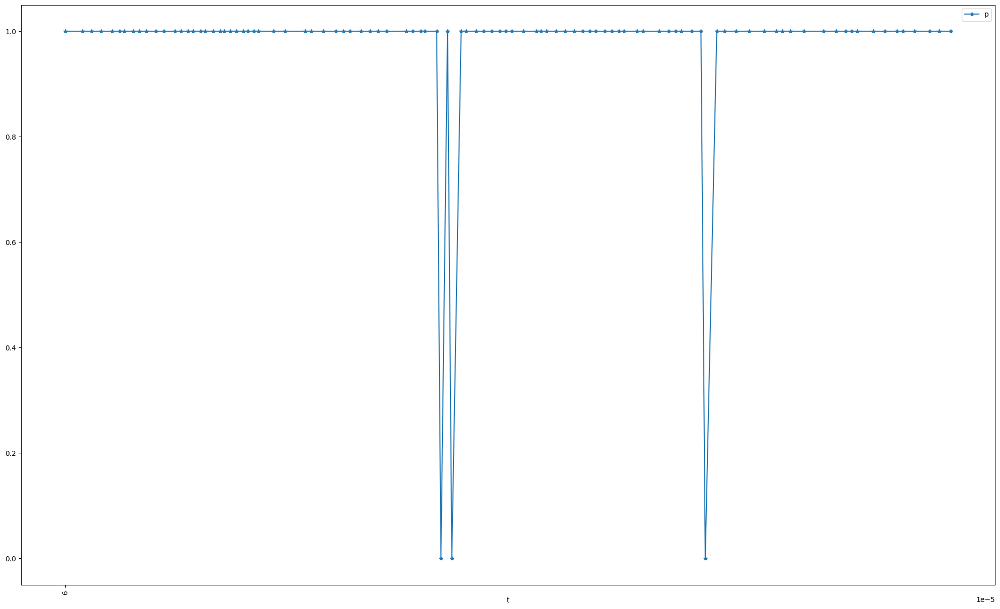

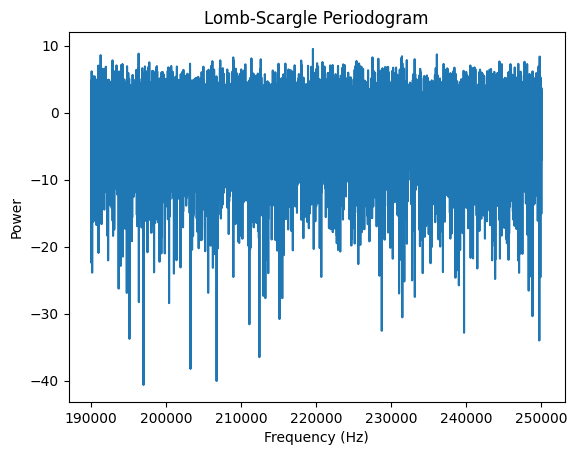

Frequency: 219572.15721572156 Hz, Power: 8.931750213318727
Frequency: 196335.17351735174 Hz, Power: 7.596651239425775
Frequency: 236089.28892889287 Hz, Power: 7.407066643222831
Frequency: 191274.24742474247 Hz, Power: 7.215017950692884
Frequency: 231437.08370837083 Hz, Power: 6.935677934431144
Frequency: 249793.4593459346 Hz, Power: 6.871585736138068
Frequency: 227506.15061506152 Hz, Power: 6.69516616054261
Frequency: 208951.42514251426 Hz, Power: 6.677535928371759
Frequency: 231364.95649564956 Hz, Power: 6.556775575350167
Frequency: 211373.69736973697 Hz, Power: 6.456913083334639
Frequency: 228287.52875287528 Hz, Power: 6.375046932958459
Frequency: 233126.06260626062 Hz, Power: 6.275770599112745
Frequency: 212611.8811881188 Hz, Power: 6.26358426742219
Frequency: 232080.21802180217 Hz, Power: 6.082741203592034
Frequency: 192855.03550355035 Hz, Power: 6.033601315972073
Frequency: 207220.37203720372 Hz, Power: 6.031606177124967
Frequency: 218009.400940094 Hz, Power: 5.991140392292919
Fre

In [59]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/250k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 250100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 250k ambient backscatter bias

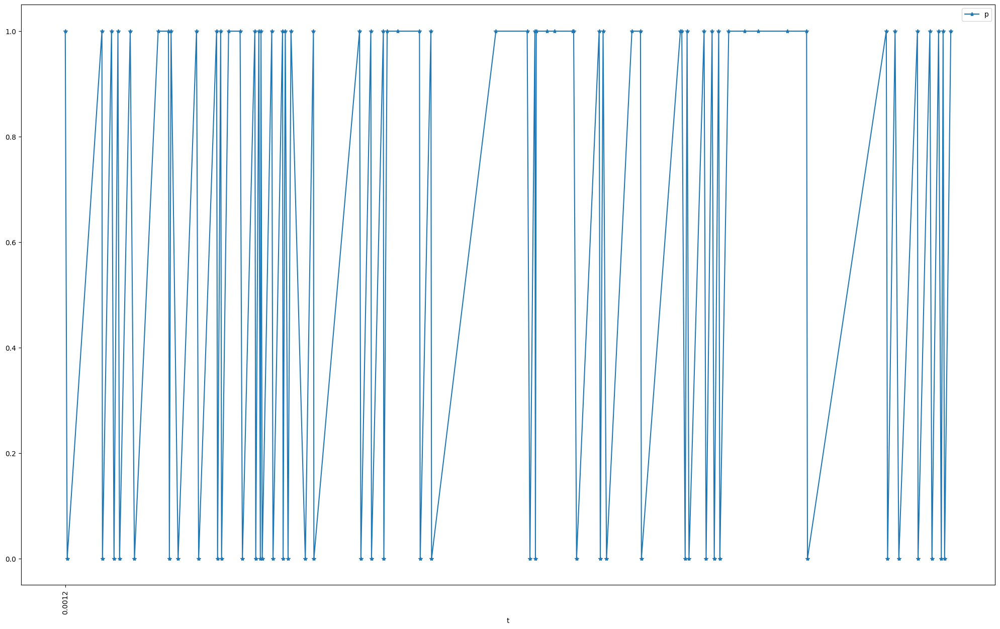

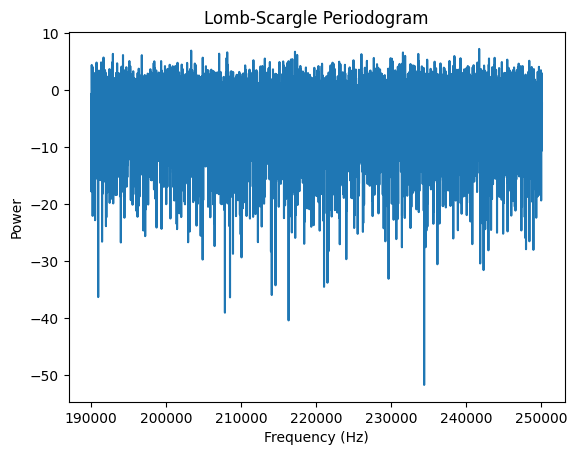

Frequency: 241727.23272327232 Hz, Power: 5.243948285736487
Frequency: 203343.53435343533 Hz, Power: 4.895179284475452
Frequency: 217179.9379937994 Hz, Power: 4.683591653993306
Frequency: 208146.00460046006 Hz, Power: 4.565300972214742
Frequency: 231569.31693169317 Hz, Power: 4.5447680845042795
Frequency: 207070.10701070106 Hz, Power: 4.3251879402416655
Frequency: 192909.1309130913 Hz, Power: 4.295160756138747
Frequency: 233612.9212921292 Hz, Power: 4.288459086531286
Frequency: 226033.55335533555 Hz, Power: 4.242161912905272
Frequency: 217468.44684468445 Hz, Power: 4.112974727986365
Frequency: 194255.50555055507 Hz, Power: 4.09629164071253
Frequency: 196761.92619261926 Hz, Power: 4.075517678090296
Frequency: 231857.82578257826 Hz, Power: 3.959125408721965
Frequency: 238421.40214021402 Hz, Power: 3.9369229715400573
Frequency: 191658.92589258926 Hz, Power: 3.7081713165590977
Frequency: 204882.24822482248 Hz, Power: 3.6858011865739893
Frequency: 238439.43394339434 Hz, Power: 3.667179972810

In [60]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/250k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 250100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 250k ambient backscatter bias

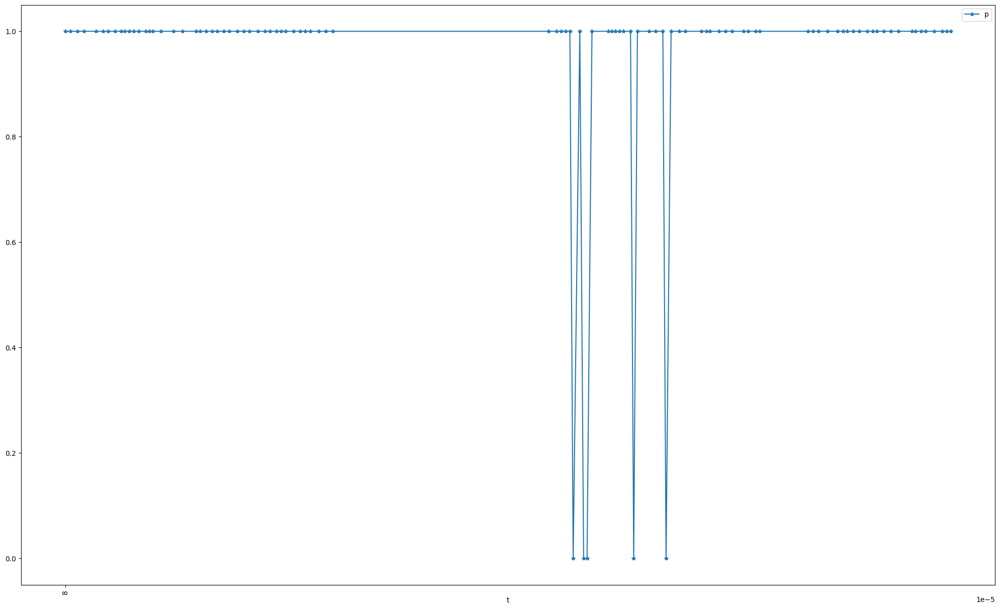

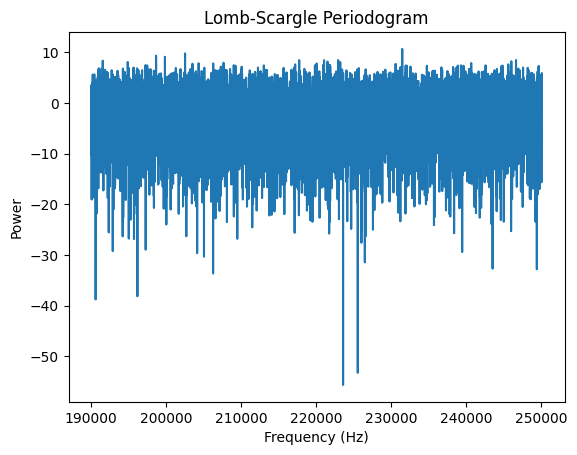

Frequency: 231473.14731473147 Hz, Power: 11.741662552904165
Frequency: 202526.09260926093 Hz, Power: 9.583634516700421
Frequency: 198661.27612761277 Hz, Power: 8.616409703705953
Frequency: 199845.36453645365 Hz, Power: 8.215881588086738
Frequency: 246637.89378937893 Hz, Power: 7.087432566383454
Frequency: 222932.08320832084 Hz, Power: 7.068569478831375
Frequency: 217738.92389238923 Hz, Power: 7.062426558281929
Frequency: 221050.76507650764 Hz, Power: 7.038798577481463
Frequency: 191556.74567456744 Hz, Power: 6.865644204384628
Frequency: 246012.7912791279 Hz, Power: 6.703945900076221
Frequency: 221507.5707570757 Hz, Power: 6.6013871109514035
Frequency: 194886.61866186617 Hz, Power: 6.48379748344582
Frequency: 223208.5708570857 Hz, Power: 6.420268121773732
Frequency: 223004.2104210421 Hz, Power: 6.364252951414351
Frequency: 207659.14591459147 Hz, Power: 6.252956669589015
Frequency: 240669.36693669367 Hz, Power: 6.179773600281466
Frequency: 204335.28352835283 Hz, Power: 6.1287592848439765

In [61]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/250k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(190000, 250100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500k dark backscatter

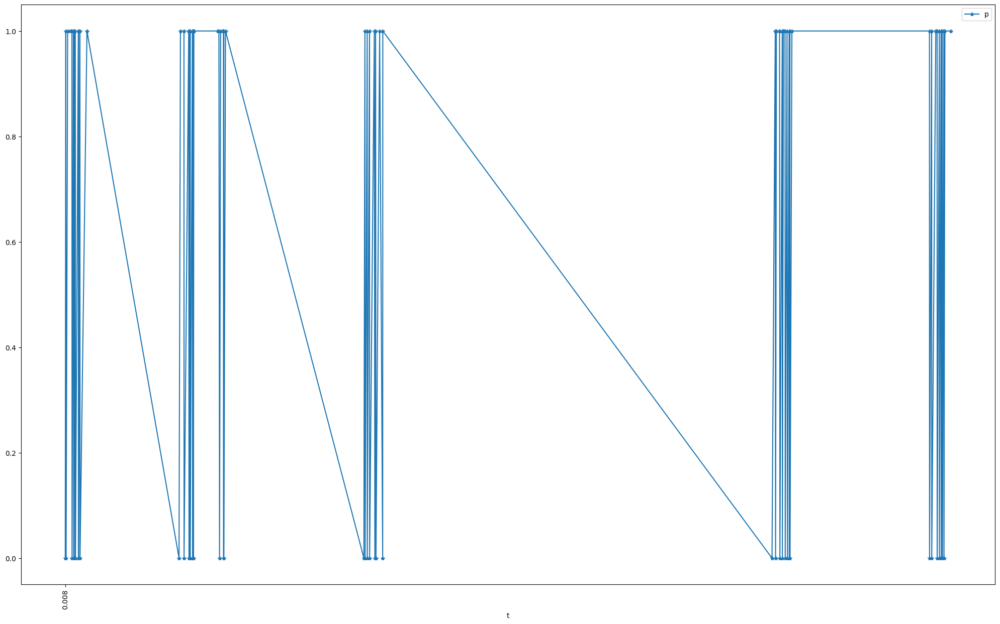

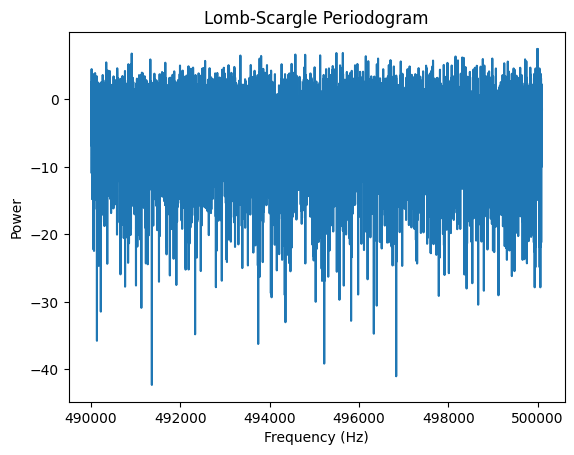

Frequency: 499991.9191919192 Hz, Power: 5.570344983258967
Frequency: 500008.0808080808 Hz, Power: 5.570344981514891
Frequency: 495639.3939393939 Hz, Power: 4.853306994263804
Frequency: 495494.9494949495 Hz, Power: 4.843039609494623
Frequency: 490910.10101010103 Hz, Power: 4.755248386528742
Frequency: 494575.75757575757 Hz, Power: 4.600367350490006
Frequency: 494795.9595959596 Hz, Power: 4.564681482235173
Frequency: 495131.31313131313 Hz, Power: 4.47482586515965
Frequency: 493344.44444444444 Hz, Power: 4.446255860616857
Frequency: 493809.0909090909 Hz, Power: 4.38093794280155
Frequency: 496153.5353535354 Hz, Power: 4.341762498162758
Frequency: 498163.63636363635 Hz, Power: 4.303028340286671
Frequency: 498313.1313131313 Hz, Power: 4.1601374819015735
Frequency: 498346.4646464646 Hz, Power: 4.111376741553758
Frequency: 498986.8686868687 Hz, Power: 4.0152977698481
Frequency: 493774.7474747475 Hz, Power: 4.013412858361003
Frequency: 496428.28282828286 Hz, Power: 4.0122987389489575
Frequency:

In [62]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/500k_dark_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500k dark backscatter bias

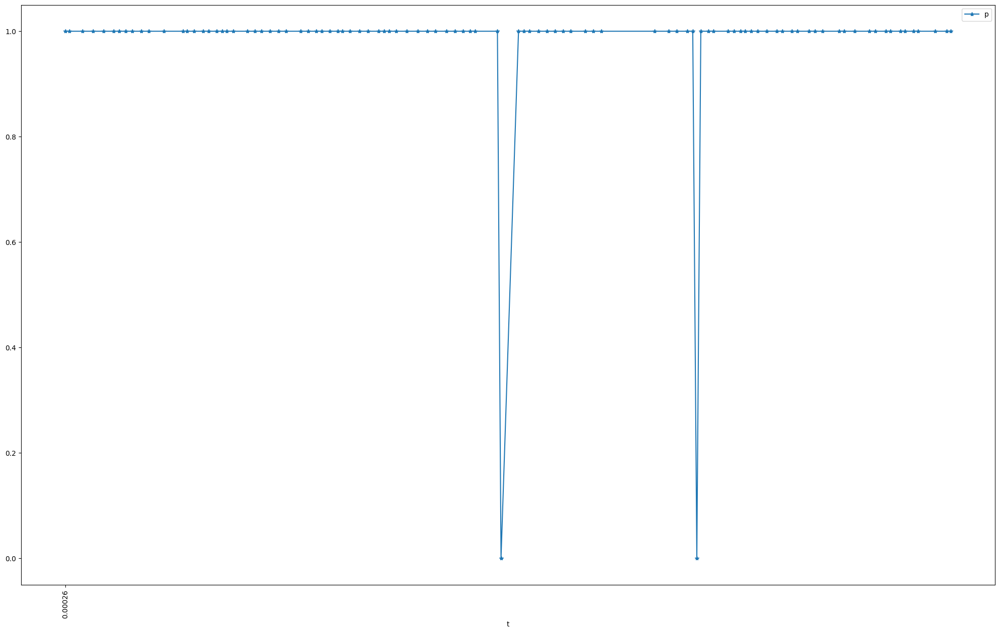

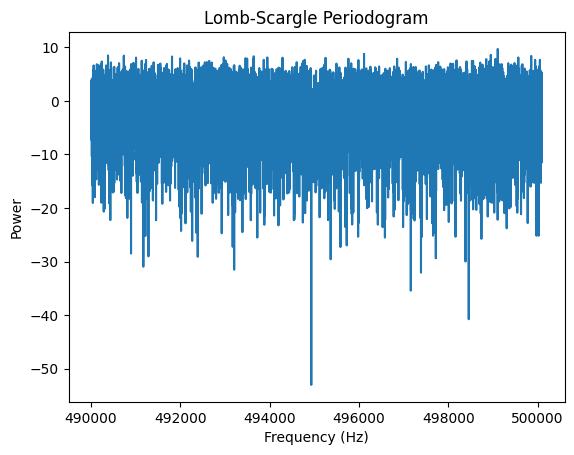

Frequency: 499109.0909090909 Hz, Power: 9.315882578815897
Frequency: 496114.1414141414 Hz, Power: 7.549874065823802
Frequency: 498953.5353535354 Hz, Power: 7.214278046191069
Frequency: 490379.797979798 Hz, Power: 7.0467218420501565
Frequency: 490733.3333333333 Hz, Power: 6.97524666392591
Frequency: 499858.58585858584 Hz, Power: 6.886109510782725
Frequency: 493643.43434343435 Hz, Power: 6.790740355744039
Frequency: 491813.1313131313 Hz, Power: 6.72050949694378
Frequency: 492972.7272727273 Hz, Power: 6.515951955120615
Frequency: 493947.4747474748 Hz, Power: 6.4719537645495615
Frequency: 499569.69696969696 Hz, Power: 6.456279787599922
Frequency: 491007.0707070707 Hz, Power: 6.424873665657991
Frequency: 494287.8787878788 Hz, Power: 6.39745004311096
Frequency: 495252.5252525252 Hz, Power: 6.356711639938747
Frequency: 493460.6060606061 Hz, Power: 6.257515549537769
Frequency: 491993.9393939394 Hz, Power: 6.20047499049516
Frequency: 493495.9595959596 Hz, Power: 6.136187272140882
Frequency: 495

In [63]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/500k_dark_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500k ambient backscatter

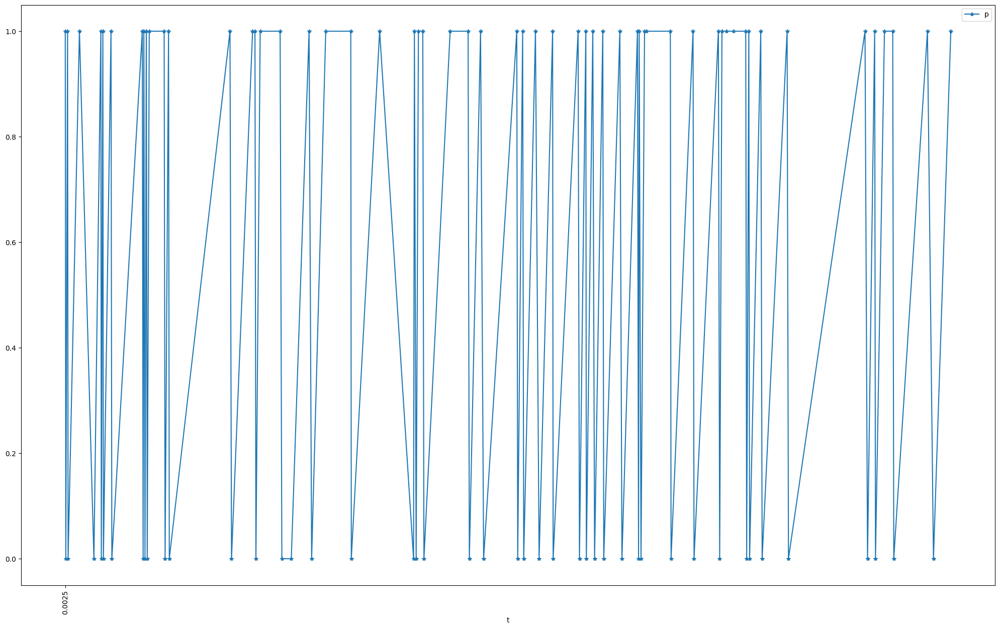

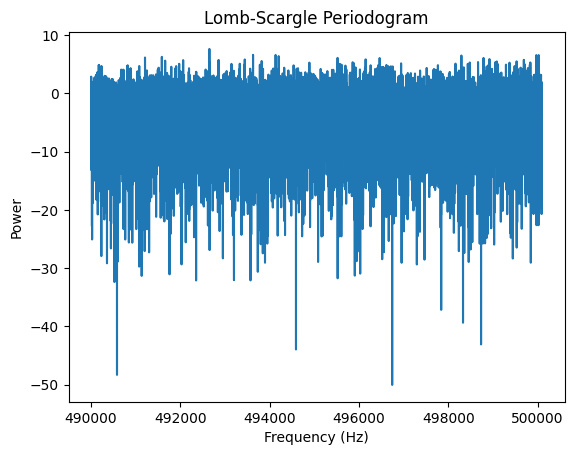

Frequency: 492650.50505050505 Hz, Power: 5.782527085323558
Frequency: 493628.28282828286 Hz, Power: 4.575091992098575
Frequency: 494133.3333333333 Hz, Power: 4.555908173474378
Frequency: 499973.7373737374 Hz, Power: 4.534993727014864
Frequency: 500026.2626262626 Hz, Power: 4.5349937266908045
Frequency: 498294.9494949495 Hz, Power: 4.454211660079012
Frequency: 494202.0202020202 Hz, Power: 4.350832970268076
Frequency: 491584.8484848485 Hz, Power: 4.228705131589849
Frequency: 491208.0808080808 Hz, Power: 4.119088949698826
Frequency: 495521.2121212121 Hz, Power: 4.059153532803931
Frequency: 498790.9090909091 Hz, Power: 4.047033981371724
Frequency: 496463.63636363635 Hz, Power: 4.034139850610036
Frequency: 498923.23232323234 Hz, Power: 3.8732675773485785
Frequency: 496149.49494949495 Hz, Power: 3.8280912468862005
Frequency: 493442.42424242425 Hz, Power: 3.8135017636523862
Frequency: 499693.9393939394 Hz, Power: 3.759513185088686
Frequency: 492855.55555555556 Hz, Power: 3.7339901306170016
Fr

In [64]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/500k_ambient_backscatter.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# 500k ambient backscatter bias

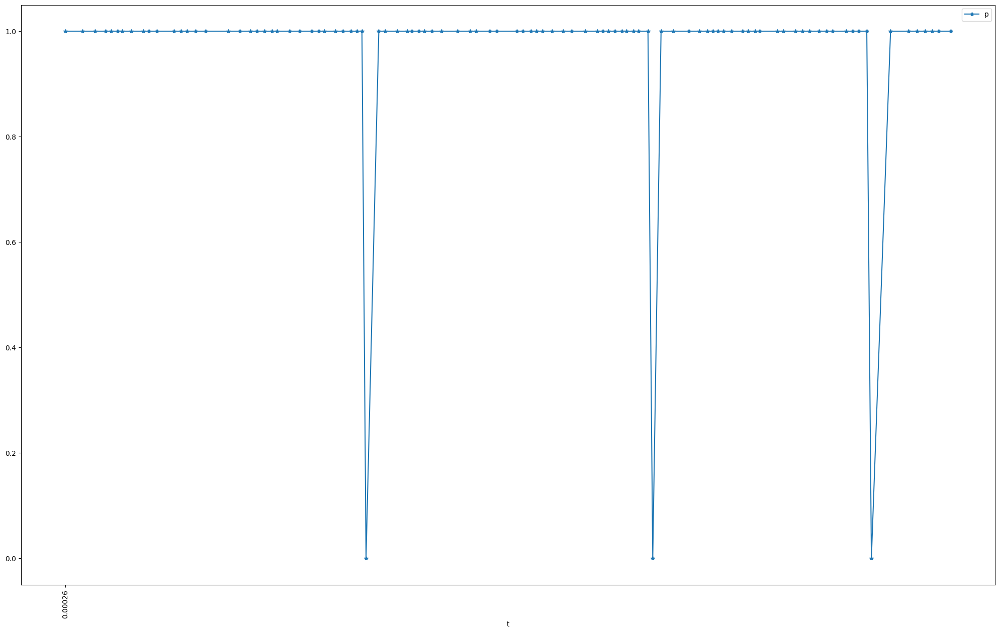

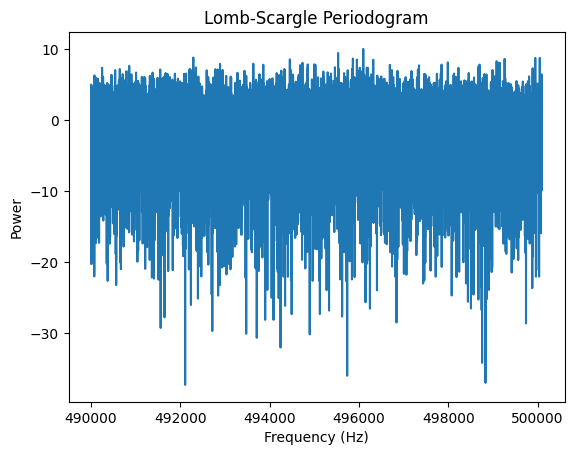

Frequency: 496096.9696969697 Hz, Power: 10.069860190666661
Frequency: 495533.3333333333 Hz, Power: 8.813765600789505
Frequency: 492289.89898989897 Hz, Power: 7.615277907203779
Frequency: 500050.50505050505 Hz, Power: 7.516765966838652
Frequency: 499949.49494949495 Hz, Power: 7.516765961743834
Frequency: 495864.64646464644 Hz, Power: 7.383678194495176
Frequency: 499262.62626262626 Hz, Power: 7.298147609631325
Frequency: 494452.5252525252 Hz, Power: 7.19084034203745
Frequency: 495954.54545454547 Hz, Power: 7.134122934407571
Frequency: 496320.202020202 Hz, Power: 7.088960014628919
Frequency: 499083.83838383836 Hz, Power: 6.774503386182036
Frequency: 497990.9090909091 Hz, Power: 6.5137238802371265
Frequency: 499153.5353535354 Hz, Power: 6.439014801997397
Frequency: 494734.34343434346 Hz, Power: 6.433393638061262
Frequency: 499125.2525252525 Hz, Power: 6.399215141519387
Frequency: 493634.34343434346 Hz, Power: 6.242140034633439
Frequency: 492888.8888888889 Hz, Power: 6.197851815470811
Frequ

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import dask.dataframe as dd
# import seaborn as sns
from scipy.fftpack import fft, ifft
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/500k_ambient_backscatter_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
plot_pixel_value(df_pixel, 100, 100)
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(490000, 500100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)

# convert the power to dB
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
plt.plot(frequencies, power_db)
plt.title('Lomb-Scargle Periodogram')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.show()

from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]

# Print the sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies)):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")

# Laser data recollected

# 100Hz no bias

In [7]:
import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
print('imports done')
df_chunked = pd.read_csv('csv_data/laser_new_100hz_no_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
print('opened csv file')
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
print('most_common_pair found')
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
print('pixel stats done')
fig, (ax1, ax2) = plt.subplots(2, 1)
print('subplots done')
plot_pixel_value(ax1, df_pixel, 100, 100)
print('plotting done')
# plt.show()
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle


frequencies = np.linspace(80, 200, 10000)  # frequencies from 0.01 Hz to 1000 Hz
print('lomb scargle frequencies done')
# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
print('lomb scargle done')
power_db = 10 * np.log10(power)
print('power_db done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
print('plotting done')
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_new_60hz_no_bias.png')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_new_60hz_no_bias.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

imports done
opened csv file
most_common_pair found
pixel stats done
subplots done
plotting done
lomb scargle frequencies done


# 60hz bias

In [6]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_new_60hz_bias.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min()
df['t'] = df['t']*1e-6
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
frequencies = np.linspace(20, 100, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
power = lombscargle(df_pixel['t'], df_pixel['p'], frequencies * 2 * np.pi)
power_db = 10 * np.log10(power)
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_new_60hz_bias.png')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_new_60hz_bias.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

            x    y  p         t
2138650   331  578  1  0.394293
5113763   331  578  1  0.949598
7706248   331  578  1  1.436992
28760731  331  578  1  3.837615
28781552  331  578  1  3.838616
lomb scargle
lomb scargle done


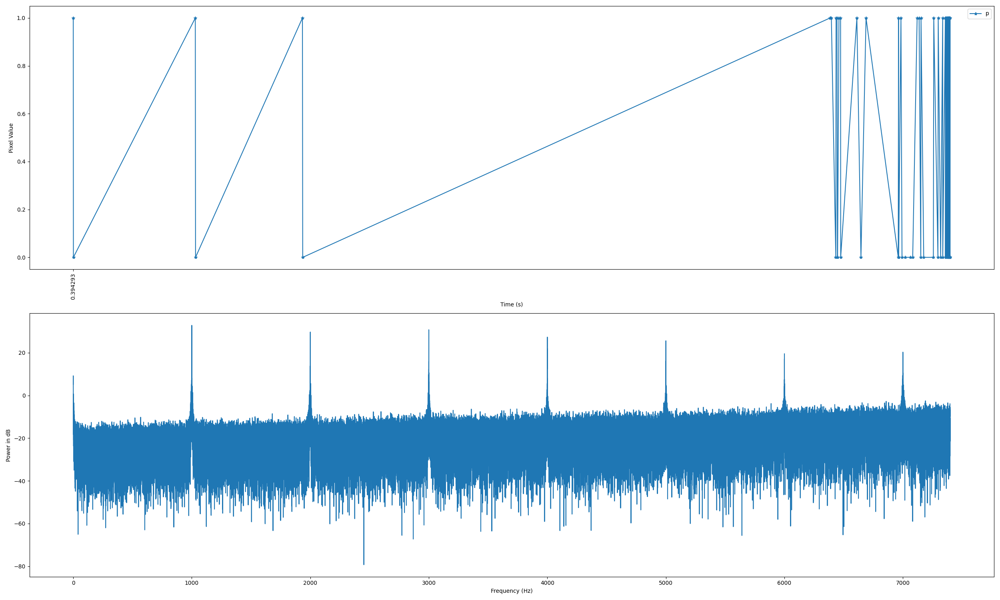

Frequency: 1000.0225864672507 Hz, Power: 32.848891634569085
Frequency: 3000.067759401752 Hz, Power: 30.796470455117625
Frequency: 2000.0541715270315 Hz, Power: 29.72336759814396
Frequency: 4000.099344461533 Hz, Power: 27.340617922312003
Frequency: 5000.112932336254 Hz, Power: 25.625205653135673
Folder for selection: video_export\direct_test_240312_180831


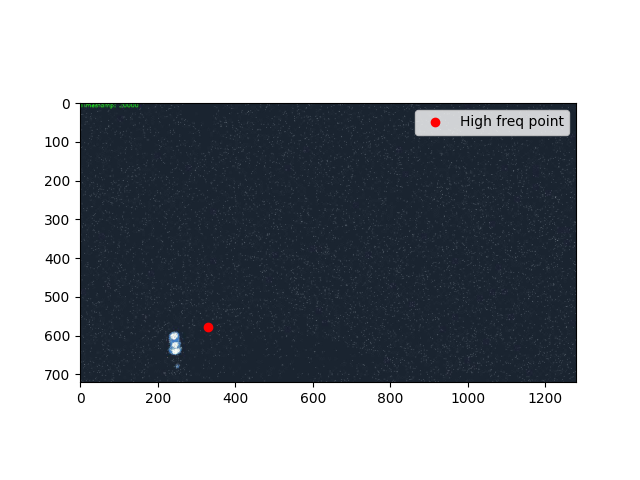

In [17]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/direct_test_240312_180831.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
df_pixel_1 = df_pixel[df_pixel['p']>0]
print(df_pixel_1.head())
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower()
power_db = 10 * np.log10(power)
print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/direct_test_240312_180831.png')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'direct_test_240312_180831.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# Laser 1k new

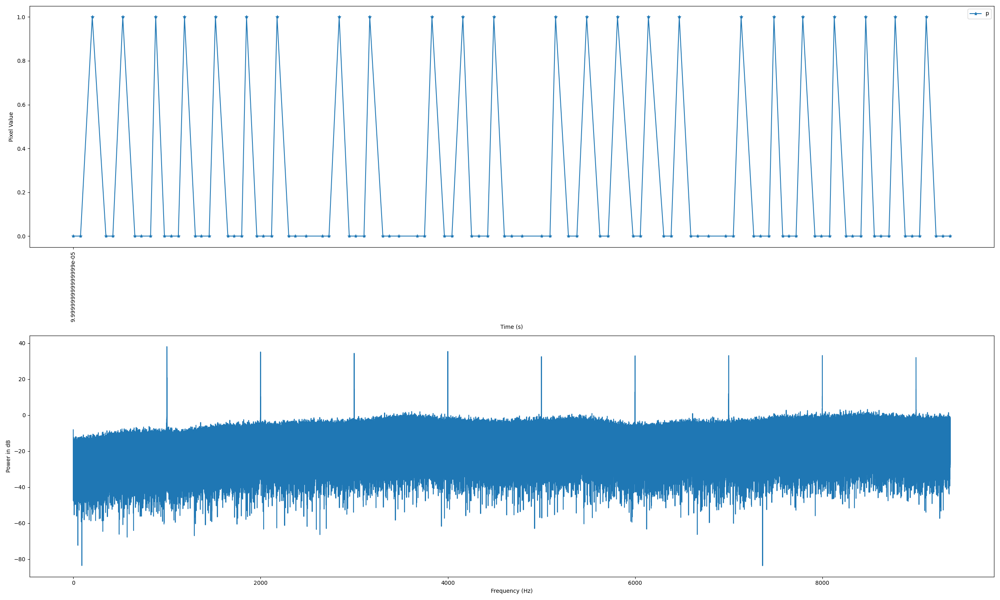

Frequency: 1000.0171393665124 Hz, Power: 38.08657253757651
Frequency: 4000.078541563047 Hz, Power: 35.421112762166814
Frequency: 2000.0376067653574 Hz, Power: 35.123404506634955
Frequency: 3000.058074164202 Hz, Power: 34.377868990637566
Frequency: 8000.1604111584265 Hz, Power: 33.147298359311776
Folder for selection: video_export\laser_1k_new_240313_143722


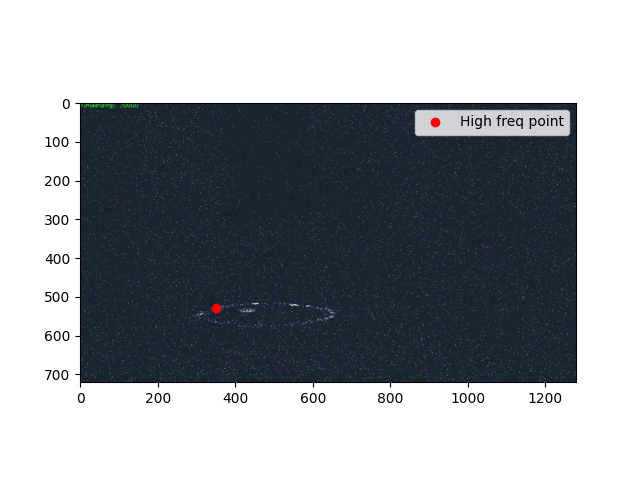

440.0 532.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\2197782975.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

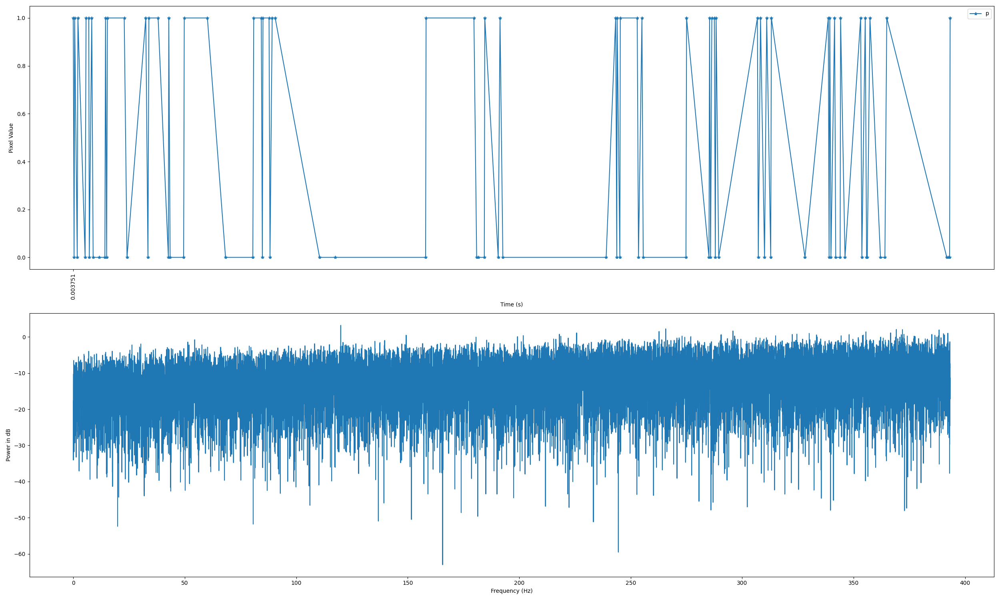

Frequency: 119.95955940332966 Hz, Power: 3.2168081888580007
Frequency: 265.7015812366556 Hz, Power: 2.254172627843167
Frequency: 369.11786575433854 Hz, Power: 2.0730384320756756
Frequency: 371.85564951838154 Hz, Power: 2.0340673844351924
Frequency: 388.2956746513697 Hz, Power: 1.9487793130971363
435.0 536.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\2197782975.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

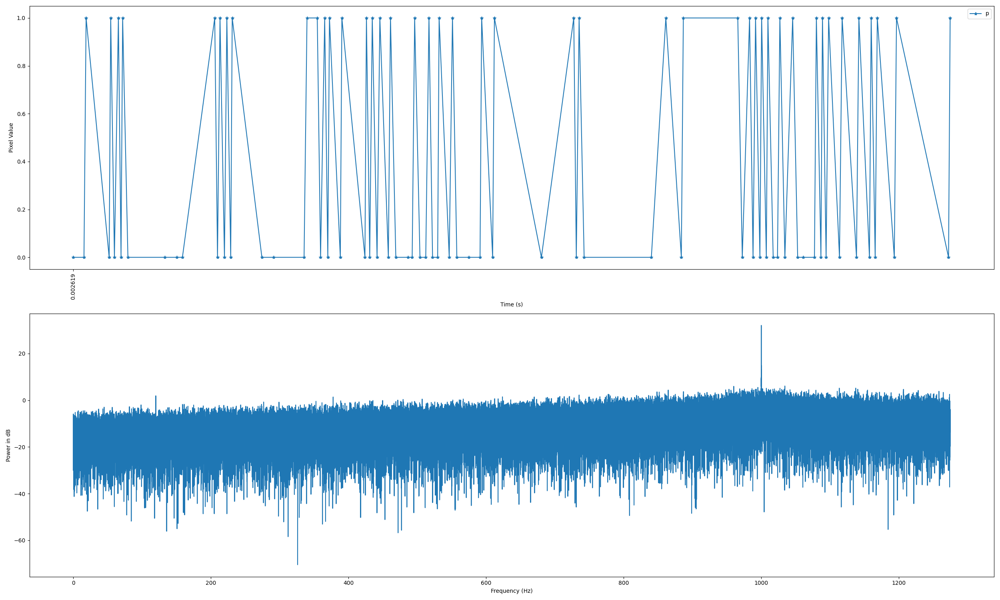

Frequency: 1000.0179455142888 Hz, Power: 32.07203745684027
Frequency: 1000.0645572397148 Hz, Power: 19.94970590054111
Frequency: 999.9713337888629 Hz, Power: 19.89349429099596
Frequency: 999.9380396992731 Hz, Power: 14.951736282165156
Frequency: 1000.1045101472228 Hz, Power: 14.370020599343498


In [ ]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_1k_new_240313_143722.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower()
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_1k_new_240313_143722.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_1k_new_240313_143722.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# Laser 1k new bias

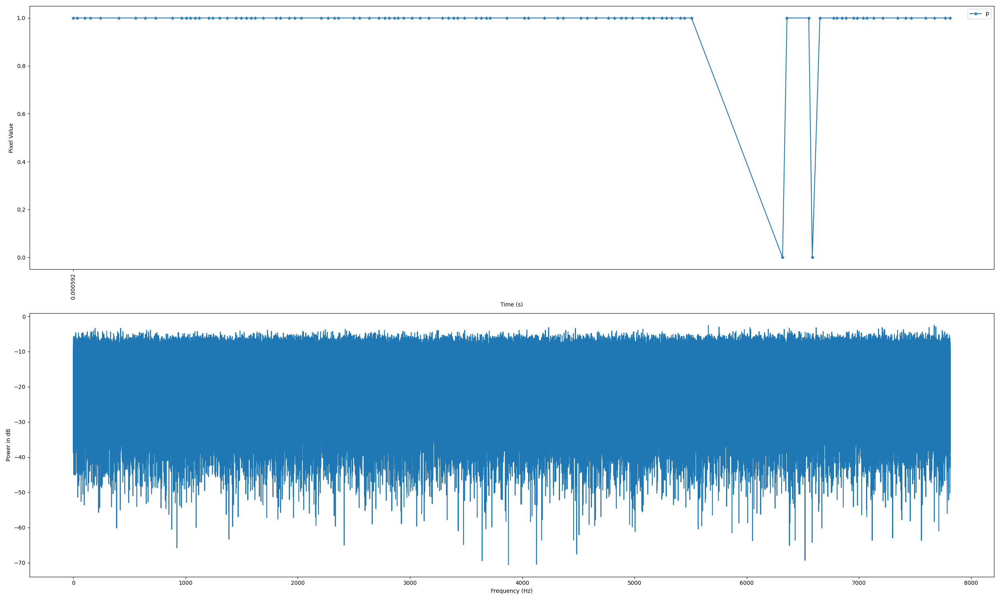

Frequency: 7670.420351793552 Hz, Power: -2.534333458084465
Frequency: 5658.400222474454 Hz, Power: -2.5446533029152816
Frequency: 7684.982219114775 Hz, Power: -2.9763107489868865
Frequency: 5753.411748012744 Hz, Power: -3.0223127070962312
Frequency: 7625.2040233747275 Hz, Power: -3.1240110480201655
Folder for selection: video_export\laser_1k_new_bias_240313_143943


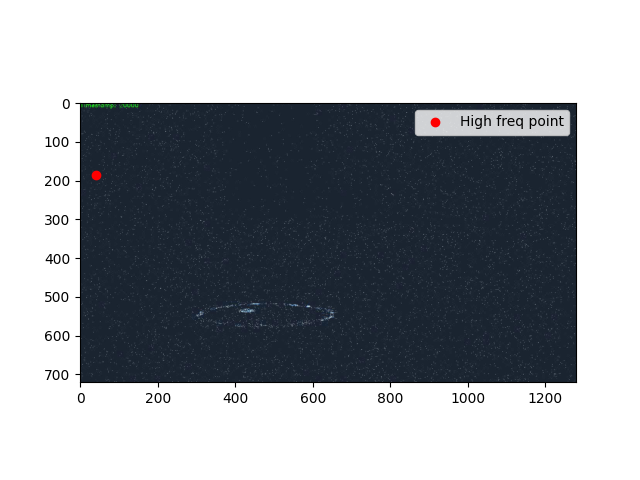

In [13]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_1k_new_bias_240313_143943.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower()
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_1k_new_bias_240313_143943.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_1k_new_bias_240313_143943.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# Laser 10k 

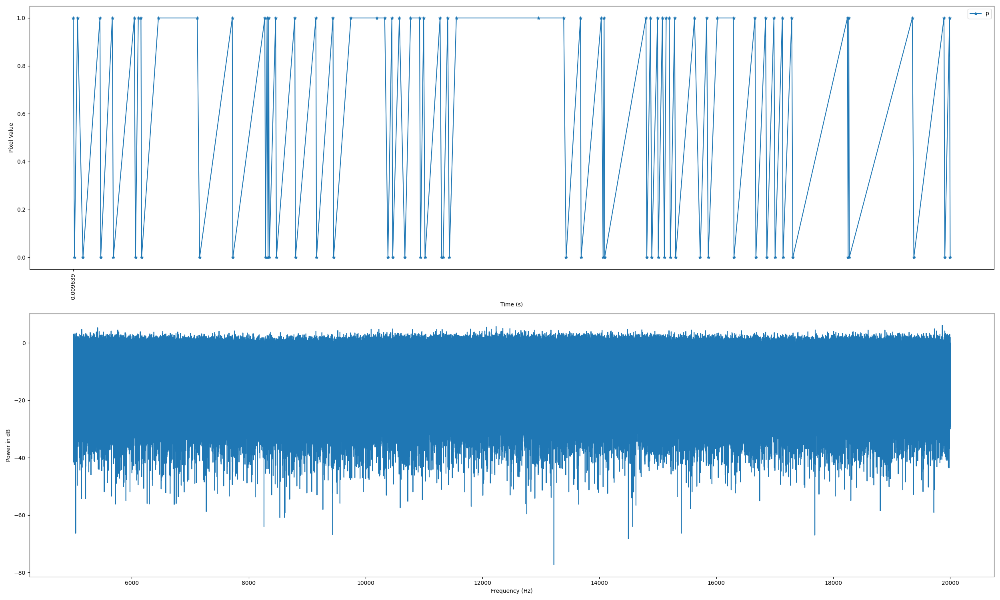

Frequency: 19865.512735431897 Hz, Power: 6.13350927996351
Frequency: 12232.884766728977 Hz, Power: 5.763164245052379
Frequency: 12071.412372833001 Hz, Power: 5.518457033081427
Frequency: 5417.624663528446 Hz, Power: 5.338240630797911
Frequency: 12348.24216278874 Hz, Power: 5.088242738966611
Folder for selection: video_export\laser_10k_new_240313_144158


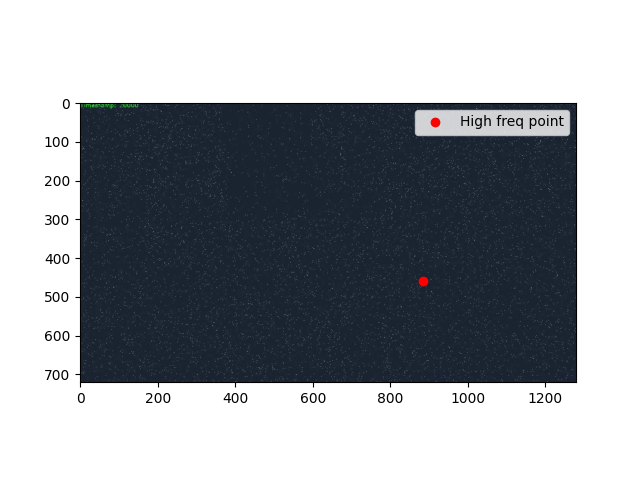

468.0 494.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\2197782975.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

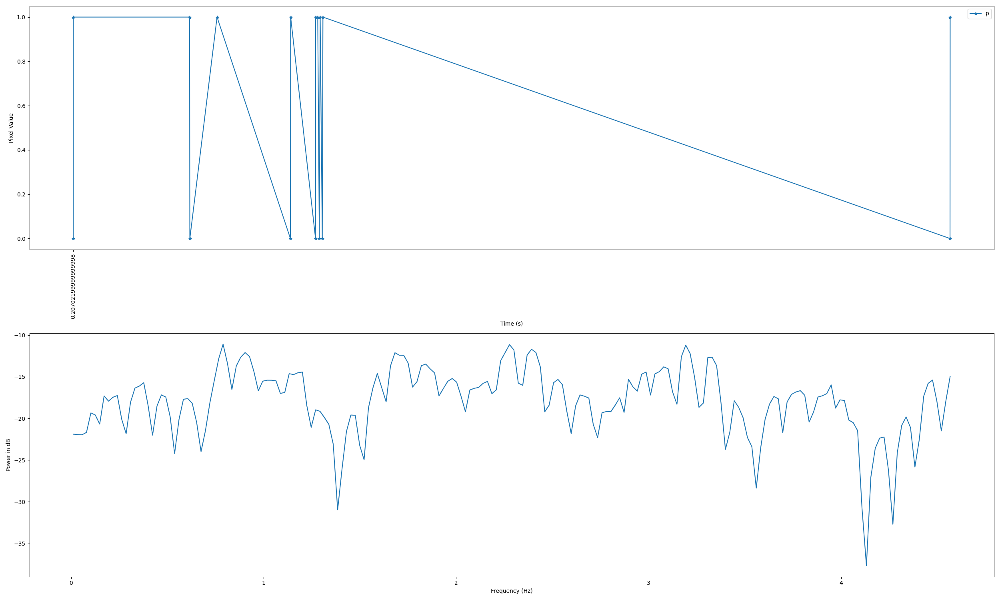

Frequency: 0.789590135204151 Hz, Power: -11.08287665906284
Frequency: 2.277223723269943 Hz, Power: -11.139076614412067
Frequency: 3.1926905466950455 Hz, Power: -11.197098687975162
Frequency: 2.3916570761980807 Hz, Power: -11.693632283219518
Frequency: 0.9040234881322888 Hz, Power: -12.090367592349969
419.0 533.0
Enter Bright or Noise? (B/N) (Enter to submit)


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\2197782975.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Text(value='')

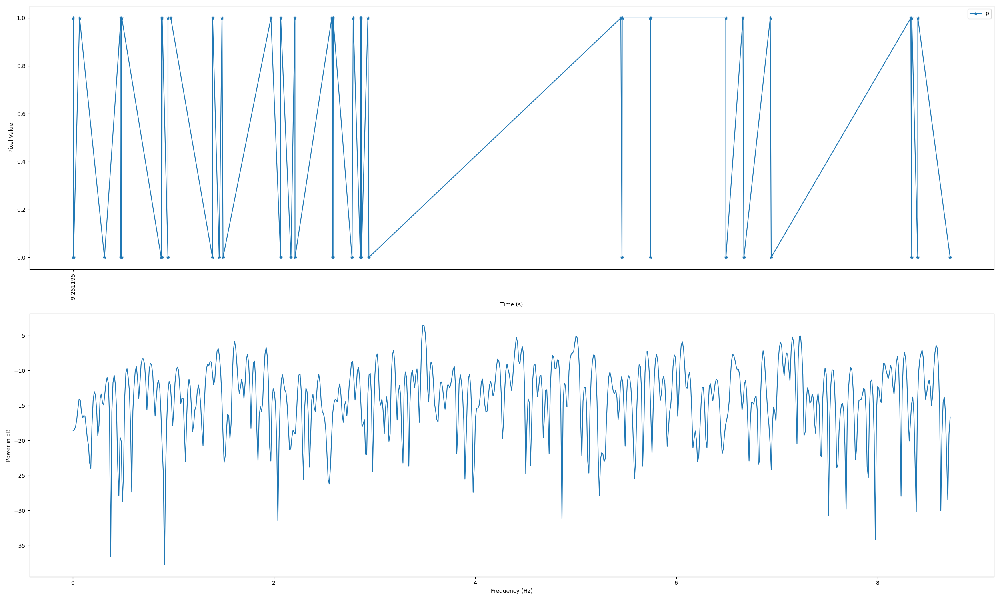

Frequency: 3.4919398359102027 Hz, Power: -3.5569480595346943
Frequency: 5.0025960045236015 Hz, Power: -5.037266701207218
Frequency: 7.233718961244929 Hz, Power: -5.062585305006246
Frequency: 7.15237593678113 Hz, Power: -5.23193190528848
Frequency: 4.409953969144499 Hz, Power: -5.269592663016645


In [ ]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_10k_new_240313_144158.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=5000, maximum_frequency=20000)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_10k_new_240313_144158.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_10k_new_240313_144158.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# Laser 10k bias

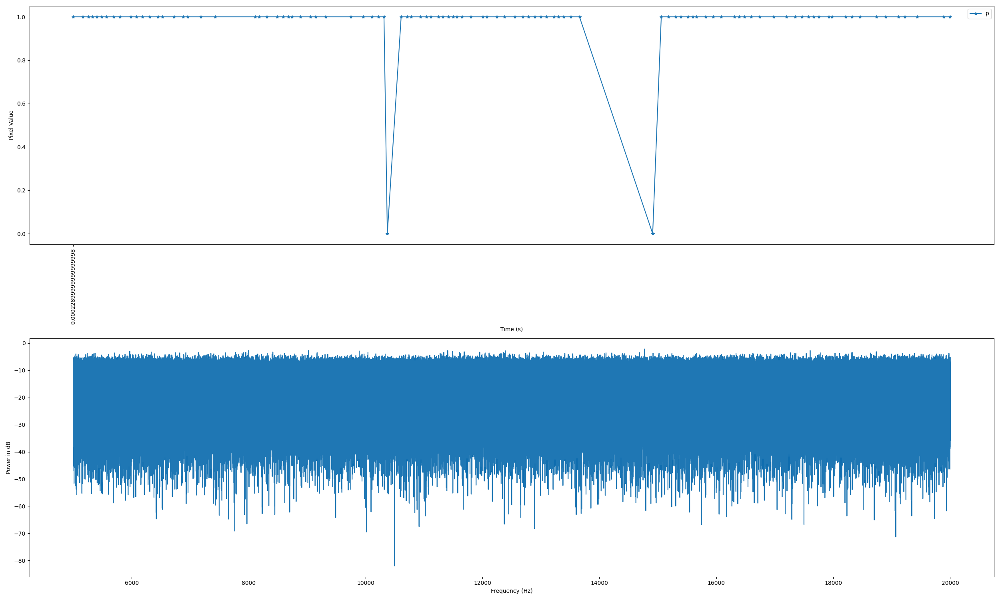

Frequency: 14771.871795249846 Hz, Power: -2.1515937838136683
Frequency: 7998.992984774557 Hz, Power: -2.6720679791267283
Frequency: 9023.807454774926 Hz, Power: -2.686193770421032
Frequency: 17604.880500937572 Hz, Power: -2.699032373903174
Frequency: 11405.205260602008 Hz, Power: -2.7285676757786796
Folder for selection: video_export\laser_10k_new_bias_240313_144336


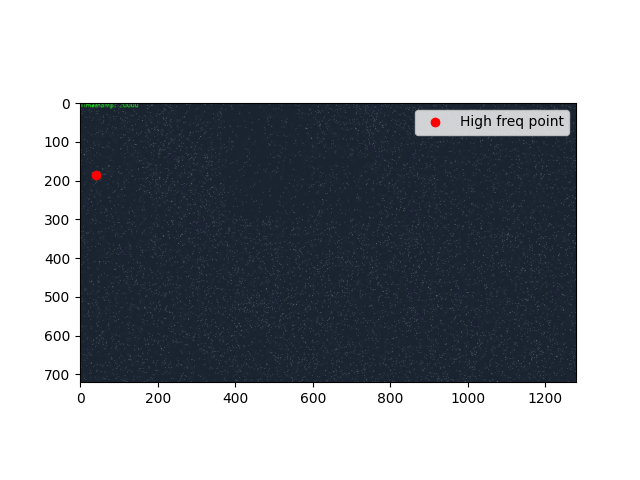

In [14]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_10k_new_bias_240313_144336.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=5000, maximum_frequency=20000)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_10k_new_bias_240313_144336.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_10k_new_bias_240313_144336.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# Laser 50k

In [ ]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/laser_10k_new_bias_240313_144336.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=5000, maximum_frequency=20000)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/laser_10k_new_bias_240313_144336.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'laser_10k_new_bias_240313_144336.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 20, 100)

# White Light Trail - 1Hz sanity check - note - high frequency pixel did not work well

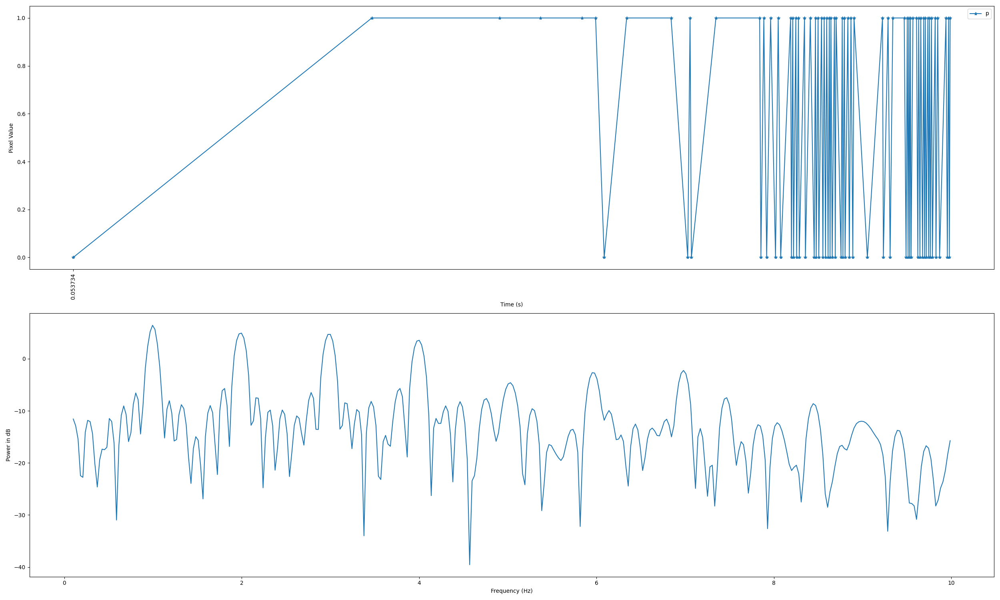

Frequency: 0.9940183265629507 Hz, Power: 6.423356654532727
Frequency: 1.9964025108911079 Hz, Power: 4.922838962170262
Frequency: 2.9987866952192648 Hz, Power: 4.680361135284686
Frequency: 4.001170879547422 Hz, Power: 3.5460133131028906
Frequency: 6.981231968090591 Hz, Power: -2.2515124228310617
Folder for selection: video_export\white_trail_240313_172457


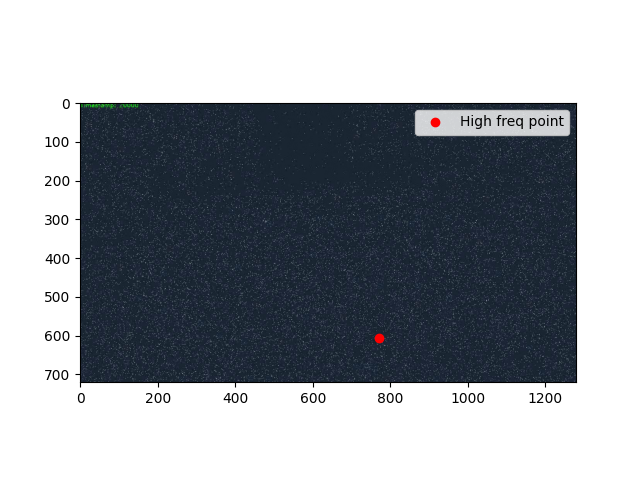

329.0 478.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\3627592202.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

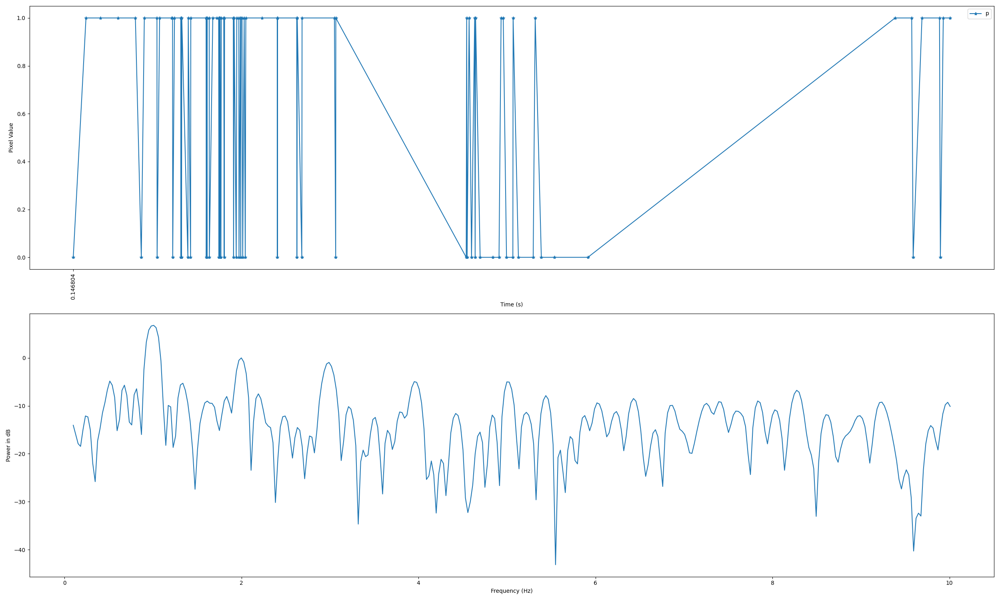

Frequency: 1.008211970068636 Hz, Power: 6.790917820260556
Frequency: 1.9989886646889665 Hz, Power: -4.906371751015497e-05
Frequency: 2.9897653593092968 Hz, Power: -0.9352619390486688
Frequency: 0.5128236227584709 Hz, Power: -4.834605785939535
Frequency: 3.953020479079062 Hz, Power: -4.94512408358171
627.0 650.0


C:\Users\alifb\AppData\Local\Temp\ipykernel_17308\3627592202.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['distance_to_median'] = np.sqrt((filtered_df['x'] - median_x)**2 + (filtered_df['y'] - median_y)**2)


Enter Bright or Noise? (B/N) (Enter to submit)


Text(value='')

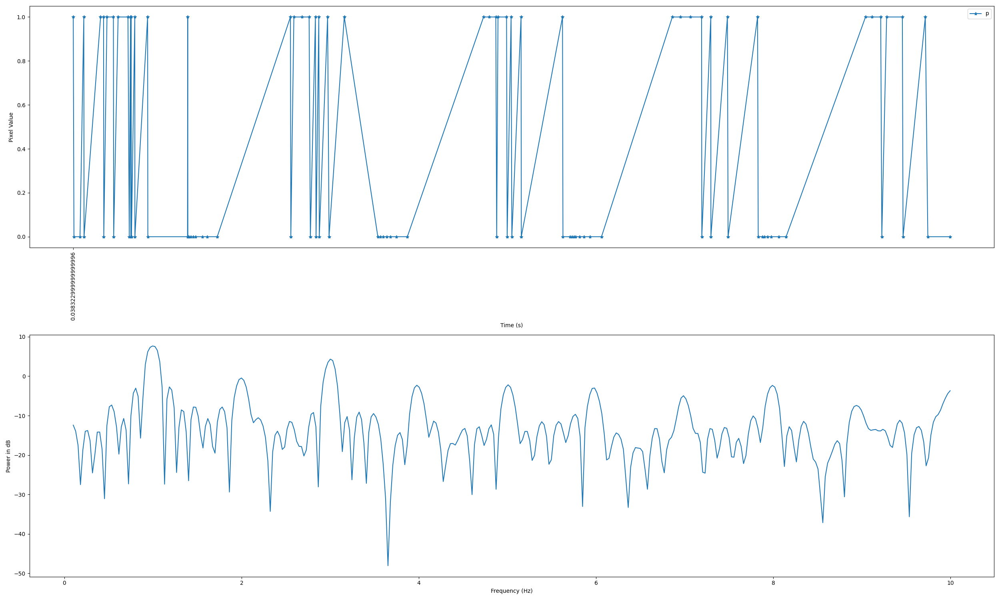

Frequency: 0.9948452439720986 Hz, Power: 7.659140597856541
Frequency: 3.0014679122731684 Hz, Power: 4.323571155639697
Frequency: 1.9981565781226336 Hz, Power: -0.460269991298887
Frequency: 5.008090580574238 Hz, Power: -2.191260489607391
Frequency: 3.977662723879094 Hz, Power: -2.300269923503116


In [ ]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/white_trail_240313_172457.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=0.1, maximum_frequency=10)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/white_trail_240313_172457.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'white_trail_240313_172457.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 0.1, 10)

# white light trail 100hz

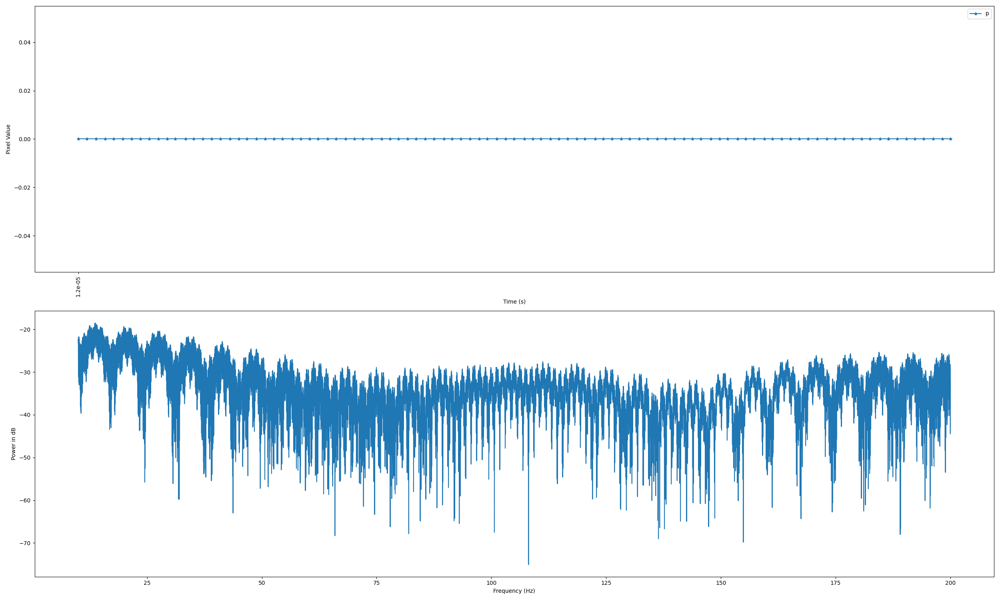

Frequency: 13.660816803441993 Hz, Power: -18.492277825122443
Frequency: 13.734033139510833 Hz, Power: -18.56328080752056
Frequency: 13.587600467373154 Hz, Power: -18.84721786986411
Frequency: 14.013586422682767 Hz, Power: -18.8912979125961
Frequency: 13.807249475579674 Hz, Power: -18.960881399084585
Folder for selection: video_export\white_trail_100_240313_174431


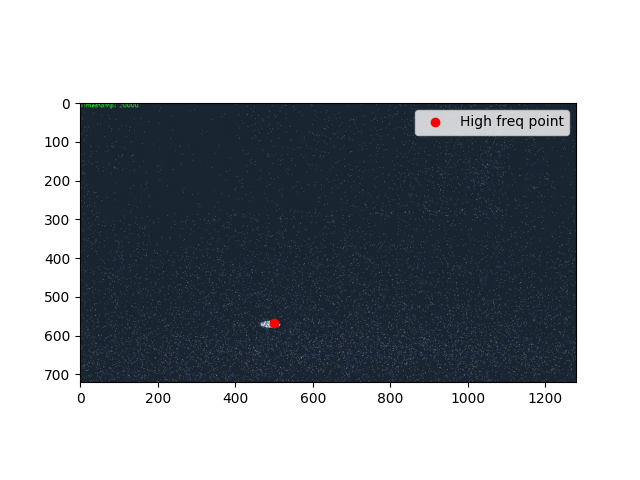

In [36]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/white_trail_100_240313_174431.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=10, maximum_frequency=200)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/white_trail_100_240313_174431.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = 'white_trail_100_240313_174431.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 10, 200)

# 10101010 - red light

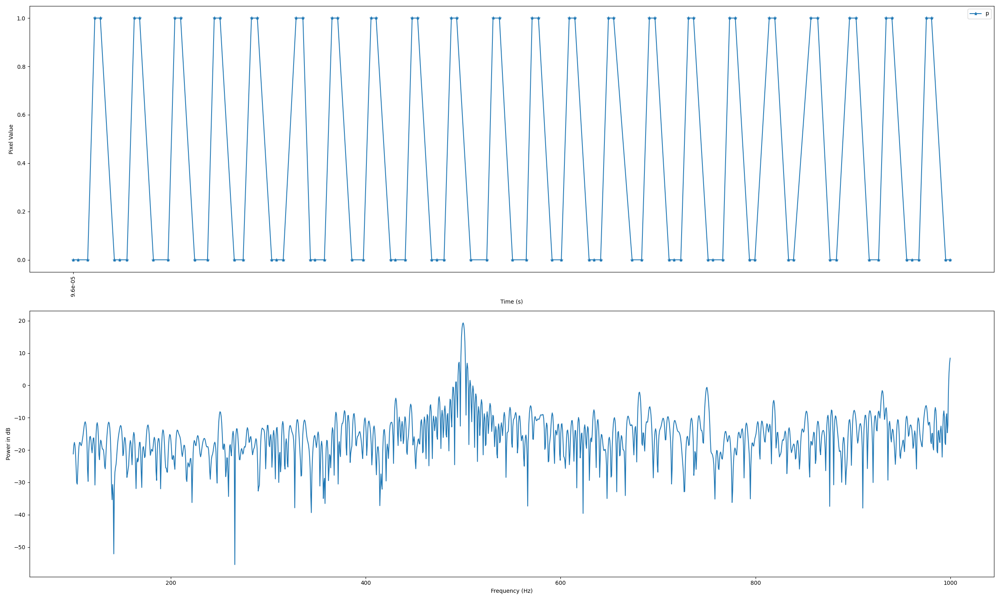

Frequency: 500.0738057093988 Hz, Power: 19.33375632849222
Frequency: 495.97348852057627 Hz, Power: 7.191517093223733
Frequency: 504.17412289822136 Hz, Power: 6.859871584401647
Frequency: 507.10292089023744 Hz, Power: 1.5798721618481395
Frequency: 493.0446905285602 Hz, Power: 1.0793497020621803
Folder for selection: video_export\10101010_240315_195125


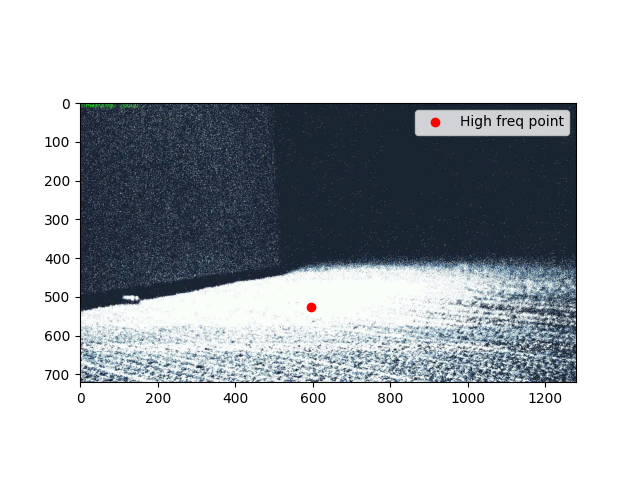

In [11]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/10101010_240315_195125.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=100, maximum_frequency=1000)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/10101010_240315_195125.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = '10101010_240315_195125.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 100, 1000)

# 11100 data

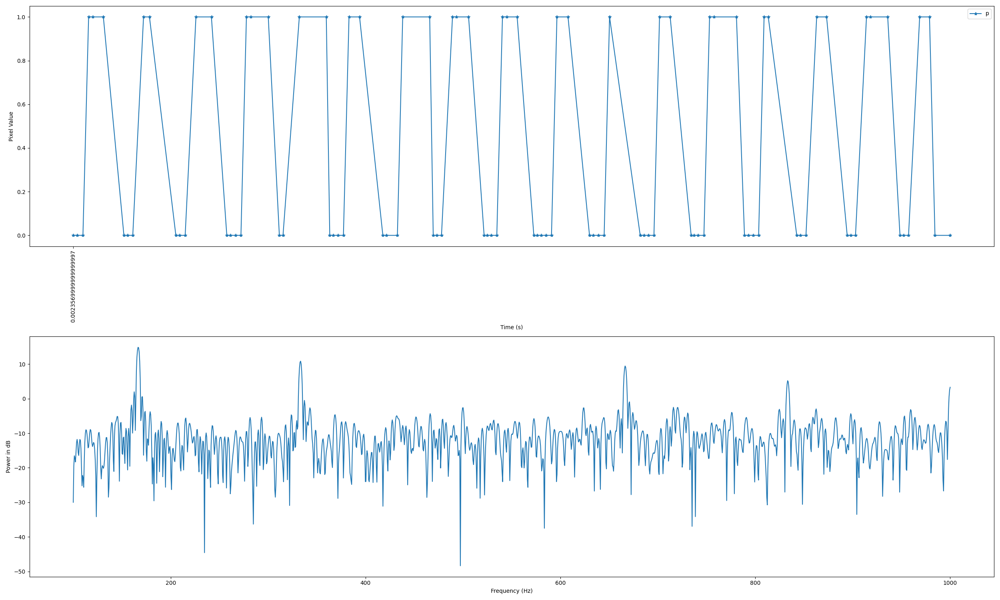

Frequency: 166.50866162591132 Hz, Power: 14.828125849318498
Frequency: 333.343948416333 Hz, Power: 10.82410454575413
Frequency: 666.4508892715329 Hz, Power: 9.421625314304666
Frequency: 833.2861760619546 Hz, Power: 5.1784861372328646
Frequency: 162.56323254640813 Hz, Power: 1.9730779149351716
Folder for selection: video_export\111100_240315_200145


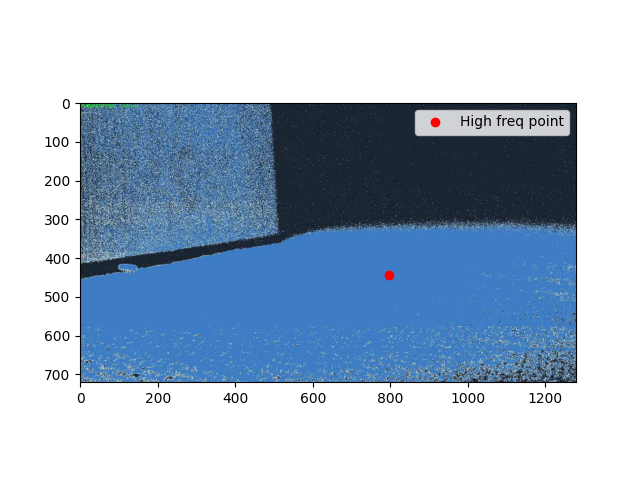

In [12]:
# import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns
plt.close('all')
chunksize = 100000000
df_chunked = pd.read_csv('csv_data/111100_240315_200145.csv', header=None, names=['x', 'y', 'p', 't'], chunksize=chunksize)
# get the first chunk to initialize the dataframe
df = df_chunked.get_chunk(chunksize)  
df['t'] = df['t'] - df['t'].min() # normalize the timestamps to zero
df['t'] = df['t']*1e-6 # convert timestamps from microseconds to seconds
most_common_pair = find_most_frequent_pairs(df)
# print(most_common_pair)
df_pixel = pixel_stats_most_common(df,0,most_common_pair)
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_pixel_value(ax1, df_pixel, 100, 100)
import matplotlib.pyplot as plt
from scipy.signal import lombscargle

# # Assuming you have loaded your timestamps (t) and signal values (signal) from the CSV
# # Normalize the timestamps to zero
# timestamps = timestamps - timestamps[0]

# # Convert timestamps from microseconds to seconds for the Lomb-Scargle periodogram
# t_seconds = timestamps * 1e-6

# Define the frequency array as you wish, for example:
#frequencies = np.linspace(200, 2000, 10000)  # frequencies from 0.01 Hz to 1000 Hz

# Calculate Lomb-Scargle periodogram (power spectral density)
# print('lomb scargle')
frequencies, power = LombScargle(df_pixel['t'], df_pixel['p'], normalization='psd').autopower(minimum_frequency=100, maximum_frequency=1000)
power_db = 10 * np.log10(power)
# print('lomb scargle done')
# Plot the Lomb-Scargle periodogram
ax2.plot(frequencies, power_db)
#plt.title('Lomb-Scargle Periodogram')
ax2.set_xlabel('Frequency (Hz)')
ax2.set_ylabel('Power in dB')
plt.tight_layout()
if not os.path.exists('figures'):
    os.makedirs('figures')
plt.savefig('figures/111100_240315_200145.jpg')
plt.show()
from scipy.signal import find_peaks

# Assuming 'frequencies' is the array of frequencies and 'power' is the power spectral density from Lomb-Scargle
peaks, _ = find_peaks(power_db)

# Get the peak frequencies and their corresponding power values
peak_frequencies = frequencies[peaks]
peak_powers = power_db[peaks]

# Sort the peaks by power in descending order
sorted_indices = np.argsort(peak_powers)[::-1]
sorted_peak_frequencies = peak_frequencies[sorted_indices]
sorted_peak_powers = peak_powers[sorted_indices]



# Print the 5 most powerful sorted peak frequencies and powers
for i in range(len(sorted_peak_frequencies[:5])):
    print(f"Frequency: {sorted_peak_frequencies[i]} Hz, Power: {sorted_peak_powers[i]}")
csv_file_name = '111100_240315_200145.csv'
video_export_folder = 'video_export'  # Update this path to your folder
select_random_frame_from_subfolder(csv_file_name, video_export_folder, df, (most_common_pair.iloc[0]['x'], most_common_pair.iloc[0]['y']), 100, 1000)